# Afriat

In [1]:
scan=0.1275

In [2]:
import warnings
import os
import sys
import gc
import warnings

In [3]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [4]:
torch.cuda.is_available()

False

In [5]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [6]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [7]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [8]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [9]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

# tardis.MyModel.setup_wandb(
#     wandb_configurations=tardis.config.wandb,
#     hyperparams=dict(
#         model_params=model_params,
#         train_params=train_params,
#         dataset_params=dataset_params,
#     )
# )

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_scan_{scan}"
)

vae.save(
    dir_path,
    overwrite=True,
)

/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
  rank_zero_warn(


GPU available: False, used: False


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
  rank_zero_warn(
/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


Training:   0%|          | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|          | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2572,3275,9396
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2572,2578,1671,3410,1655,3357
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4393,10850
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 633,834,2343
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 633,624,437,880,394,842
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1191,2619
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|          | 1/600 [00:14<2:24:24, 14.47s/it]

Epoch 1/600:   0%|          | 1/600 [00:14<2:24:24, 14.47s/it, v_num=1, total_loss_train=3.7e+3, kl_local_train=45.4]

Epoch 2/600:   0%|          | 1/600 [00:14<2:24:24, 14.47s/it, v_num=1, total_loss_train=3.7e+3, kl_local_train=45.4]

Epoch 2/600:   0%|          | 2/600 [00:26<2:12:28, 13.29s/it, v_num=1, total_loss_train=3.7e+3, kl_local_train=45.4]

Epoch 2/600:   0%|          | 2/600 [00:26<2:12:28, 13.29s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=61.3]

Epoch 3/600:   0%|          | 2/600 [00:26<2:12:28, 13.29s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=61.3]

Epoch 3/600:   0%|          | 3/600 [00:39<2:08:03, 12.87s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=61.3]

Epoch 3/600:   0%|          | 3/600 [00:39<2:08:03, 12.87s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=60.4]

Epoch 4/600:   0%|          | 3/600 [00:39<2:08:03, 12.87s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=60.4]

Epoch 4/600:   1%|          | 4/600 [00:51<2:05:39, 12.65s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=60.4]

Epoch 4/600:   1%|          | 4/600 [00:51<2:05:39, 12.65s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=56.8]

Epoch 5/600:   1%|          | 4/600 [00:51<2:05:39, 12.65s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=56.8]

Epoch 5/600:   1%|          | 5/600 [01:04<2:05:12, 12.63s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=56.8]

Epoch 5/600:   1%|          | 5/600 [01:04<2:05:12, 12.63s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=50.7]

Epoch 6/600:   1%|          | 5/600 [01:05<2:05:12, 12.63s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=50.7]

Epoch 6/600:   1%|          | 6/600 [01:17<2:07:04, 12.84s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=50.7]

Epoch 6/600:   1%|          | 6/600 [01:17<2:07:04, 12.84s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.0075, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|          | 6/600 [01:17<2:07:04, 12.84s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.0075, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|          | 7/600 [01:29<2:03:55, 12.54s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.0075, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|          | 7/600 [01:29<2:03:55, 12.54s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=31.4, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.0075, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|          | 7/600 [01:29<2:03:55, 12.54s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=31.4, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.0075, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|▏         | 8/600 [01:41<2:01:46, 12.34s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=31.4, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.0075, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|▏         | 8/600 [01:41<2:01:46, 12.34s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=23.3, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.0075, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0349]

Epoch 9/600:   1%|▏         | 8/600 [01:41<2:01:46, 12.34s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=23.3, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.0075, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0349]

Epoch 9/600:   2%|▏         | 9/600 [01:55<2:06:04, 12.80s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=23.3, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.0075, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0349]

Epoch 9/600:   2%|▏         | 9/600 [01:55<2:06:04, 12.80s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=22.2, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.0075, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0349]

Epoch 10/600:   2%|▏         | 9/600 [01:55<2:06:04, 12.80s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=22.2, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.0075, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0349]

Epoch 10/600:   2%|▏         | 10/600 [02:08<2:08:17, 13.05s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=22.2, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.0075, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0349]

Epoch 10/600:   2%|▏         | 10/600 [02:08<2:08:17, 13.05s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=26.9, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.0075, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0349]

Epoch 11/600:   2%|▏         | 10/600 [02:10<2:08:17, 13.05s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=26.9, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.0075, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0349]

Epoch 11/600:   2%|▏         | 11/600 [02:23<2:13:58, 13.65s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=26.9, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.0075, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0349]

Epoch 11/600:   2%|▏         | 11/600 [02:23<2:13:58, 13.65s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=33, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0627, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0517]    

Epoch 12/600:   2%|▏         | 11/600 [02:23<2:13:58, 13.65s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=33, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0627, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0517]

Epoch 12/600:   2%|▏         | 12/600 [02:36<2:11:52, 13.46s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=33, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0627, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0517]

Epoch 12/600:   2%|▏         | 12/600 [02:36<2:11:52, 13.46s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=38, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0627, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0517]

Epoch 13/600:   2%|▏         | 12/600 [02:36<2:11:52, 13.46s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=38, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0627, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0517]

Epoch 13/600:   2%|▏         | 13/600 [02:49<2:09:55, 13.28s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=38, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0627, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0517]

Epoch 13/600:   2%|▏         | 13/600 [02:49<2:09:55, 13.28s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0627, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0517]

Epoch 14/600:   2%|▏         | 13/600 [02:49<2:09:55, 13.28s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0627, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0517]

Epoch 14/600:   2%|▏         | 14/600 [03:02<2:08:29, 13.16s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0627, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0517]

Epoch 14/600:   2%|▏         | 14/600 [03:02<2:08:29, 13.16s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0627, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0517]

Epoch 15/600:   2%|▏         | 14/600 [03:02<2:08:29, 13.16s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0627, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0517]

Epoch 15/600:   2%|▎         | 15/600 [03:16<2:09:26, 13.28s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0627, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0517]

Epoch 15/600:   2%|▎         | 15/600 [03:16<2:09:26, 13.28s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=54.7, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0627, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0517]

Epoch 16/600:   2%|▎         | 15/600 [03:17<2:09:26, 13.28s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=54.7, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0627, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0517]

Epoch 16/600:   3%|▎         | 16/600 [03:30<2:12:46, 13.64s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=54.7, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.0627, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0517]

Epoch 16/600:   3%|▎         | 16/600 [03:30<2:12:46, 13.64s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=60.3, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0734]

Epoch 17/600:   3%|▎         | 16/600 [03:30<2:12:46, 13.64s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=60.3, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0734]

Epoch 17/600:   3%|▎         | 17/600 [03:43<2:11:16, 13.51s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=60.3, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0734]

Epoch 17/600:   3%|▎         | 17/600 [03:43<2:11:16, 13.51s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=67.3, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0734]

Epoch 18/600:   3%|▎         | 17/600 [03:43<2:11:16, 13.51s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=67.3, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0734]

Epoch 18/600:   3%|▎         | 18/600 [03:56<2:09:12, 13.32s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=67.3, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0734]

Epoch 18/600:   3%|▎         | 18/600 [03:56<2:09:12, 13.32s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=73.5, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0734]

Epoch 19/600:   3%|▎         | 18/600 [03:56<2:09:12, 13.32s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=73.5, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0734]

Epoch 19/600:   3%|▎         | 19/600 [04:09<2:07:42, 13.19s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=73.5, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0734]

Epoch 19/600:   3%|▎         | 19/600 [04:09<2:07:42, 13.19s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=78.5, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0734]

Epoch 20/600:   3%|▎         | 19/600 [04:09<2:07:42, 13.19s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=78.5, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0734]

Epoch 20/600:   3%|▎         | 20/600 [04:22<2:07:11, 13.16s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=78.5, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0734]

Epoch 20/600:   3%|▎         | 20/600 [04:22<2:07:11, 13.16s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=85.3, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0734]

Epoch 21/600:   3%|▎         | 20/600 [04:23<2:07:11, 13.16s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=85.3, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0734]

Epoch 21/600:   4%|▎         | 21/600 [04:38<2:13:41, 13.85s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=85.3, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0599, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0734]

Epoch 21/600:   4%|▎         | 21/600 [04:38<2:13:41, 13.85s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=89.1, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0648, metric_mi|time_cat_train=0.0834, metric_mi|mouse_train=0.096] 

Epoch 22/600:   4%|▎         | 21/600 [04:38<2:13:41, 13.85s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=89.1, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0648, metric_mi|time_cat_train=0.0834, metric_mi|mouse_train=0.096]

Epoch 22/600:   4%|▎         | 22/600 [04:52<2:13:49, 13.89s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=89.1, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0648, metric_mi|time_cat_train=0.0834, metric_mi|mouse_train=0.096]

Epoch 22/600:   4%|▎         | 22/600 [04:52<2:13:49, 13.89s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=92.4, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0648, metric_mi|time_cat_train=0.0834, metric_mi|mouse_train=0.096]

Epoch 23/600:   4%|▎         | 22/600 [04:52<2:13:49, 13.89s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=92.4, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0648, metric_mi|time_cat_train=0.0834, metric_mi|mouse_train=0.096]

Epoch 23/600:   4%|▍         | 23/600 [05:04<2:10:45, 13.60s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=92.4, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0648, metric_mi|time_cat_train=0.0834, metric_mi|mouse_train=0.096]

Epoch 23/600:   4%|▍         | 23/600 [05:04<2:10:45, 13.60s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=95.3, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0648, metric_mi|time_cat_train=0.0834, metric_mi|mouse_train=0.096]

Epoch 24/600:   4%|▍         | 23/600 [05:04<2:10:45, 13.60s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=95.3, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0648, metric_mi|time_cat_train=0.0834, metric_mi|mouse_train=0.096]

Epoch 24/600:   4%|▍         | 24/600 [05:17<2:08:35, 13.40s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=95.3, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0648, metric_mi|time_cat_train=0.0834, metric_mi|mouse_train=0.096]

Epoch 24/600:   4%|▍         | 24/600 [05:17<2:08:35, 13.40s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=97, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0648, metric_mi|time_cat_train=0.0834, metric_mi|mouse_train=0.096]  

Epoch 25/600:   4%|▍         | 24/600 [05:17<2:08:35, 13.40s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=97, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0648, metric_mi|time_cat_train=0.0834, metric_mi|mouse_train=0.096]

Epoch 25/600:   4%|▍         | 25/600 [05:31<2:07:50, 13.34s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=97, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0648, metric_mi|time_cat_train=0.0834, metric_mi|mouse_train=0.096]

Epoch 25/600:   4%|▍         | 25/600 [05:31<2:07:50, 13.34s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=101, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0648, metric_mi|time_cat_train=0.0834, metric_mi|mouse_train=0.096]

Epoch 26/600:   4%|▍         | 25/600 [05:32<2:07:50, 13.34s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=101, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0648, metric_mi|time_cat_train=0.0834, metric_mi|mouse_train=0.096]

Epoch 26/600:   4%|▍         | 26/600 [05:45<2:10:52, 13.68s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=101, metric_mi|status_control_train=0.0685, metric_mi|zone_train=0.0648, metric_mi|time_cat_train=0.0834, metric_mi|mouse_train=0.096]

Epoch 26/600:   4%|▍         | 26/600 [05:45<2:10:52, 13.68s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=102, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.0831, metric_mi|time_cat_train=0.0992, metric_mi|mouse_train=0.105]

Epoch 27/600:   4%|▍         | 26/600 [05:45<2:10:52, 13.68s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=102, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.0831, metric_mi|time_cat_train=0.0992, metric_mi|mouse_train=0.105]

Epoch 27/600:   4%|▍         | 27/600 [05:58<2:08:41, 13.47s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=102, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.0831, metric_mi|time_cat_train=0.0992, metric_mi|mouse_train=0.105]

Epoch 27/600:   4%|▍         | 27/600 [05:58<2:08:41, 13.47s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=103, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.0831, metric_mi|time_cat_train=0.0992, metric_mi|mouse_train=0.105]

Epoch 28/600:   4%|▍         | 27/600 [05:58<2:08:41, 13.47s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=103, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.0831, metric_mi|time_cat_train=0.0992, metric_mi|mouse_train=0.105]

Epoch 28/600:   5%|▍         | 28/600 [06:11<2:07:07, 13.33s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=103, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.0831, metric_mi|time_cat_train=0.0992, metric_mi|mouse_train=0.105]

Epoch 28/600:   5%|▍         | 28/600 [06:11<2:07:07, 13.33s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=105, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.0831, metric_mi|time_cat_train=0.0992, metric_mi|mouse_train=0.105]

Epoch 29/600:   5%|▍         | 28/600 [06:11<2:07:07, 13.33s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=105, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.0831, metric_mi|time_cat_train=0.0992, metric_mi|mouse_train=0.105]

Epoch 29/600:   5%|▍         | 29/600 [06:24<2:06:00, 13.24s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=105, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.0831, metric_mi|time_cat_train=0.0992, metric_mi|mouse_train=0.105]

Epoch 29/600:   5%|▍         | 29/600 [06:24<2:06:00, 13.24s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=107, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.0831, metric_mi|time_cat_train=0.0992, metric_mi|mouse_train=0.105]

Epoch 30/600:   5%|▍         | 29/600 [06:24<2:06:00, 13.24s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=107, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.0831, metric_mi|time_cat_train=0.0992, metric_mi|mouse_train=0.105]

Epoch 30/600:   5%|▌         | 30/600 [06:37<2:05:27, 13.21s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=107, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.0831, metric_mi|time_cat_train=0.0992, metric_mi|mouse_train=0.105]

Epoch 30/600:   5%|▌         | 30/600 [06:37<2:05:27, 13.21s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=107, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.0831, metric_mi|time_cat_train=0.0992, metric_mi|mouse_train=0.105]

Epoch 31/600:   5%|▌         | 30/600 [06:39<2:05:27, 13.21s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=107, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.0831, metric_mi|time_cat_train=0.0992, metric_mi|mouse_train=0.105]

Epoch 31/600:   5%|▌         | 31/600 [06:52<2:08:36, 13.56s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=107, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.0831, metric_mi|time_cat_train=0.0992, metric_mi|mouse_train=0.105]

Epoch 31/600:   5%|▌         | 31/600 [06:52<2:08:36, 13.56s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=108, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]    

Epoch 32/600:   5%|▌         | 31/600 [06:52<2:08:36, 13.56s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=108, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 32/600:   5%|▌         | 32/600 [07:05<2:06:43, 13.39s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=108, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 32/600:   5%|▌         | 32/600 [07:05<2:06:43, 13.39s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=108, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 33/600:   5%|▌         | 32/600 [07:05<2:06:43, 13.39s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=108, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 33/600:   6%|▌         | 33/600 [07:18<2:05:18, 13.26s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=108, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 33/600:   6%|▌         | 33/600 [07:18<2:05:18, 13.26s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=108, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 34/600:   6%|▌         | 33/600 [07:18<2:05:18, 13.26s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=108, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 34/600:   6%|▌         | 34/600 [07:31<2:04:24, 13.19s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=108, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 34/600:   6%|▌         | 34/600 [07:31<2:04:24, 13.19s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=108, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 35/600:   6%|▌         | 34/600 [07:31<2:04:24, 13.19s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=108, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 35/600:   6%|▌         | 35/600 [07:44<2:04:26, 13.22s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=108, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 35/600:   6%|▌         | 35/600 [07:44<2:04:26, 13.22s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=107, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 36/600:   6%|▌         | 35/600 [07:45<2:04:26, 13.22s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=107, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 36/600:   6%|▌         | 36/600 [07:58<2:07:31, 13.57s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=107, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 36/600:   6%|▌         | 36/600 [07:58<2:07:31, 13.57s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=106, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 37/600:   6%|▌         | 36/600 [07:58<2:07:31, 13.57s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=106, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 37/600:   6%|▌         | 37/600 [08:11<2:05:38, 13.39s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=106, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 37/600:   6%|▌         | 37/600 [08:11<2:05:38, 13.39s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=106, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 38/600:   6%|▌         | 37/600 [08:11<2:05:38, 13.39s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=106, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 38/600:   6%|▋         | 38/600 [08:24<2:04:14, 13.26s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=106, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 38/600:   6%|▋         | 38/600 [08:24<2:04:14, 13.26s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=105, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 39/600:   6%|▋         | 38/600 [08:24<2:04:14, 13.26s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=105, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 39/600:   6%|▋         | 39/600 [08:37<2:03:12, 13.18s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=105, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 39/600:   6%|▋         | 39/600 [08:37<2:03:12, 13.18s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=105, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 40/600:   6%|▋         | 39/600 [08:37<2:03:12, 13.18s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=105, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 40/600:   7%|▋         | 40/600 [08:50<2:02:22, 13.11s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=105, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 40/600:   7%|▋         | 40/600 [08:50<2:02:22, 13.11s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=105, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 41/600:   7%|▋         | 40/600 [08:51<2:02:22, 13.11s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=105, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 41/600:   7%|▋         | 41/600 [09:04<2:05:45, 13.50s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=105, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.114]

Epoch 41/600:   7%|▋         | 41/600 [09:04<2:05:45, 13.50s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.117]

Epoch 42/600:   7%|▋         | 41/600 [09:05<2:05:45, 13.50s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.117]

Epoch 42/600:   7%|▋         | 42/600 [09:17<2:04:08, 13.35s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.117]

Epoch 42/600:   7%|▋         | 42/600 [09:17<2:04:08, 13.35s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.117]

Epoch 43/600:   7%|▋         | 42/600 [09:18<2:04:08, 13.35s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.117]

Epoch 43/600:   7%|▋         | 43/600 [09:30<2:02:47, 13.23s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.117]

Epoch 43/600:   7%|▋         | 43/600 [09:30<2:02:47, 13.23s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.117]

Epoch 44/600:   7%|▋         | 43/600 [09:30<2:02:47, 13.23s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.117]

Epoch 44/600:   7%|▋         | 44/600 [09:43<2:01:47, 13.14s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.117]

Epoch 44/600:   7%|▋         | 44/600 [09:43<2:01:47, 13.14s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.117]

Epoch 45/600:   7%|▋         | 44/600 [09:43<2:01:47, 13.14s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.117]

Epoch 45/600:   8%|▊         | 45/600 [09:57<2:02:01, 13.19s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.117]

Epoch 45/600:   8%|▊         | 45/600 [09:57<2:02:01, 13.19s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.117]

Epoch 46/600:   8%|▊         | 45/600 [09:58<2:02:01, 13.19s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.117]

Epoch 46/600:   8%|▊         | 46/600 [10:11<2:05:10, 13.56s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.117]

Epoch 46/600:   8%|▊         | 46/600 [10:11<2:05:10, 13.56s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=103, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 47/600:   8%|▊         | 46/600 [10:11<2:05:10, 13.56s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=103, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 47/600:   8%|▊         | 47/600 [10:24<2:03:01, 13.35s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=103, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 47/600:   8%|▊         | 47/600 [10:24<2:03:01, 13.35s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=104, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 48/600:   8%|▊         | 47/600 [10:24<2:03:01, 13.35s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=104, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 48/600:   8%|▊         | 48/600 [10:37<2:01:27, 13.20s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=104, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 48/600:   8%|▊         | 48/600 [10:37<2:01:27, 13.20s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=104, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 49/600:   8%|▊         | 48/600 [10:37<2:01:27, 13.20s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=104, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 49/600:   8%|▊         | 49/600 [10:50<2:00:16, 13.10s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=104, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 49/600:   8%|▊         | 49/600 [10:50<2:00:16, 13.10s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=104, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 50/600:   8%|▊         | 49/600 [10:50<2:00:16, 13.10s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=104, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 50/600:   8%|▊         | 50/600 [11:02<1:59:08, 13.00s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=104, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 50/600:   8%|▊         | 50/600 [11:02<1:59:08, 13.00s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=103, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 51/600:   8%|▊         | 50/600 [11:04<1:59:08, 13.00s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=103, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 51/600:   8%|▊         | 51/600 [11:16<2:00:09, 13.13s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=103, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.117]

Epoch 51/600:   8%|▊         | 51/600 [11:16<2:00:09, 13.13s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=102, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.119]

Epoch 52/600:   8%|▊         | 51/600 [11:16<2:00:09, 13.13s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=102, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.119]

Epoch 52/600:   9%|▊         | 52/600 [11:27<1:55:43, 12.67s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=102, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.119]

Epoch 52/600:   9%|▊         | 52/600 [11:27<1:55:43, 12.67s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=102, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.119]

Epoch 53/600:   9%|▊         | 52/600 [11:27<1:55:43, 12.67s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=102, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.119]

Epoch 53/600:   9%|▉         | 53/600 [11:39<1:52:15, 12.31s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=102, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.119]

Epoch 53/600:   9%|▉         | 53/600 [11:39<1:52:15, 12.31s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=101, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.119]

Epoch 54/600:   9%|▉         | 53/600 [11:39<1:52:15, 12.31s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=101, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.119]

Epoch 54/600:   9%|▉         | 54/600 [11:52<1:53:00, 12.42s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=101, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.119]

Epoch 54/600:   9%|▉         | 54/600 [11:52<1:53:00, 12.42s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=101, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.119]

Epoch 55/600:   9%|▉         | 54/600 [11:52<1:53:00, 12.42s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=101, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.119]

Epoch 55/600:   9%|▉         | 55/600 [12:05<1:54:21, 12.59s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=101, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.119]

Epoch 55/600:   9%|▉         | 55/600 [12:05<1:54:21, 12.59s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=99, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.119] 

Epoch 56/600:   9%|▉         | 55/600 [12:06<1:54:21, 12.59s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=99, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.119]

Epoch 56/600:   9%|▉         | 56/600 [12:19<1:59:02, 13.13s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=99, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.119]

Epoch 56/600:   9%|▉         | 56/600 [12:19<1:59:02, 13.13s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=99, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119] 

Epoch 57/600:   9%|▉         | 56/600 [12:19<1:59:02, 13.13s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=99, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 57/600:  10%|▉         | 57/600 [12:32<1:59:11, 13.17s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=99, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 57/600:  10%|▉         | 57/600 [12:32<1:59:11, 13.17s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=97.9, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 58/600:  10%|▉         | 57/600 [12:32<1:59:11, 13.17s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=97.9, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 58/600:  10%|▉         | 58/600 [12:45<1:58:37, 13.13s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=97.9, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 58/600:  10%|▉         | 58/600 [12:45<1:58:37, 13.13s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=97.5, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 59/600:  10%|▉         | 58/600 [12:45<1:58:37, 13.13s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=97.5, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 59/600:  10%|▉         | 59/600 [12:58<1:58:27, 13.14s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=97.5, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 59/600:  10%|▉         | 59/600 [12:58<1:58:27, 13.14s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=96.6, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 60/600:  10%|▉         | 59/600 [12:58<1:58:27, 13.14s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=96.6, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 60/600:  10%|█         | 60/600 [13:11<1:57:36, 13.07s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=96.6, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 60/600:  10%|█         | 60/600 [13:11<1:57:36, 13.07s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=95.2, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 61/600:  10%|█         | 60/600 [13:13<1:57:36, 13.07s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=95.2, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 61/600:  10%|█         | 61/600 [13:26<2:00:38, 13.43s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=95.2, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 61/600:  10%|█         | 61/600 [13:26<2:00:38, 13.43s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=95.2, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12] 

Epoch 62/600:  10%|█         | 61/600 [13:26<2:00:38, 13.43s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=95.2, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 62/600:  10%|█         | 62/600 [13:39<1:59:10, 13.29s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=95.2, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 62/600:  10%|█         | 62/600 [13:39<1:59:10, 13.29s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=93.6, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 63/600:  10%|█         | 62/600 [13:39<1:59:10, 13.29s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=93.6, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 63/600:  10%|█         | 63/600 [13:52<1:57:56, 13.18s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=93.6, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 63/600:  10%|█         | 63/600 [13:52<1:57:56, 13.18s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=94.1, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 64/600:  10%|█         | 63/600 [13:52<1:57:56, 13.18s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=94.1, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 64/600:  11%|█         | 64/600 [14:04<1:56:55, 13.09s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=94.1, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 64/600:  11%|█         | 64/600 [14:04<1:56:55, 13.09s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=91.9, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 65/600:  11%|█         | 64/600 [14:04<1:56:55, 13.09s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=91.9, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 65/600:  11%|█         | 65/600 [14:17<1:56:18, 13.04s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=91.9, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 65/600:  11%|█         | 65/600 [14:17<1:56:18, 13.04s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=91.6, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 66/600:  11%|█         | 65/600 [14:19<1:56:18, 13.04s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=91.6, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 66/600:  11%|█         | 66/600 [14:32<1:59:36, 13.44s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=91.6, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.12]

Epoch 66/600:  11%|█         | 66/600 [14:32<1:59:36, 13.44s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=91.7, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 67/600:  11%|█         | 66/600 [14:32<1:59:36, 13.44s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=91.7, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 67/600:  11%|█         | 67/600 [14:45<1:58:03, 13.29s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=91.7, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 67/600:  11%|█         | 67/600 [14:45<1:58:03, 13.29s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=89.6, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 68/600:  11%|█         | 67/600 [14:45<1:58:03, 13.29s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=89.6, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 68/600:  11%|█▏        | 68/600 [14:58<1:57:21, 13.24s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=89.6, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 68/600:  11%|█▏        | 68/600 [14:58<1:57:21, 13.24s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=89.5, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 69/600:  11%|█▏        | 68/600 [14:58<1:57:21, 13.24s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=89.5, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 69/600:  12%|█▏        | 69/600 [15:11<1:56:35, 13.17s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=89.5, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 69/600:  12%|█▏        | 69/600 [15:11<1:56:35, 13.17s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=88, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]  

Epoch 70/600:  12%|█▏        | 69/600 [15:11<1:56:35, 13.17s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=88, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 70/600:  12%|█▏        | 70/600 [15:24<1:57:47, 13.33s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=88, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 70/600:  12%|█▏        | 70/600 [15:24<1:57:47, 13.33s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=88.3, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 71/600:  12%|█▏        | 70/600 [15:26<1:57:47, 13.33s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=88.3, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 71/600:  12%|█▏        | 71/600 [15:39<2:00:21, 13.65s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=88.3, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.119]

Epoch 71/600:  12%|█▏        | 71/600 [15:39<2:00:21, 13.65s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=87.1, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119] 

Epoch 72/600:  12%|█▏        | 71/600 [15:39<2:00:21, 13.65s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=87.1, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 72/600:  12%|█▏        | 72/600 [15:52<1:58:20, 13.45s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=87.1, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 72/600:  12%|█▏        | 72/600 [15:52<1:58:20, 13.45s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=86.7, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 73/600:  12%|█▏        | 72/600 [15:52<1:58:20, 13.45s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=86.7, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 73/600:  12%|█▏        | 73/600 [16:05<1:57:00, 13.32s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=86.7, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 73/600:  12%|█▏        | 73/600 [16:05<1:57:00, 13.32s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=85.9, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 74/600:  12%|█▏        | 73/600 [16:05<1:57:00, 13.32s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=85.9, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 74/600:  12%|█▏        | 74/600 [16:18<1:55:51, 13.22s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=85.9, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 74/600:  12%|█▏        | 74/600 [16:18<1:55:51, 13.22s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=86, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]  

Epoch 75/600:  12%|█▏        | 74/600 [16:18<1:55:51, 13.22s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=86, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 75/600:  12%|█▎        | 75/600 [16:31<1:54:57, 13.14s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=86, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 75/600:  12%|█▎        | 75/600 [16:31<1:54:57, 13.14s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=84.8, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 76/600:  12%|█▎        | 75/600 [16:32<1:54:57, 13.14s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=84.8, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 76/600:  13%|█▎        | 76/600 [16:45<1:58:03, 13.52s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=84.8, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.14, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.119]

Epoch 76/600:  13%|█▎        | 76/600 [16:45<1:58:03, 13.52s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=83.6, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 77/600:  13%|█▎        | 76/600 [16:45<1:58:03, 13.52s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=83.6, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 77/600:  13%|█▎        | 77/600 [16:58<1:56:19, 13.34s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=83.6, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 77/600:  13%|█▎        | 77/600 [16:58<1:56:19, 13.34s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=83.3, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 78/600:  13%|█▎        | 77/600 [16:58<1:56:19, 13.34s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=83.3, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 78/600:  13%|█▎        | 78/600 [17:11<1:55:02, 13.22s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=83.3, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 78/600:  13%|█▎        | 78/600 [17:11<1:55:02, 13.22s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=82.5, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 79/600:  13%|█▎        | 78/600 [17:11<1:55:02, 13.22s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=82.5, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 79/600:  13%|█▎        | 79/600 [17:24<1:54:02, 13.13s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=82.5, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 79/600:  13%|█▎        | 79/600 [17:24<1:54:02, 13.13s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=82, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]  

Epoch 80/600:  13%|█▎        | 79/600 [17:24<1:54:02, 13.13s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=82, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 80/600:  13%|█▎        | 80/600 [17:37<1:53:47, 13.13s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=82, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 80/600:  13%|█▎        | 80/600 [17:37<1:53:47, 13.13s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=81.5, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 81/600:  13%|█▎        | 80/600 [17:39<1:53:47, 13.13s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=81.5, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 81/600:  14%|█▎        | 81/600 [17:51<1:56:43, 13.49s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=81.5, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.12]

Epoch 81/600:  14%|█▎        | 81/600 [17:51<1:56:43, 13.49s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=81.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 82/600:  14%|█▎        | 81/600 [17:51<1:56:43, 13.49s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=81.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 82/600:  14%|█▎        | 82/600 [18:04<1:55:04, 13.33s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=81.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 82/600:  14%|█▎        | 82/600 [18:04<1:55:04, 13.33s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=81, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]  

Epoch 83/600:  14%|█▎        | 82/600 [18:04<1:55:04, 13.33s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=81, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 83/600:  14%|█▍        | 83/600 [18:17<1:53:49, 13.21s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=81, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 83/600:  14%|█▍        | 83/600 [18:17<1:53:49, 13.21s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=80.3, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 84/600:  14%|█▍        | 83/600 [18:17<1:53:49, 13.21s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=80.3, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 84/600:  14%|█▍        | 84/600 [18:30<1:52:56, 13.13s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=80.3, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 84/600:  14%|█▍        | 84/600 [18:30<1:52:56, 13.13s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=79.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 85/600:  14%|█▍        | 84/600 [18:30<1:52:56, 13.13s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=79.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 85/600:  14%|█▍        | 85/600 [18:44<1:53:25, 13.21s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=79.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 85/600:  14%|█▍        | 85/600 [18:44<1:53:25, 13.21s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=79.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 86/600:  14%|█▍        | 85/600 [18:45<1:53:25, 13.21s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=79.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 86/600:  14%|█▍        | 86/600 [18:58<1:56:17, 13.57s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=79.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.116]

Epoch 86/600:  14%|█▍        | 86/600 [18:58<1:56:17, 13.57s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=79.2, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 87/600:  14%|█▍        | 86/600 [18:58<1:56:17, 13.57s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=79.2, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 87/600:  14%|█▍        | 87/600 [19:11<1:54:27, 13.39s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=79.2, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 87/600:  14%|█▍        | 87/600 [19:11<1:54:27, 13.39s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=78.3, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 88/600:  14%|█▍        | 87/600 [19:11<1:54:27, 13.39s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=78.3, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 88/600:  15%|█▍        | 88/600 [19:24<1:53:13, 13.27s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=78.3, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 88/600:  15%|█▍        | 88/600 [19:24<1:53:13, 13.27s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=78, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]  

Epoch 89/600:  15%|█▍        | 88/600 [19:24<1:53:13, 13.27s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=78, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 89/600:  15%|█▍        | 89/600 [19:37<1:52:15, 13.18s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=78, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 89/600:  15%|█▍        | 89/600 [19:37<1:52:15, 13.18s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=77.6, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 90/600:  15%|█▍        | 89/600 [19:37<1:52:15, 13.18s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=77.6, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 90/600:  15%|█▌        | 90/600 [19:51<1:52:53, 13.28s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=77.6, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 90/600:  15%|█▌        | 90/600 [19:51<1:52:53, 13.28s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=77.4, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 91/600:  15%|█▌        | 90/600 [19:52<1:52:53, 13.28s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=77.4, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 91/600:  15%|█▌        | 91/600 [20:05<1:55:58, 13.67s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=77.4, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 91/600:  15%|█▌        | 91/600 [20:05<1:55:58, 13.67s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=77.5, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 92/600:  15%|█▌        | 91/600 [20:05<1:55:58, 13.67s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=77.5, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 92/600:  15%|█▌        | 92/600 [20:19<1:55:44, 13.67s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=77.5, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 92/600:  15%|█▌        | 92/600 [20:19<1:55:44, 13.67s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=76.4, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 93/600:  15%|█▌        | 92/600 [20:19<1:55:44, 13.67s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=76.4, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 93/600:  16%|█▌        | 93/600 [20:32<1:54:07, 13.51s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=76.4, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 93/600:  16%|█▌        | 93/600 [20:32<1:54:07, 13.51s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=76, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]  

Epoch 94/600:  16%|█▌        | 93/600 [20:32<1:54:07, 13.51s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=76, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 94/600:  16%|█▌        | 94/600 [20:45<1:52:43, 13.37s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=76, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 94/600:  16%|█▌        | 94/600 [20:45<1:52:43, 13.37s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=75.4, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 95/600:  16%|█▌        | 94/600 [20:45<1:52:43, 13.37s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=75.4, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 95/600:  16%|█▌        | 95/600 [20:58<1:51:59, 13.31s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=75.4, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 95/600:  16%|█▌        | 95/600 [20:58<1:51:59, 13.31s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=75.5, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 96/600:  16%|█▌        | 95/600 [21:00<1:51:59, 13.31s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=75.5, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 96/600:  16%|█▌        | 96/600 [21:13<1:54:46, 13.66s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=75.5, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 96/600:  16%|█▌        | 96/600 [21:13<1:54:46, 13.66s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=74.9, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114] 

Epoch 97/600:  16%|█▌        | 96/600 [21:13<1:54:46, 13.66s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=74.9, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 97/600:  16%|█▌        | 97/600 [21:26<1:52:59, 13.48s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=74.9, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 97/600:  16%|█▌        | 97/600 [21:26<1:52:59, 13.48s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=74.4, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 98/600:  16%|█▌        | 97/600 [21:26<1:52:59, 13.48s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=74.4, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 98/600:  16%|█▋        | 98/600 [21:39<1:52:17, 13.42s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=74.4, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 98/600:  16%|█▋        | 98/600 [21:39<1:52:17, 13.42s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=74.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 99/600:  16%|█▋        | 98/600 [21:39<1:52:17, 13.42s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=74.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 99/600:  16%|█▋        | 99/600 [21:52<1:51:42, 13.38s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=74.3, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 99/600:  16%|█▋        | 99/600 [21:52<1:51:42, 13.38s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=73.6, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 100/600:  16%|█▋        | 99/600 [21:52<1:51:42, 13.38s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=73.6, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 100/600:  17%|█▋        | 100/600 [22:06<1:52:01, 13.44s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=73.6, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 100/600:  17%|█▋        | 100/600 [22:06<1:52:01, 13.44s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=73.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 101/600:  17%|█▋        | 100/600 [22:07<1:52:01, 13.44s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=73.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 101/600:  17%|█▋        | 101/600 [22:20<1:54:26, 13.76s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=73.2, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 101/600:  17%|█▋        | 101/600 [22:20<1:54:26, 13.76s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=72.1, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 102/600:  17%|█▋        | 101/600 [22:20<1:54:26, 13.76s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=72.1, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 102/600:  17%|█▋        | 102/600 [22:33<1:52:22, 13.54s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=72.1, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 102/600:  17%|█▋        | 102/600 [22:33<1:52:22, 13.54s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=72.1, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 103/600:  17%|█▋        | 102/600 [22:33<1:52:22, 13.54s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=72.1, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 103/600:  17%|█▋        | 103/600 [22:46<1:50:50, 13.38s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=72.1, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 103/600:  17%|█▋        | 103/600 [22:46<1:50:50, 13.38s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=71.2, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 104/600:  17%|█▋        | 103/600 [22:46<1:50:50, 13.38s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=71.2, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 104/600:  17%|█▋        | 104/600 [23:00<1:50:08, 13.32s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=71.2, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 104/600:  17%|█▋        | 104/600 [23:00<1:50:08, 13.32s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=71, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]  

Epoch 105/600:  17%|█▋        | 104/600 [23:00<1:50:08, 13.32s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=71, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 105/600:  18%|█▊        | 105/600 [23:13<1:49:01, 13.21s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=71, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 105/600:  18%|█▊        | 105/600 [23:13<1:49:01, 13.21s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=70.5, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 106/600:  18%|█▊        | 105/600 [23:14<1:49:01, 13.21s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=70.5, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 106/600:  18%|█▊        | 106/600 [23:27<1:51:50, 13.58s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=70.5, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 106/600:  18%|█▊        | 106/600 [23:27<1:51:50, 13.58s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=71, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]   

Epoch 107/600:  18%|█▊        | 106/600 [23:27<1:51:50, 13.58s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=71, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 107/600:  18%|█▊        | 107/600 [23:40<1:50:03, 13.40s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=71, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 107/600:  18%|█▊        | 107/600 [23:40<1:50:03, 13.40s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=70.9, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 108/600:  18%|█▊        | 107/600 [23:40<1:50:03, 13.40s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=70.9, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 108/600:  18%|█▊        | 108/600 [23:53<1:48:43, 13.26s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=70.9, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 108/600:  18%|█▊        | 108/600 [23:53<1:48:43, 13.26s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=70, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]  

Epoch 109/600:  18%|█▊        | 108/600 [23:53<1:48:43, 13.26s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=70, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 109/600:  18%|█▊        | 109/600 [24:06<1:47:45, 13.17s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=70, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 109/600:  18%|█▊        | 109/600 [24:06<1:47:45, 13.17s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.7, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 110/600:  18%|█▊        | 109/600 [24:06<1:47:45, 13.17s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.7, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 110/600:  18%|█▊        | 110/600 [24:19<1:48:16, 13.26s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.7, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 110/600:  18%|█▊        | 110/600 [24:19<1:48:16, 13.26s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.4, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 111/600:  18%|█▊        | 110/600 [24:21<1:48:16, 13.26s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.4, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 111/600:  18%|█▊        | 111/600 [24:34<1:50:46, 13.59s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.4, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.111]

Epoch 111/600:  18%|█▊        | 111/600 [24:34<1:50:46, 13.59s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.6, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.109]

Epoch 112/600:  18%|█▊        | 111/600 [24:34<1:50:46, 13.59s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.6, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.109]

Epoch 112/600:  19%|█▊        | 112/600 [24:47<1:49:03, 13.41s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.6, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.109]

Epoch 112/600:  19%|█▊        | 112/600 [24:47<1:49:03, 13.41s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.6, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.109]

Epoch 113/600:  19%|█▊        | 112/600 [24:47<1:49:03, 13.41s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.6, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.109]

Epoch 113/600:  19%|█▉        | 113/600 [25:00<1:47:50, 13.29s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.6, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.109]

Epoch 113/600:  19%|█▉        | 113/600 [25:00<1:47:50, 13.29s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.6, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.109]

Epoch 114/600:  19%|█▉        | 113/600 [25:00<1:47:50, 13.29s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.6, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.109]

Epoch 114/600:  19%|█▉        | 114/600 [25:13<1:47:14, 13.24s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.6, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.109]

Epoch 114/600:  19%|█▉        | 114/600 [25:13<1:47:14, 13.24s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.8, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.109]

Epoch 115/600:  19%|█▉        | 114/600 [25:13<1:47:14, 13.24s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.8, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.109]

Epoch 115/600:  19%|█▉        | 115/600 [25:27<1:49:02, 13.49s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=67.8, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.109]

Epoch 115/600:  19%|█▉        | 115/600 [25:27<1:49:02, 13.49s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=67.4, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.109]

Epoch 116/600:  19%|█▉        | 115/600 [25:28<1:49:02, 13.49s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=67.4, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.109]

Epoch 116/600:  19%|█▉        | 116/600 [25:41<1:51:10, 13.78s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=67.4, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.109]

Epoch 116/600:  19%|█▉        | 116/600 [25:41<1:51:10, 13.78s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=67, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]  

Epoch 117/600:  19%|█▉        | 116/600 [25:41<1:51:10, 13.78s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=67, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 117/600:  20%|█▉        | 117/600 [25:54<1:49:08, 13.56s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=67, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 117/600:  20%|█▉        | 117/600 [25:54<1:49:08, 13.56s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.5, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 118/600:  20%|█▉        | 117/600 [25:54<1:49:08, 13.56s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.5, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 118/600:  20%|█▉        | 118/600 [26:07<1:47:40, 13.40s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.5, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 118/600:  20%|█▉        | 118/600 [26:07<1:47:40, 13.40s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]  

Epoch 119/600:  20%|█▉        | 118/600 [26:07<1:47:40, 13.40s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 119/600:  20%|█▉        | 119/600 [26:20<1:46:32, 13.29s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 119/600:  20%|█▉        | 119/600 [26:20<1:46:32, 13.29s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 120/600:  20%|█▉        | 119/600 [26:20<1:46:32, 13.29s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 120/600:  20%|██        | 120/600 [26:33<1:45:46, 13.22s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 120/600:  20%|██        | 120/600 [26:33<1:45:46, 13.22s/it, v_num=1, total_loss_train=3130.5, kl_local_train=65.6, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 121/600:  20%|██        | 120/600 [26:35<1:45:46, 13.22s/it, v_num=1, total_loss_train=3130.5, kl_local_train=65.6, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 121/600:  20%|██        | 121/600 [26:48<1:48:30, 13.59s/it, v_num=1, total_loss_train=3130.5, kl_local_train=65.6, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 121/600:  20%|██        | 121/600 [26:48<1:48:30, 13.59s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.4, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.104]

Epoch 122/600:  20%|██        | 121/600 [26:48<1:48:30, 13.59s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.4, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.104]

Epoch 122/600:  20%|██        | 122/600 [27:01<1:46:57, 13.43s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.4, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.104]

Epoch 122/600:  20%|██        | 122/600 [27:01<1:46:57, 13.43s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.104]  

Epoch 123/600:  20%|██        | 122/600 [27:01<1:46:57, 13.43s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.104]

Epoch 123/600:  20%|██        | 123/600 [27:14<1:45:54, 13.32s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.104]

Epoch 123/600:  20%|██        | 123/600 [27:14<1:45:54, 13.32s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.8, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.104]

Epoch 124/600:  20%|██        | 123/600 [27:14<1:45:54, 13.32s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.8, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.104]

Epoch 124/600:  21%|██        | 124/600 [27:27<1:45:02, 13.24s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.8, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.104]

Epoch 124/600:  21%|██        | 124/600 [27:27<1:45:02, 13.24s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.5, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.104]

Epoch 125/600:  21%|██        | 124/600 [27:27<1:45:02, 13.24s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.5, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.104]

Epoch 125/600:  21%|██        | 125/600 [27:41<1:45:21, 13.31s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.5, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.104]

Epoch 125/600:  21%|██        | 125/600 [27:41<1:45:21, 13.31s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.4, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.104]

Epoch 126/600:  21%|██        | 125/600 [27:42<1:45:21, 13.31s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.4, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.104]

Epoch 126/600:  21%|██        | 126/600 [27:55<1:47:49, 13.65s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.4, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0993, metric_mi|mouse_train=0.104]

Epoch 126/600:  21%|██        | 126/600 [27:55<1:47:49, 13.65s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.2, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0973, metric_mi|mouse_train=0.103]

Epoch 127/600:  21%|██        | 126/600 [27:55<1:47:49, 13.65s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.2, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0973, metric_mi|mouse_train=0.103]

Epoch 127/600:  21%|██        | 127/600 [28:08<1:46:09, 13.47s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=64.2, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0973, metric_mi|mouse_train=0.103]

Epoch 127/600:  21%|██        | 127/600 [28:08<1:46:09, 13.47s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0973, metric_mi|mouse_train=0.103]

Epoch 128/600:  21%|██        | 127/600 [28:08<1:46:09, 13.47s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0973, metric_mi|mouse_train=0.103]

Epoch 128/600:  21%|██▏       | 128/600 [28:21<1:44:56, 13.34s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0973, metric_mi|mouse_train=0.103]

Epoch 128/600:  21%|██▏       | 128/600 [28:21<1:44:56, 13.34s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.5, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0973, metric_mi|mouse_train=0.103]

Epoch 129/600:  21%|██▏       | 128/600 [28:21<1:44:56, 13.34s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.5, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0973, metric_mi|mouse_train=0.103]

Epoch 129/600:  22%|██▏       | 129/600 [28:34<1:44:01, 13.25s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.5, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0973, metric_mi|mouse_train=0.103]

Epoch 129/600:  22%|██▏       | 129/600 [28:34<1:44:01, 13.25s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.1, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0973, metric_mi|mouse_train=0.103]

Epoch 130/600:  22%|██▏       | 129/600 [28:34<1:44:01, 13.25s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.1, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0973, metric_mi|mouse_train=0.103]

Epoch 130/600:  22%|██▏       | 130/600 [28:48<1:44:19, 13.32s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.1, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0973, metric_mi|mouse_train=0.103]

Epoch 130/600:  22%|██▏       | 130/600 [28:48<1:44:19, 13.32s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.4, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0973, metric_mi|mouse_train=0.103]

Epoch 131/600:  22%|██▏       | 130/600 [28:49<1:44:19, 13.32s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.4, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0973, metric_mi|mouse_train=0.103]

Epoch 131/600:  22%|██▏       | 131/600 [29:02<1:46:46, 13.66s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.4, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0973, metric_mi|mouse_train=0.103]

Epoch 131/600:  22%|██▏       | 131/600 [29:02<1:46:46, 13.66s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.9, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0962, metric_mi|mouse_train=0.102]

Epoch 132/600:  22%|██▏       | 131/600 [29:02<1:46:46, 13.66s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.9, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0962, metric_mi|mouse_train=0.102]

Epoch 132/600:  22%|██▏       | 132/600 [29:15<1:44:59, 13.46s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.9, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0962, metric_mi|mouse_train=0.102]

Epoch 132/600:  22%|██▏       | 132/600 [29:15<1:44:59, 13.46s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.7, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0962, metric_mi|mouse_train=0.102]

Epoch 133/600:  22%|██▏       | 132/600 [29:15<1:44:59, 13.46s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.7, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0962, metric_mi|mouse_train=0.102]

Epoch 133/600:  22%|██▏       | 133/600 [29:28<1:43:43, 13.33s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.7, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0962, metric_mi|mouse_train=0.102]

Epoch 133/600:  22%|██▏       | 133/600 [29:28<1:43:43, 13.33s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.2, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0962, metric_mi|mouse_train=0.102]

Epoch 134/600:  22%|██▏       | 133/600 [29:28<1:43:43, 13.33s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.2, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0962, metric_mi|mouse_train=0.102]

Epoch 134/600:  22%|██▏       | 134/600 [29:41<1:42:44, 13.23s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.2, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0962, metric_mi|mouse_train=0.102]

Epoch 134/600:  22%|██▏       | 134/600 [29:41<1:42:44, 13.23s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=61.9, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0962, metric_mi|mouse_train=0.102]

Epoch 135/600:  22%|██▏       | 134/600 [29:41<1:42:44, 13.23s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=61.9, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0962, metric_mi|mouse_train=0.102]

Epoch 135/600:  22%|██▎       | 135/600 [29:55<1:43:02, 13.30s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=61.9, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0962, metric_mi|mouse_train=0.102]

Epoch 135/600:  22%|██▎       | 135/600 [29:55<1:43:02, 13.30s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=61.9, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0962, metric_mi|mouse_train=0.102]

Epoch 136/600:  22%|██▎       | 135/600 [29:56<1:43:02, 13.30s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=61.9, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0962, metric_mi|mouse_train=0.102]

Epoch 136/600:  23%|██▎       | 136/600 [30:09<1:45:19, 13.62s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=61.9, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.0962, metric_mi|mouse_train=0.102]

Epoch 136/600:  23%|██▎       | 136/600 [30:09<1:45:19, 13.62s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=61.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0975, metric_mi|mouse_train=0.102]

Epoch 137/600:  23%|██▎       | 136/600 [30:09<1:45:19, 13.62s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=61.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0975, metric_mi|mouse_train=0.102]

Epoch 137/600:  23%|██▎       | 137/600 [30:22<1:44:02, 13.48s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=61.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0975, metric_mi|mouse_train=0.102]

Epoch 137/600:  23%|██▎       | 137/600 [30:22<1:44:02, 13.48s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=61.7, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0975, metric_mi|mouse_train=0.102]

Epoch 138/600:  23%|██▎       | 137/600 [30:22<1:44:02, 13.48s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=61.7, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0975, metric_mi|mouse_train=0.102]

Epoch 138/600:  23%|██▎       | 138/600 [30:35<1:42:44, 13.34s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=61.7, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0975, metric_mi|mouse_train=0.102]

Epoch 138/600:  23%|██▎       | 138/600 [30:35<1:42:44, 13.34s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=61.1, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0975, metric_mi|mouse_train=0.102]

Epoch 139/600:  23%|██▎       | 138/600 [30:35<1:42:44, 13.34s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=61.1, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0975, metric_mi|mouse_train=0.102]

Epoch 139/600:  23%|██▎       | 139/600 [30:48<1:41:45, 13.24s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=61.1, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0975, metric_mi|mouse_train=0.102]

Epoch 139/600:  23%|██▎       | 139/600 [30:48<1:41:45, 13.24s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.9, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0975, metric_mi|mouse_train=0.102]

Epoch 140/600:  23%|██▎       | 139/600 [30:48<1:41:45, 13.24s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.9, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0975, metric_mi|mouse_train=0.102]

Epoch 140/600:  23%|██▎       | 140/600 [31:02<1:42:11, 13.33s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.9, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0975, metric_mi|mouse_train=0.102]

Epoch 140/600:  23%|██▎       | 140/600 [31:02<1:42:11, 13.33s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.9, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0975, metric_mi|mouse_train=0.102]

Epoch 141/600:  23%|██▎       | 140/600 [31:03<1:42:11, 13.33s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.9, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0975, metric_mi|mouse_train=0.102]

Epoch 141/600:  24%|██▎       | 141/600 [31:16<1:44:25, 13.65s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.9, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0975, metric_mi|mouse_train=0.102]

Epoch 141/600:  24%|██▎       | 141/600 [31:16<1:44:25, 13.65s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.6, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.104]   

Epoch 142/600:  24%|██▎       | 141/600 [31:16<1:44:25, 13.65s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.6, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.104]

Epoch 142/600:  24%|██▎       | 142/600 [31:29<1:43:04, 13.50s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.6, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.104]

Epoch 142/600:  24%|██▎       | 142/600 [31:29<1:43:04, 13.50s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.104]

Epoch 143/600:  24%|██▎       | 142/600 [31:29<1:43:04, 13.50s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.104]

Epoch 143/600:  24%|██▍       | 143/600 [31:42<1:41:28, 13.32s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.104]

Epoch 143/600:  24%|██▍       | 143/600 [31:42<1:41:28, 13.32s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.104]  

Epoch 144/600:  24%|██▍       | 143/600 [31:42<1:41:28, 13.32s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.104]

Epoch 144/600:  24%|██▍       | 144/600 [31:55<1:40:11, 13.18s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.104]

Epoch 144/600:  24%|██▍       | 144/600 [31:55<1:40:11, 13.18s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.104]

Epoch 145/600:  24%|██▍       | 144/600 [31:55<1:40:11, 13.18s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.104]

Epoch 145/600:  24%|██▍       | 145/600 [32:08<1:39:12, 13.08s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.104]

Epoch 145/600:  24%|██▍       | 145/600 [32:08<1:39:12, 13.08s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.104]

Epoch 146/600:  24%|██▍       | 145/600 [32:09<1:39:12, 13.08s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.104]

Epoch 146/600:  24%|██▍       | 146/600 [32:22<1:41:31, 13.42s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.104]

Epoch 146/600:  24%|██▍       | 146/600 [32:22<1:41:31, 13.42s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.8, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 147/600:  24%|██▍       | 146/600 [32:22<1:41:31, 13.42s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.8, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 147/600:  24%|██▍       | 147/600 [32:35<1:39:56, 13.24s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.8, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 147/600:  24%|██▍       | 147/600 [32:35<1:39:56, 13.24s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 148/600:  24%|██▍       | 147/600 [32:35<1:39:56, 13.24s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 148/600:  25%|██▍       | 148/600 [32:48<1:38:52, 13.13s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 148/600:  25%|██▍       | 148/600 [32:48<1:38:52, 13.13s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 149/600:  25%|██▍       | 148/600 [32:48<1:38:52, 13.13s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 149/600:  25%|██▍       | 149/600 [33:01<1:38:06, 13.05s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 149/600:  25%|██▍       | 149/600 [33:01<1:38:06, 13.05s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.2, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 150/600:  25%|██▍       | 149/600 [33:01<1:38:06, 13.05s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.2, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 150/600:  25%|██▌       | 150/600 [33:14<1:38:27, 13.13s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=59.2, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 150/600:  25%|██▌       | 150/600 [33:14<1:38:27, 13.13s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=58.9, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 151/600:  25%|██▌       | 150/600 [33:15<1:38:27, 13.13s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=58.9, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 151/600:  25%|██▌       | 151/600 [33:28<1:40:44, 13.46s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=58.9, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 151/600:  25%|██▌       | 151/600 [33:28<1:40:44, 13.46s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=58.4, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 152/600:  25%|██▌       | 151/600 [33:28<1:40:44, 13.46s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=58.4, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 152/600:  25%|██▌       | 152/600 [33:41<1:39:12, 13.29s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=58.4, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 152/600:  25%|██▌       | 152/600 [33:41<1:39:12, 13.29s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.6, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104] 

Epoch 153/600:  25%|██▌       | 152/600 [33:41<1:39:12, 13.29s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.6, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 153/600:  26%|██▌       | 153/600 [33:54<1:38:05, 13.17s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.6, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 153/600:  26%|██▌       | 153/600 [33:54<1:38:05, 13.17s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.3, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 154/600:  26%|██▌       | 153/600 [33:54<1:38:05, 13.17s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.3, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 154/600:  26%|██▌       | 154/600 [34:07<1:37:10, 13.07s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.3, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 154/600:  26%|██▌       | 154/600 [34:07<1:37:10, 13.07s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.4, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 155/600:  26%|██▌       | 154/600 [34:07<1:37:10, 13.07s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.4, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 155/600:  26%|██▌       | 155/600 [34:20<1:37:27, 13.14s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.4, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 155/600:  26%|██▌       | 155/600 [34:20<1:37:27, 13.14s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]  

Epoch 156/600:  26%|██▌       | 155/600 [34:21<1:37:27, 13.14s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 156/600:  26%|██▌       | 156/600 [34:34<1:39:47, 13.48s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 156/600:  26%|██▌       | 156/600 [34:34<1:39:47, 13.48s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.102]

Epoch 157/600:  26%|██▌       | 156/600 [34:34<1:39:47, 13.48s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.102]

Epoch 157/600:  26%|██▌       | 157/600 [34:47<1:38:16, 13.31s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.102]

Epoch 157/600:  26%|██▌       | 157/600 [34:47<1:38:16, 13.31s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.7, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.102]

Epoch 158/600:  26%|██▌       | 157/600 [34:47<1:38:16, 13.31s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.7, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.102]

Epoch 158/600:  26%|██▋       | 158/600 [35:00<1:37:04, 13.18s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.7, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.102]

Epoch 158/600:  26%|██▋       | 158/600 [35:00<1:37:04, 13.18s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.5, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.102]

Epoch 159/600:  26%|██▋       | 158/600 [35:00<1:37:04, 13.18s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.5, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.102]

Epoch 159/600:  26%|██▋       | 159/600 [35:13<1:36:11, 13.09s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.5, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.102]

Epoch 159/600:  26%|██▋       | 159/600 [35:13<1:36:11, 13.09s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.6, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.102]

Epoch 160/600:  26%|██▋       | 159/600 [35:13<1:36:11, 13.09s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.6, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.102]

Epoch 160/600:  27%|██▋       | 160/600 [35:26<1:35:55, 13.08s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.6, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.102]

Epoch 160/600:  27%|██▋       | 160/600 [35:26<1:35:55, 13.08s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.4, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.102]

Epoch 161/600:  27%|██▋       | 160/600 [35:27<1:35:55, 13.08s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.4, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.102]

Epoch 161/600:  27%|██▋       | 161/600 [35:40<1:38:35, 13.47s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.4, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.102]

Epoch 161/600:  27%|██▋       | 161/600 [35:40<1:38:35, 13.47s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.2, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0947, metric_mi|mouse_train=0.1] 

Epoch 162/600:  27%|██▋       | 161/600 [35:40<1:38:35, 13.47s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.2, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0947, metric_mi|mouse_train=0.1]

Epoch 162/600:  27%|██▋       | 162/600 [35:53<1:37:14, 13.32s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.2, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0947, metric_mi|mouse_train=0.1]

Epoch 162/600:  27%|██▋       | 162/600 [35:53<1:37:14, 13.32s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.1, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0947, metric_mi|mouse_train=0.1]

Epoch 163/600:  27%|██▋       | 162/600 [35:53<1:37:14, 13.32s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.1, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0947, metric_mi|mouse_train=0.1]

Epoch 163/600:  27%|██▋       | 163/600 [36:06<1:36:16, 13.22s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.1, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0947, metric_mi|mouse_train=0.1]

Epoch 163/600:  27%|██▋       | 163/600 [36:06<1:36:16, 13.22s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.1, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0947, metric_mi|mouse_train=0.1]

Epoch 164/600:  27%|██▋       | 163/600 [36:06<1:36:16, 13.22s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.1, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0947, metric_mi|mouse_train=0.1]

Epoch 164/600:  27%|██▋       | 164/600 [36:19<1:35:28, 13.14s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57.1, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0947, metric_mi|mouse_train=0.1]

Epoch 164/600:  27%|██▋       | 164/600 [36:19<1:35:28, 13.14s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0947, metric_mi|mouse_train=0.1]  

Epoch 165/600:  27%|██▋       | 164/600 [36:19<1:35:28, 13.14s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0947, metric_mi|mouse_train=0.1]

Epoch 165/600:  28%|██▊       | 165/600 [36:33<1:35:49, 13.22s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=57, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0947, metric_mi|mouse_train=0.1]

Epoch 165/600:  28%|██▊       | 165/600 [36:33<1:35:49, 13.22s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56.3, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0947, metric_mi|mouse_train=0.1]

Epoch 166/600:  28%|██▊       | 165/600 [36:34<1:35:49, 13.22s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56.3, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0947, metric_mi|mouse_train=0.1]

Epoch 166/600:  28%|██▊       | 166/600 [36:47<1:37:55, 13.54s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56.3, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.0947, metric_mi|mouse_train=0.1]

Epoch 166/600:  28%|██▊       | 166/600 [36:47<1:37:55, 13.54s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.091, metric_mi|mouse_train=0.0984]

Epoch 167/600:  28%|██▊       | 166/600 [36:47<1:37:55, 13.54s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.091, metric_mi|mouse_train=0.0984]

Epoch 167/600:  28%|██▊       | 167/600 [37:00<1:36:06, 13.32s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56.4, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.091, metric_mi|mouse_train=0.0984]

Epoch 167/600:  28%|██▊       | 167/600 [37:00<1:36:06, 13.32s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.091, metric_mi|mouse_train=0.0984]  

Epoch 168/600:  28%|██▊       | 167/600 [37:00<1:36:06, 13.32s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.091, metric_mi|mouse_train=0.0984]

Epoch 168/600:  28%|██▊       | 168/600 [37:12<1:34:11, 13.08s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.091, metric_mi|mouse_train=0.0984]

Epoch 168/600:  28%|██▊       | 168/600 [37:12<1:34:11, 13.08s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.091, metric_mi|mouse_train=0.0984]

Epoch 169/600:  28%|██▊       | 168/600 [37:12<1:34:11, 13.08s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.091, metric_mi|mouse_train=0.0984]

Epoch 169/600:  28%|██▊       | 169/600 [37:24<1:31:28, 12.73s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=56, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.091, metric_mi|mouse_train=0.0984]

Epoch 169/600:  28%|██▊       | 169/600 [37:24<1:31:28, 12.73s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.091, metric_mi|mouse_train=0.0984]

Epoch 170/600:  28%|██▊       | 169/600 [37:24<1:31:28, 12.73s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.091, metric_mi|mouse_train=0.0984]

Epoch 170/600:  28%|██▊       | 170/600 [37:36<1:28:47, 12.39s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.091, metric_mi|mouse_train=0.0984]

Epoch 170/600:  28%|██▊       | 170/600 [37:36<1:28:47, 12.39s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.5, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.091, metric_mi|mouse_train=0.0984]

Epoch 171/600:  28%|██▊       | 170/600 [37:37<1:28:47, 12.39s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.5, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.091, metric_mi|mouse_train=0.0984]

Epoch 171/600:  28%|██▊       | 171/600 [37:50<1:32:50, 12.98s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.5, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.091, metric_mi|mouse_train=0.0984]

Epoch 171/600:  28%|██▊       | 171/600 [37:50<1:32:50, 12.98s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.7, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.09, metric_mi|mouse_train=0.0977]  

Epoch 172/600:  28%|██▊       | 171/600 [37:50<1:32:50, 12.98s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.7, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.09, metric_mi|mouse_train=0.0977]

Epoch 172/600:  29%|██▊       | 172/600 [38:03<1:32:42, 13.00s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.7, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.09, metric_mi|mouse_train=0.0977]

Epoch 172/600:  29%|██▊       | 172/600 [38:03<1:32:42, 13.00s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.4, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.09, metric_mi|mouse_train=0.0977]

Epoch 173/600:  29%|██▊       | 172/600 [38:03<1:32:42, 13.00s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.4, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.09, metric_mi|mouse_train=0.0977]

Epoch 173/600:  29%|██▉       | 173/600 [38:16<1:32:33, 13.01s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.4, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.09, metric_mi|mouse_train=0.0977]

Epoch 173/600:  29%|██▉       | 173/600 [38:16<1:32:33, 13.01s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.1, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.09, metric_mi|mouse_train=0.0977]

Epoch 174/600:  29%|██▉       | 173/600 [38:16<1:32:33, 13.01s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.1, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.09, metric_mi|mouse_train=0.0977]

Epoch 174/600:  29%|██▉       | 174/600 [38:29<1:32:32, 13.03s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.1, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.09, metric_mi|mouse_train=0.0977]

Epoch 174/600:  29%|██▉       | 174/600 [38:29<1:32:32, 13.03s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.2, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.09, metric_mi|mouse_train=0.0977]

Epoch 175/600:  29%|██▉       | 174/600 [38:29<1:32:32, 13.03s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.2, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.09, metric_mi|mouse_train=0.0977]

Epoch 175/600:  29%|██▉       | 175/600 [38:42<1:32:12, 13.02s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=55.2, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.09, metric_mi|mouse_train=0.0977]

Epoch 175/600:  29%|██▉       | 175/600 [38:42<1:32:12, 13.02s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.9, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.09, metric_mi|mouse_train=0.0977]

Epoch 176/600:  29%|██▉       | 175/600 [38:44<1:32:12, 13.02s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.9, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.09, metric_mi|mouse_train=0.0977]

Epoch 176/600:  29%|██▉       | 176/600 [38:57<1:34:56, 13.44s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.9, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.09, metric_mi|mouse_train=0.0977]

Epoch 176/600:  29%|██▉       | 176/600 [38:57<1:34:56, 13.44s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0955]

Epoch 177/600:  29%|██▉       | 176/600 [38:57<1:34:56, 13.44s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0955]

Epoch 177/600:  30%|██▉       | 177/600 [39:10<1:33:45, 13.30s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0955]

Epoch 177/600:  30%|██▉       | 177/600 [39:10<1:33:45, 13.30s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0955]

Epoch 178/600:  30%|██▉       | 177/600 [39:10<1:33:45, 13.30s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0955]

Epoch 178/600:  30%|██▉       | 178/600 [39:23<1:32:52, 13.21s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0955]

Epoch 178/600:  30%|██▉       | 178/600 [39:23<1:32:52, 13.21s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0955]

Epoch 179/600:  30%|██▉       | 178/600 [39:23<1:32:52, 13.21s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0955]

Epoch 179/600:  30%|██▉       | 179/600 [39:36<1:32:13, 13.14s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0955]

Epoch 179/600:  30%|██▉       | 179/600 [39:36<1:32:13, 13.14s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.2, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0955]

Epoch 180/600:  30%|██▉       | 179/600 [39:36<1:32:13, 13.14s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.2, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0955]

Epoch 180/600:  30%|███       | 180/600 [39:49<1:31:32, 13.08s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.2, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0955]

Epoch 180/600:  30%|███       | 180/600 [39:49<1:31:32, 13.08s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.2, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0955]

Epoch 181/600:  30%|███       | 180/600 [39:50<1:31:32, 13.08s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.2, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0955]

Epoch 181/600:  30%|███       | 181/600 [40:03<1:34:04, 13.47s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=54.2, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.0955]

Epoch 181/600:  30%|███       | 181/600 [40:03<1:34:04, 13.47s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=53.9, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0947]

Epoch 182/600:  30%|███       | 181/600 [40:03<1:34:04, 13.47s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=53.9, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0947]

Epoch 182/600:  30%|███       | 182/600 [40:16<1:33:45, 13.46s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=53.9, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0947]

Epoch 182/600:  30%|███       | 182/600 [40:16<1:33:45, 13.46s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=53.9, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0947]

Epoch 183/600:  30%|███       | 182/600 [40:16<1:33:45, 13.46s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=53.9, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0947]

Epoch 183/600:  30%|███       | 183/600 [40:30<1:33:00, 13.38s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=53.9, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0947]

Epoch 183/600:  30%|███       | 183/600 [40:30<1:33:00, 13.38s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=53.9, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0947]

Epoch 184/600:  30%|███       | 183/600 [40:30<1:33:00, 13.38s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=53.9, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0947]

Epoch 184/600:  31%|███       | 184/600 [40:44<1:33:46, 13.53s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=53.9, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0947]

Epoch 184/600:  31%|███       | 184/600 [40:44<1:33:46, 13.53s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=53.7, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0947]

Epoch 185/600:  31%|███       | 184/600 [40:44<1:33:46, 13.53s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=53.7, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0947]

Epoch 185/600:  31%|███       | 185/600 [40:56<1:32:04, 13.31s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=53.7, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0947]

Epoch 185/600:  31%|███       | 185/600 [40:56<1:32:04, 13.31s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0947]

Epoch 186/600:  31%|███       | 185/600 [40:58<1:32:04, 13.31s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0947]

Epoch 186/600:  31%|███       | 186/600 [41:11<1:33:52, 13.61s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0857, metric_mi|mouse_train=0.0947]

Epoch 186/600:  31%|███       | 186/600 [41:11<1:33:52, 13.61s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.3, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0834, metric_mi|mouse_train=0.0934]

Epoch 187/600:  31%|███       | 186/600 [41:11<1:33:52, 13.61s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.3, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0834, metric_mi|mouse_train=0.0934]

Epoch 187/600:  31%|███       | 187/600 [41:23<1:32:05, 13.38s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.3, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0834, metric_mi|mouse_train=0.0934]

Epoch 187/600:  31%|███       | 187/600 [41:23<1:32:05, 13.38s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.3, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0834, metric_mi|mouse_train=0.0934]

Epoch 188/600:  31%|███       | 187/600 [41:24<1:32:05, 13.38s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.3, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0834, metric_mi|mouse_train=0.0934]

Epoch 188/600:  31%|███▏      | 188/600 [41:36<1:30:46, 13.22s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.3, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0834, metric_mi|mouse_train=0.0934]

Epoch 188/600:  31%|███▏      | 188/600 [41:36<1:30:46, 13.22s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.4, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0834, metric_mi|mouse_train=0.0934]

Epoch 189/600:  31%|███▏      | 188/600 [41:36<1:30:46, 13.22s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.4, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0834, metric_mi|mouse_train=0.0934]

Epoch 189/600:  32%|███▏      | 189/600 [41:49<1:29:49, 13.11s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.4, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0834, metric_mi|mouse_train=0.0934]

Epoch 189/600:  32%|███▏      | 189/600 [41:49<1:29:49, 13.11s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.2, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0834, metric_mi|mouse_train=0.0934]

Epoch 190/600:  32%|███▏      | 189/600 [41:49<1:29:49, 13.11s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.2, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0834, metric_mi|mouse_train=0.0934]

Epoch 190/600:  32%|███▏      | 190/600 [42:02<1:29:03, 13.03s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=53.2, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0834, metric_mi|mouse_train=0.0934]

Epoch 190/600:  32%|███▏      | 190/600 [42:02<1:29:03, 13.03s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.9, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0834, metric_mi|mouse_train=0.0934]

Epoch 191/600:  32%|███▏      | 190/600 [42:03<1:29:03, 13.03s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.9, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0834, metric_mi|mouse_train=0.0934]

Epoch 191/600:  32%|███▏      | 191/600 [42:16<1:31:16, 13.39s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.9, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0834, metric_mi|mouse_train=0.0934]

Epoch 191/600:  32%|███▏      | 191/600 [42:16<1:31:16, 13.39s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.9, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0996, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0923]

Epoch 192/600:  32%|███▏      | 191/600 [42:16<1:31:16, 13.39s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.9, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0996, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0923]

Epoch 192/600:  32%|███▏      | 192/600 [42:29<1:29:54, 13.22s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.9, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0996, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0923]

Epoch 192/600:  32%|███▏      | 192/600 [42:29<1:29:54, 13.22s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.7, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0996, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0923]

Epoch 193/600:  32%|███▏      | 192/600 [42:29<1:29:54, 13.22s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.7, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0996, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0923]

Epoch 193/600:  32%|███▏      | 193/600 [42:42<1:28:59, 13.12s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.7, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0996, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0923]

Epoch 193/600:  32%|███▏      | 193/600 [42:42<1:28:59, 13.12s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.8, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0996, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0923]

Epoch 194/600:  32%|███▏      | 193/600 [42:42<1:28:59, 13.12s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.8, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0996, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0923]

Epoch 194/600:  32%|███▏      | 194/600 [42:55<1:28:10, 13.03s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.8, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0996, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0923]

Epoch 194/600:  32%|███▏      | 194/600 [42:55<1:28:10, 13.03s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.8, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0996, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0923]

Epoch 195/600:  32%|███▏      | 194/600 [42:55<1:28:10, 13.03s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.8, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0996, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0923]

Epoch 195/600:  32%|███▎      | 195/600 [43:08<1:27:26, 12.95s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.8, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0996, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0923]

Epoch 195/600:  32%|███▎      | 195/600 [43:08<1:27:26, 12.95s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.3, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0996, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0923]

Epoch 196/600:  32%|███▎      | 195/600 [43:09<1:27:26, 12.95s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.3, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0996, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0923]

Epoch 196/600:  33%|███▎      | 196/600 [43:22<1:29:48, 13.34s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.3, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0996, metric_mi|time_cat_train=0.0817, metric_mi|mouse_train=0.0923]

Epoch 196/600:  33%|███▎      | 196/600 [43:22<1:29:48, 13.34s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.5, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0982, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0903]

Epoch 197/600:  33%|███▎      | 196/600 [43:22<1:29:48, 13.34s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.5, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0982, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0903]

Epoch 197/600:  33%|███▎      | 197/600 [43:35<1:28:31, 13.18s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.5, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0982, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0903]

Epoch 197/600:  33%|███▎      | 197/600 [43:35<1:28:31, 13.18s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.5, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0982, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0903]

Epoch 198/600:  33%|███▎      | 197/600 [43:35<1:28:31, 13.18s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.5, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0982, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0903]

Epoch 198/600:  33%|███▎      | 198/600 [43:47<1:27:40, 13.08s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.5, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0982, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0903]

Epoch 198/600:  33%|███▎      | 198/600 [43:47<1:27:40, 13.08s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.5, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0982, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0903]

Epoch 199/600:  33%|███▎      | 198/600 [43:48<1:27:40, 13.08s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.5, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0982, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0903]

Epoch 199/600:  33%|███▎      | 199/600 [44:00<1:26:57, 13.01s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.5, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0982, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0903]

Epoch 199/600:  33%|███▎      | 199/600 [44:00<1:26:57, 13.01s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.3, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0982, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0903]

Epoch 200/600:  33%|███▎      | 199/600 [44:00<1:26:57, 13.01s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.3, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0982, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0903]

Epoch 200/600:  33%|███▎      | 200/600 [44:13<1:26:23, 12.96s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.3, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0982, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0903]

Epoch 200/600:  33%|███▎      | 200/600 [44:13<1:26:23, 12.96s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0982, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0903]

Epoch 201/600:  33%|███▎      | 200/600 [44:15<1:26:23, 12.96s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0982, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0903]

Epoch 201/600:  34%|███▎      | 201/600 [44:27<1:28:41, 13.34s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0982, metric_mi|time_cat_train=0.0786, metric_mi|mouse_train=0.0903]

Epoch 201/600:  34%|███▎      | 201/600 [44:27<1:28:41, 13.34s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.096, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0895]    

Epoch 202/600:  34%|███▎      | 201/600 [44:27<1:28:41, 13.34s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.096, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0895]

Epoch 202/600:  34%|███▎      | 202/600 [44:40<1:27:28, 13.19s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.096, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0895]

Epoch 202/600:  34%|███▎      | 202/600 [44:40<1:27:28, 13.19s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.096, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0895]

Epoch 203/600:  34%|███▎      | 202/600 [44:40<1:27:28, 13.19s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.096, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0895]

Epoch 203/600:  34%|███▍      | 203/600 [44:53<1:26:35, 13.09s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.096, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0895]

Epoch 203/600:  34%|███▍      | 203/600 [44:53<1:26:35, 13.09s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.096, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0895]

Epoch 204/600:  34%|███▍      | 203/600 [44:53<1:26:35, 13.09s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.096, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0895]

Epoch 204/600:  34%|███▍      | 204/600 [45:06<1:25:52, 13.01s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=52, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.096, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0895]

Epoch 204/600:  34%|███▍      | 204/600 [45:06<1:25:52, 13.01s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=51.8, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.096, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0895]

Epoch 205/600:  34%|███▍      | 204/600 [45:06<1:25:52, 13.01s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=51.8, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.096, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0895]

Epoch 205/600:  34%|███▍      | 205/600 [45:19<1:25:12, 12.94s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=51.8, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.096, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0895]

Epoch 205/600:  34%|███▍      | 205/600 [45:19<1:25:12, 12.94s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.8, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.096, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0895]

Epoch 206/600:  34%|███▍      | 205/600 [45:20<1:25:12, 12.94s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.8, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.096, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0895]

Epoch 206/600:  34%|███▍      | 206/600 [45:37<1:34:40, 14.42s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.8, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.096, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0895]

Epoch 206/600:  34%|███▍      | 206/600 [45:37<1:34:40, 14.42s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.8, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.095, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0896]

Epoch 207/600:  34%|███▍      | 206/600 [45:37<1:34:40, 14.42s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.8, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.095, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0896]

Epoch 207/600:  34%|███▍      | 207/600 [45:51<1:35:22, 14.56s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.8, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.095, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0896]

Epoch 207/600:  34%|███▍      | 207/600 [45:51<1:35:22, 14.56s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.5, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.095, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0896]

Epoch 208/600:  34%|███▍      | 207/600 [45:51<1:35:22, 14.56s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.5, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.095, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0896]

Epoch 208/600:  35%|███▍      | 208/600 [46:04<1:31:58, 14.08s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.5, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.095, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0896]

Epoch 208/600:  35%|███▍      | 208/600 [46:04<1:31:58, 14.08s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.6, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.095, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0896]

Epoch 209/600:  35%|███▍      | 208/600 [46:04<1:31:58, 14.08s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.6, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.095, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0896]

Epoch 209/600:  35%|███▍      | 209/600 [46:17<1:29:29, 13.73s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.6, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.095, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0896]

Epoch 209/600:  35%|███▍      | 209/600 [46:17<1:29:29, 13.73s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.4, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.095, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0896]

Epoch 210/600:  35%|███▍      | 209/600 [46:17<1:29:29, 13.73s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.4, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.095, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0896]

Epoch 210/600:  35%|███▌      | 210/600 [46:30<1:27:34, 13.47s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.4, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.095, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0896]

Epoch 210/600:  35%|███▌      | 210/600 [46:30<1:27:34, 13.47s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.3, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.095, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0896]

Epoch 211/600:  35%|███▌      | 210/600 [46:32<1:27:34, 13.47s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.3, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.095, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0896]

Epoch 211/600:  35%|███▌      | 211/600 [46:45<1:29:00, 13.73s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.3, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.095, metric_mi|time_cat_train=0.0778, metric_mi|mouse_train=0.0896]

Epoch 211/600:  35%|███▌      | 211/600 [46:45<1:29:00, 13.73s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.5, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0901]

Epoch 212/600:  35%|███▌      | 211/600 [46:45<1:29:00, 13.73s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.5, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0901]

Epoch 212/600:  35%|███▌      | 212/600 [46:57<1:27:12, 13.49s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.5, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0901]

Epoch 212/600:  35%|███▌      | 212/600 [46:57<1:27:12, 13.49s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.3, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0901]

Epoch 213/600:  35%|███▌      | 212/600 [46:57<1:27:12, 13.49s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.3, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0901]

Epoch 213/600:  36%|███▌      | 213/600 [47:10<1:25:53, 13.32s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.3, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0901]

Epoch 213/600:  36%|███▌      | 213/600 [47:10<1:25:53, 13.32s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0901]

Epoch 214/600:  36%|███▌      | 213/600 [47:10<1:25:53, 13.32s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0901]

Epoch 214/600:  36%|███▌      | 214/600 [47:23<1:24:53, 13.20s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0901]

Epoch 214/600:  36%|███▌      | 214/600 [47:23<1:24:53, 13.20s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.2, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0901]

Epoch 215/600:  36%|███▌      | 214/600 [47:23<1:24:53, 13.20s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.2, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0901]

Epoch 215/600:  36%|███▌      | 215/600 [47:36<1:24:02, 13.10s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.2, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0901]

Epoch 215/600:  36%|███▌      | 215/600 [47:36<1:24:02, 13.10s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.2, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0901]

Epoch 216/600:  36%|███▌      | 215/600 [47:38<1:24:02, 13.10s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.2, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0901]

Epoch 216/600:  36%|███▌      | 216/600 [47:50<1:26:10, 13.46s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.2, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0901]

Epoch 216/600:  36%|███▌      | 216/600 [47:50<1:26:10, 13.46s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.1, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.092, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0904]

Epoch 217/600:  36%|███▌      | 216/600 [47:50<1:26:10, 13.46s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.1, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.092, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0904]

Epoch 217/600:  36%|███▌      | 217/600 [48:03<1:24:54, 13.30s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.1, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.092, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0904]

Epoch 217/600:  36%|███▌      | 217/600 [48:03<1:24:54, 13.30s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.092, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0904]  

Epoch 218/600:  36%|███▌      | 217/600 [48:03<1:24:54, 13.30s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.092, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0904]

Epoch 218/600:  36%|███▋      | 218/600 [48:16<1:24:05, 13.21s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.092, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0904]

Epoch 218/600:  36%|███▋      | 218/600 [48:16<1:24:05, 13.21s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.2, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.092, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0904]

Epoch 219/600:  36%|███▋      | 218/600 [48:16<1:24:05, 13.21s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.2, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.092, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0904]

Epoch 219/600:  36%|███▋      | 219/600 [48:29<1:23:19, 13.12s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51.2, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.092, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0904]

Epoch 219/600:  36%|███▋      | 219/600 [48:29<1:23:19, 13.12s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.092, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0904]  

Epoch 220/600:  36%|███▋      | 219/600 [48:29<1:23:19, 13.12s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.092, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0904]

Epoch 220/600:  37%|███▋      | 220/600 [48:42<1:22:33, 13.04s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=51, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.092, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0904]

Epoch 220/600:  37%|███▋      | 220/600 [48:42<1:22:33, 13.04s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.5, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.092, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0904]

Epoch 221/600:  37%|███▋      | 220/600 [48:44<1:22:33, 13.04s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.5, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.092, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0904]

Epoch 221/600:  37%|███▋      | 221/600 [48:56<1:24:48, 13.43s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.5, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.092, metric_mi|time_cat_train=0.0792, metric_mi|mouse_train=0.0904]

Epoch 221/600:  37%|███▋      | 221/600 [48:56<1:24:48, 13.43s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.5, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.09] 

Epoch 222/600:  37%|███▋      | 221/600 [48:56<1:24:48, 13.43s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.5, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.09]

Epoch 222/600:  37%|███▋      | 222/600 [49:09<1:23:38, 13.28s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.5, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.09]

Epoch 222/600:  37%|███▋      | 222/600 [49:09<1:23:38, 13.28s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.6, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.09]

Epoch 223/600:  37%|███▋      | 222/600 [49:09<1:23:38, 13.28s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.6, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.09]

Epoch 223/600:  37%|███▋      | 223/600 [49:22<1:22:48, 13.18s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.6, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.09]

Epoch 223/600:  37%|███▋      | 223/600 [49:22<1:22:48, 13.18s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.5, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.09]

Epoch 224/600:  37%|███▋      | 223/600 [49:22<1:22:48, 13.18s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.5, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.09]

Epoch 224/600:  37%|███▋      | 224/600 [49:37<1:25:48, 13.69s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.5, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.09]

Epoch 224/600:  37%|███▋      | 224/600 [49:37<1:25:48, 13.69s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.4, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.09]

Epoch 225/600:  37%|███▋      | 224/600 [49:37<1:25:48, 13.69s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.4, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.09]

Epoch 225/600:  38%|███▊      | 225/600 [49:50<1:24:15, 13.48s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.4, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.09]

Epoch 225/600:  38%|███▊      | 225/600 [49:50<1:24:15, 13.48s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.4, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.09]

Epoch 226/600:  38%|███▊      | 225/600 [49:52<1:24:15, 13.48s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.4, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.09]

Epoch 226/600:  38%|███▊      | 226/600 [50:05<1:26:00, 13.80s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.4, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0891, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.09]

Epoch 226/600:  38%|███▊      | 226/600 [50:05<1:26:00, 13.80s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.3, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0884, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0891]

Epoch 227/600:  38%|███▊      | 226/600 [50:05<1:26:00, 13.80s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.3, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0884, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0891]

Epoch 227/600:  38%|███▊      | 227/600 [50:19<1:25:47, 13.80s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.3, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0884, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0891]

Epoch 227/600:  38%|███▊      | 227/600 [50:19<1:25:47, 13.80s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.4, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0884, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0891]

Epoch 228/600:  38%|███▊      | 227/600 [50:19<1:25:47, 13.80s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.4, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0884, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0891]

Epoch 228/600:  38%|███▊      | 228/600 [50:32<1:24:16, 13.59s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.4, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0884, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0891]

Epoch 228/600:  38%|███▊      | 228/600 [50:32<1:24:16, 13.59s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.3, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0884, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0891]

Epoch 229/600:  38%|███▊      | 228/600 [50:32<1:24:16, 13.59s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.3, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0884, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0891]

Epoch 229/600:  38%|███▊      | 229/600 [50:45<1:22:41, 13.37s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=50.3, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0884, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0891]

Epoch 229/600:  38%|███▊      | 229/600 [50:45<1:22:41, 13.37s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.1, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0884, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0891]

Epoch 230/600:  38%|███▊      | 229/600 [50:45<1:22:41, 13.37s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.1, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0884, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0891]

Epoch 230/600:  38%|███▊      | 230/600 [50:57<1:21:27, 13.21s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.1, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0884, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0891]

Epoch 230/600:  38%|███▊      | 230/600 [50:57<1:21:27, 13.21s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.1, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0884, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0891]

Epoch 231/600:  38%|███▊      | 230/600 [50:59<1:21:27, 13.21s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.1, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0884, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0891]

Epoch 231/600:  38%|███▊      | 231/600 [51:12<1:23:05, 13.51s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.1, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0884, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0891]

Epoch 231/600:  38%|███▊      | 231/600 [51:12<1:23:05, 13.51s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.1, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0874]

Epoch 232/600:  38%|███▊      | 231/600 [51:12<1:23:05, 13.51s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.1, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0874]

Epoch 232/600:  39%|███▊      | 232/600 [51:24<1:21:36, 13.30s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.1, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0874]

Epoch 232/600:  39%|███▊      | 232/600 [51:24<1:21:36, 13.30s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.3, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0874]

Epoch 233/600:  39%|███▊      | 232/600 [51:24<1:21:36, 13.30s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.3, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0874]

Epoch 233/600:  39%|███▉      | 233/600 [51:37<1:20:32, 13.17s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.3, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0874]

Epoch 233/600:  39%|███▉      | 233/600 [51:37<1:20:32, 13.17s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0874]  

Epoch 234/600:  39%|███▉      | 233/600 [51:37<1:20:32, 13.17s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0874]

Epoch 234/600:  39%|███▉      | 234/600 [51:50<1:19:41, 13.07s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0874]

Epoch 234/600:  39%|███▉      | 234/600 [51:50<1:19:41, 13.07s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0874]

Epoch 235/600:  39%|███▉      | 234/600 [51:50<1:19:41, 13.07s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0874]

Epoch 235/600:  39%|███▉      | 235/600 [52:03<1:18:57, 12.98s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0874]

Epoch 235/600:  39%|███▉      | 235/600 [52:03<1:18:57, 12.98s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.8, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0874]

Epoch 236/600:  39%|███▉      | 235/600 [52:04<1:18:57, 12.98s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.8, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0874]

Epoch 236/600:  39%|███▉      | 236/600 [52:17<1:20:58, 13.35s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.8, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0859, metric_mi|time_cat_train=0.0748, metric_mi|mouse_train=0.0874]

Epoch 236/600:  39%|███▉      | 236/600 [52:17<1:20:58, 13.35s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.0858]

Epoch 237/600:  39%|███▉      | 236/600 [52:17<1:20:58, 13.35s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.0858]

Epoch 237/600:  40%|███▉      | 237/600 [52:30<1:19:48, 13.19s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.0858]

Epoch 237/600:  40%|███▉      | 237/600 [52:30<1:19:48, 13.19s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.0858]

Epoch 238/600:  40%|███▉      | 237/600 [52:30<1:19:48, 13.19s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.0858]

Epoch 238/600:  40%|███▉      | 238/600 [52:43<1:19:02, 13.10s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.0858]

Epoch 238/600:  40%|███▉      | 238/600 [52:43<1:19:02, 13.10s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.0858]

Epoch 239/600:  40%|███▉      | 238/600 [52:43<1:19:02, 13.10s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.0858]

Epoch 239/600:  40%|███▉      | 239/600 [52:56<1:18:24, 13.03s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.0858]

Epoch 239/600:  40%|███▉      | 239/600 [52:56<1:18:24, 13.03s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.0858]

Epoch 240/600:  40%|███▉      | 239/600 [52:56<1:18:24, 13.03s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.0858]

Epoch 240/600:  40%|████      | 240/600 [53:09<1:17:52, 12.98s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.0858]

Epoch 240/600:  40%|████      | 240/600 [53:09<1:17:52, 12.98s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.8, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.0858]

Epoch 241/600:  40%|████      | 240/600 [53:10<1:17:52, 12.98s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.8, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.0858]

Epoch 241/600:  40%|████      | 241/600 [53:23<1:19:58, 13.37s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.8, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.0858]

Epoch 241/600:  40%|████      | 241/600 [53:23<1:19:58, 13.37s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0832, metric_mi|time_cat_train=0.0698, metric_mi|mouse_train=0.0846]

Epoch 242/600:  40%|████      | 241/600 [53:23<1:19:58, 13.37s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0832, metric_mi|time_cat_train=0.0698, metric_mi|mouse_train=0.0846]

Epoch 242/600:  40%|████      | 242/600 [53:36<1:18:51, 13.22s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0832, metric_mi|time_cat_train=0.0698, metric_mi|mouse_train=0.0846]

Epoch 242/600:  40%|████      | 242/600 [53:36<1:18:51, 13.22s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0832, metric_mi|time_cat_train=0.0698, metric_mi|mouse_train=0.0846]

Epoch 243/600:  40%|████      | 242/600 [53:36<1:18:51, 13.22s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0832, metric_mi|time_cat_train=0.0698, metric_mi|mouse_train=0.0846]

Epoch 243/600:  40%|████      | 243/600 [53:49<1:18:08, 13.13s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0832, metric_mi|time_cat_train=0.0698, metric_mi|mouse_train=0.0846]

Epoch 243/600:  40%|████      | 243/600 [53:49<1:18:08, 13.13s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0832, metric_mi|time_cat_train=0.0698, metric_mi|mouse_train=0.0846]

Epoch 244/600:  40%|████      | 243/600 [53:49<1:18:08, 13.13s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0832, metric_mi|time_cat_train=0.0698, metric_mi|mouse_train=0.0846]

Epoch 244/600:  41%|████      | 244/600 [54:01<1:17:29, 13.06s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.9, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0832, metric_mi|time_cat_train=0.0698, metric_mi|mouse_train=0.0846]

Epoch 244/600:  41%|████      | 244/600 [54:01<1:17:29, 13.06s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.4, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0832, metric_mi|time_cat_train=0.0698, metric_mi|mouse_train=0.0846]

Epoch 245/600:  41%|████      | 244/600 [54:01<1:17:29, 13.06s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.4, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0832, metric_mi|time_cat_train=0.0698, metric_mi|mouse_train=0.0846]

Epoch 245/600:  41%|████      | 245/600 [54:14<1:16:50, 12.99s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.4, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0832, metric_mi|time_cat_train=0.0698, metric_mi|mouse_train=0.0846]

Epoch 245/600:  41%|████      | 245/600 [54:14<1:16:50, 12.99s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0832, metric_mi|time_cat_train=0.0698, metric_mi|mouse_train=0.0846]

Epoch 246/600:  41%|████      | 245/600 [54:16<1:16:50, 12.99s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0832, metric_mi|time_cat_train=0.0698, metric_mi|mouse_train=0.0846]

Epoch 246/600:  41%|████      | 246/600 [54:29<1:18:52, 13.37s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.0832, metric_mi|time_cat_train=0.0698, metric_mi|mouse_train=0.0846]

Epoch 246/600:  41%|████      | 246/600 [54:29<1:18:52, 13.37s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0672, metric_mi|mouse_train=0.0832]   

Epoch 247/600:  41%|████      | 246/600 [54:29<1:18:52, 13.37s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0672, metric_mi|mouse_train=0.0832]

Epoch 247/600:  41%|████      | 247/600 [54:41<1:17:45, 13.22s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0672, metric_mi|mouse_train=0.0832]

Epoch 247/600:  41%|████      | 247/600 [54:41<1:17:45, 13.22s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.5, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0672, metric_mi|mouse_train=0.0832]

Epoch 248/600:  41%|████      | 247/600 [54:41<1:17:45, 13.22s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.5, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0672, metric_mi|mouse_train=0.0832]

Epoch 248/600:  41%|████▏     | 248/600 [54:54<1:16:57, 13.12s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.5, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0672, metric_mi|mouse_train=0.0832]

Epoch 248/600:  41%|████▏     | 248/600 [54:54<1:16:57, 13.12s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.3, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0672, metric_mi|mouse_train=0.0832]

Epoch 249/600:  41%|████▏     | 248/600 [54:54<1:16:57, 13.12s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.3, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0672, metric_mi|mouse_train=0.0832]

Epoch 249/600:  42%|████▏     | 249/600 [55:07<1:16:21, 13.05s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.3, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0672, metric_mi|mouse_train=0.0832]

Epoch 249/600:  42%|████▏     | 249/600 [55:07<1:16:21, 13.05s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.1, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0672, metric_mi|mouse_train=0.0832]

Epoch 250/600:  42%|████▏     | 249/600 [55:07<1:16:21, 13.05s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.1, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0672, metric_mi|mouse_train=0.0832]

Epoch 250/600:  42%|████▏     | 250/600 [55:20<1:15:44, 12.98s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.1, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0672, metric_mi|mouse_train=0.0832]

Epoch 250/600:  42%|████▏     | 250/600 [55:20<1:15:44, 12.98s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.6, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0672, metric_mi|mouse_train=0.0832]

Epoch 251/600:  42%|████▏     | 250/600 [55:21<1:15:44, 12.98s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.6, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0672, metric_mi|mouse_train=0.0832]

Epoch 251/600:  42%|████▏     | 251/600 [55:34<1:17:47, 13.37s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.6, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.082, metric_mi|time_cat_train=0.0672, metric_mi|mouse_train=0.0832]

Epoch 251/600:  42%|████▏     | 251/600 [55:34<1:17:47, 13.37s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0965, metric_mi|zone_train=0.0799, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0821]

Epoch 252/600:  42%|████▏     | 251/600 [55:34<1:17:47, 13.37s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0965, metric_mi|zone_train=0.0799, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0821]

Epoch 252/600:  42%|████▏     | 252/600 [55:47<1:16:45, 13.24s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0965, metric_mi|zone_train=0.0799, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0821]

Epoch 252/600:  42%|████▏     | 252/600 [55:47<1:16:45, 13.24s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0965, metric_mi|zone_train=0.0799, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0821]

Epoch 253/600:  42%|████▏     | 252/600 [55:47<1:16:45, 13.24s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0965, metric_mi|zone_train=0.0799, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0821]

Epoch 253/600:  42%|████▏     | 253/600 [56:00<1:15:55, 13.13s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0965, metric_mi|zone_train=0.0799, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0821]

Epoch 253/600:  42%|████▏     | 253/600 [56:00<1:15:55, 13.13s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0965, metric_mi|zone_train=0.0799, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0821]

Epoch 254/600:  42%|████▏     | 253/600 [56:00<1:15:55, 13.13s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0965, metric_mi|zone_train=0.0799, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0821]

Epoch 254/600:  42%|████▏     | 254/600 [56:13<1:15:16, 13.05s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0965, metric_mi|zone_train=0.0799, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0821]

Epoch 254/600:  42%|████▏     | 254/600 [56:13<1:15:16, 13.05s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0965, metric_mi|zone_train=0.0799, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0821]

Epoch 255/600:  42%|████▏     | 254/600 [56:13<1:15:16, 13.05s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0965, metric_mi|zone_train=0.0799, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0821]

Epoch 255/600:  42%|████▎     | 255/600 [56:26<1:14:35, 12.97s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0965, metric_mi|zone_train=0.0799, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0821]

Epoch 255/600:  42%|████▎     | 255/600 [56:26<1:14:35, 12.97s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0965, metric_mi|zone_train=0.0799, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0821]

Epoch 256/600:  42%|████▎     | 255/600 [56:27<1:14:35, 12.97s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0965, metric_mi|zone_train=0.0799, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0821]

Epoch 256/600:  43%|████▎     | 256/600 [56:41<1:18:06, 13.62s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0965, metric_mi|zone_train=0.0799, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0821]

Epoch 256/600:  43%|████▎     | 256/600 [56:41<1:18:06, 13.62s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.0782, metric_mi|time_cat_train=0.065, metric_mi|mouse_train=0.0816]   

Epoch 257/600:  43%|████▎     | 256/600 [56:41<1:18:06, 13.62s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.0782, metric_mi|time_cat_train=0.065, metric_mi|mouse_train=0.0816]

Epoch 257/600:  43%|████▎     | 257/600 [56:54<1:16:30, 13.38s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.0782, metric_mi|time_cat_train=0.065, metric_mi|mouse_train=0.0816]

Epoch 257/600:  43%|████▎     | 257/600 [56:54<1:16:30, 13.38s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.0782, metric_mi|time_cat_train=0.065, metric_mi|mouse_train=0.0816]

Epoch 258/600:  43%|████▎     | 257/600 [56:54<1:16:30, 13.38s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.0782, metric_mi|time_cat_train=0.065, metric_mi|mouse_train=0.0816]

Epoch 258/600:  43%|████▎     | 258/600 [57:07<1:15:20, 13.22s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.0782, metric_mi|time_cat_train=0.065, metric_mi|mouse_train=0.0816]

Epoch 258/600:  43%|████▎     | 258/600 [57:07<1:15:20, 13.22s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.0782, metric_mi|time_cat_train=0.065, metric_mi|mouse_train=0.0816]  

Epoch 259/600:  43%|████▎     | 258/600 [57:07<1:15:20, 13.22s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.0782, metric_mi|time_cat_train=0.065, metric_mi|mouse_train=0.0816]

Epoch 259/600:  43%|████▎     | 259/600 [57:19<1:14:31, 13.11s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.0782, metric_mi|time_cat_train=0.065, metric_mi|mouse_train=0.0816]

Epoch 259/600:  43%|████▎     | 259/600 [57:19<1:14:31, 13.11s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.0782, metric_mi|time_cat_train=0.065, metric_mi|mouse_train=0.0816]

Epoch 260/600:  43%|████▎     | 259/600 [57:19<1:14:31, 13.11s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.0782, metric_mi|time_cat_train=0.065, metric_mi|mouse_train=0.0816]

Epoch 260/600:  43%|████▎     | 260/600 [57:32<1:13:48, 13.02s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.0782, metric_mi|time_cat_train=0.065, metric_mi|mouse_train=0.0816]

Epoch 260/600:  43%|████▎     | 260/600 [57:32<1:13:48, 13.02s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.0782, metric_mi|time_cat_train=0.065, metric_mi|mouse_train=0.0816]

Epoch 261/600:  43%|████▎     | 260/600 [57:34<1:13:48, 13.02s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.0782, metric_mi|time_cat_train=0.065, metric_mi|mouse_train=0.0816]

Epoch 261/600:  44%|████▎     | 261/600 [57:46<1:15:34, 13.38s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.0782, metric_mi|time_cat_train=0.065, metric_mi|mouse_train=0.0816]

Epoch 261/600:  44%|████▎     | 261/600 [57:46<1:15:34, 13.38s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0647, metric_mi|mouse_train=0.0811] 

Epoch 262/600:  44%|████▎     | 261/600 [57:46<1:15:34, 13.38s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0647, metric_mi|mouse_train=0.0811]

Epoch 262/600:  44%|████▎     | 262/600 [57:59<1:14:26, 13.21s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0647, metric_mi|mouse_train=0.0811]

Epoch 262/600:  44%|████▎     | 262/600 [57:59<1:14:26, 13.21s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0647, metric_mi|mouse_train=0.0811]

Epoch 263/600:  44%|████▎     | 262/600 [57:59<1:14:26, 13.21s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0647, metric_mi|mouse_train=0.0811]

Epoch 263/600:  44%|████▍     | 263/600 [58:12<1:13:36, 13.11s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0647, metric_mi|mouse_train=0.0811]

Epoch 263/600:  44%|████▍     | 263/600 [58:12<1:13:36, 13.11s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0647, metric_mi|mouse_train=0.0811]

Epoch 264/600:  44%|████▍     | 263/600 [58:12<1:13:36, 13.11s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0647, metric_mi|mouse_train=0.0811]

Epoch 264/600:  44%|████▍     | 264/600 [58:25<1:12:56, 13.02s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0647, metric_mi|mouse_train=0.0811]

Epoch 264/600:  44%|████▍     | 264/600 [58:25<1:12:56, 13.02s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0647, metric_mi|mouse_train=0.0811]  

Epoch 265/600:  44%|████▍     | 264/600 [58:25<1:12:56, 13.02s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0647, metric_mi|mouse_train=0.0811]

Epoch 265/600:  44%|████▍     | 265/600 [58:38<1:12:23, 12.97s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0647, metric_mi|mouse_train=0.0811]

Epoch 265/600:  44%|████▍     | 265/600 [58:38<1:12:23, 12.97s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0647, metric_mi|mouse_train=0.0811]

Epoch 266/600:  44%|████▍     | 265/600 [58:39<1:12:23, 12.97s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0647, metric_mi|mouse_train=0.0811]

Epoch 266/600:  44%|████▍     | 266/600 [58:52<1:14:49, 13.44s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0939, metric_mi|zone_train=0.0767, metric_mi|time_cat_train=0.0647, metric_mi|mouse_train=0.0811]

Epoch 266/600:  44%|████▍     | 266/600 [58:52<1:14:49, 13.44s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0897, metric_mi|zone_train=0.0753, metric_mi|time_cat_train=0.0635, metric_mi|mouse_train=0.0803]

Epoch 267/600:  44%|████▍     | 266/600 [58:52<1:14:49, 13.44s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0897, metric_mi|zone_train=0.0753, metric_mi|time_cat_train=0.0635, metric_mi|mouse_train=0.0803]

Epoch 267/600:  44%|████▍     | 267/600 [59:05<1:13:47, 13.30s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0897, metric_mi|zone_train=0.0753, metric_mi|time_cat_train=0.0635, metric_mi|mouse_train=0.0803]

Epoch 267/600:  44%|████▍     | 267/600 [59:05<1:13:47, 13.30s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0897, metric_mi|zone_train=0.0753, metric_mi|time_cat_train=0.0635, metric_mi|mouse_train=0.0803]

Epoch 268/600:  44%|████▍     | 267/600 [59:05<1:13:47, 13.30s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0897, metric_mi|zone_train=0.0753, metric_mi|time_cat_train=0.0635, metric_mi|mouse_train=0.0803]

Epoch 268/600:  45%|████▍     | 268/600 [59:18<1:13:06, 13.21s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0897, metric_mi|zone_train=0.0753, metric_mi|time_cat_train=0.0635, metric_mi|mouse_train=0.0803]

Epoch 268/600:  45%|████▍     | 268/600 [59:18<1:13:06, 13.21s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0897, metric_mi|zone_train=0.0753, metric_mi|time_cat_train=0.0635, metric_mi|mouse_train=0.0803]

Epoch 269/600:  45%|████▍     | 268/600 [59:18<1:13:06, 13.21s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0897, metric_mi|zone_train=0.0753, metric_mi|time_cat_train=0.0635, metric_mi|mouse_train=0.0803]

Epoch 269/600:  45%|████▍     | 269/600 [59:31<1:12:18, 13.11s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0897, metric_mi|zone_train=0.0753, metric_mi|time_cat_train=0.0635, metric_mi|mouse_train=0.0803]

Epoch 269/600:  45%|████▍     | 269/600 [59:31<1:12:18, 13.11s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0897, metric_mi|zone_train=0.0753, metric_mi|time_cat_train=0.0635, metric_mi|mouse_train=0.0803]

Epoch 270/600:  45%|████▍     | 269/600 [59:31<1:12:18, 13.11s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0897, metric_mi|zone_train=0.0753, metric_mi|time_cat_train=0.0635, metric_mi|mouse_train=0.0803]

Epoch 270/600:  45%|████▌     | 270/600 [59:44<1:11:34, 13.01s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0897, metric_mi|zone_train=0.0753, metric_mi|time_cat_train=0.0635, metric_mi|mouse_train=0.0803]

Epoch 270/600:  45%|████▌     | 270/600 [59:44<1:11:34, 13.01s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0897, metric_mi|zone_train=0.0753, metric_mi|time_cat_train=0.0635, metric_mi|mouse_train=0.0803]

Epoch 271/600:  45%|████▌     | 270/600 [59:45<1:11:34, 13.01s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0897, metric_mi|zone_train=0.0753, metric_mi|time_cat_train=0.0635, metric_mi|mouse_train=0.0803]

Epoch 271/600:  45%|████▌     | 271/600 [59:58<1:13:22, 13.38s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0897, metric_mi|zone_train=0.0753, metric_mi|time_cat_train=0.0635, metric_mi|mouse_train=0.0803]

Epoch 271/600:  45%|████▌     | 271/600 [59:58<1:13:22, 13.38s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0873, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.08]   

Epoch 272/600:  45%|████▌     | 271/600 [59:58<1:13:22, 13.38s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0873, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.08]

Epoch 272/600:  45%|████▌     | 272/600 [1:00:11<1:12:13, 13.21s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0873, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.08]

Epoch 272/600:  45%|████▌     | 272/600 [1:00:11<1:12:13, 13.21s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0873, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.08]

Epoch 273/600:  45%|████▌     | 272/600 [1:00:11<1:12:13, 13.21s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0873, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.08]

Epoch 273/600:  46%|████▌     | 273/600 [1:00:24<1:11:25, 13.11s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0873, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.08]

Epoch 273/600:  46%|████▌     | 273/600 [1:00:24<1:11:25, 13.11s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0873, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.08]

Epoch 274/600:  46%|████▌     | 273/600 [1:00:24<1:11:25, 13.11s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0873, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.08]

Epoch 274/600:  46%|████▌     | 274/600 [1:00:37<1:10:55, 13.05s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0873, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.08]

Epoch 274/600:  46%|████▌     | 274/600 [1:00:37<1:10:55, 13.05s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0873, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.08]

Epoch 275/600:  46%|████▌     | 274/600 [1:00:37<1:10:55, 13.05s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0873, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.08]

Epoch 275/600:  46%|████▌     | 275/600 [1:00:50<1:11:15, 13.16s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0873, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.08]

Epoch 275/600:  46%|████▌     | 275/600 [1:00:50<1:11:15, 13.16s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0873, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.08]

Epoch 276/600:  46%|████▌     | 275/600 [1:00:52<1:11:15, 13.16s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0873, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.08]

Epoch 276/600:  46%|████▌     | 276/600 [1:01:04<1:12:48, 13.48s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0873, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.08]

Epoch 276/600:  46%|████▌     | 276/600 [1:01:04<1:12:48, 13.48s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0832, metric_mi|zone_train=0.0722, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0792]

Epoch 277/600:  46%|████▌     | 276/600 [1:01:04<1:12:48, 13.48s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0832, metric_mi|zone_train=0.0722, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0792]

Epoch 277/600:  46%|████▌     | 277/600 [1:01:17<1:11:29, 13.28s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0832, metric_mi|zone_train=0.0722, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0792]

Epoch 277/600:  46%|████▌     | 277/600 [1:01:17<1:11:29, 13.28s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0832, metric_mi|zone_train=0.0722, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0792]

Epoch 278/600:  46%|████▌     | 277/600 [1:01:17<1:11:29, 13.28s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0832, metric_mi|zone_train=0.0722, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0792]

Epoch 278/600:  46%|████▋     | 278/600 [1:01:30<1:10:31, 13.14s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0832, metric_mi|zone_train=0.0722, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0792]

Epoch 278/600:  46%|████▋     | 278/600 [1:01:30<1:10:31, 13.14s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0832, metric_mi|zone_train=0.0722, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0792]

Epoch 279/600:  46%|████▋     | 278/600 [1:01:30<1:10:31, 13.14s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0832, metric_mi|zone_train=0.0722, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0792]

Epoch 279/600:  46%|████▋     | 279/600 [1:01:43<1:10:08, 13.11s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0832, metric_mi|zone_train=0.0722, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0792]

Epoch 279/600:  46%|████▋     | 279/600 [1:01:43<1:10:08, 13.11s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0832, metric_mi|zone_train=0.0722, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0792]

Epoch 280/600:  46%|████▋     | 279/600 [1:01:43<1:10:08, 13.11s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0832, metric_mi|zone_train=0.0722, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0792]

Epoch 280/600:  47%|████▋     | 280/600 [1:01:56<1:09:19, 13.00s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0832, metric_mi|zone_train=0.0722, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0792]

Epoch 280/600:  47%|████▋     | 280/600 [1:01:56<1:09:19, 13.00s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0832, metric_mi|zone_train=0.0722, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0792]

Epoch 281/600:  47%|████▋     | 280/600 [1:01:57<1:09:19, 13.00s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0832, metric_mi|zone_train=0.0722, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0792]

Epoch 281/600:  47%|████▋     | 281/600 [1:02:10<1:10:54, 13.34s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0832, metric_mi|zone_train=0.0722, metric_mi|time_cat_train=0.0611, metric_mi|mouse_train=0.0792]

Epoch 281/600:  47%|████▋     | 281/600 [1:02:10<1:10:54, 13.34s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0815, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0782]

Epoch 282/600:  47%|████▋     | 281/600 [1:02:10<1:10:54, 13.34s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0815, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0782]

Epoch 282/600:  47%|████▋     | 282/600 [1:02:23<1:09:45, 13.16s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0815, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0782]

Epoch 282/600:  47%|████▋     | 282/600 [1:02:23<1:09:45, 13.16s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0815, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0782]

Epoch 283/600:  47%|████▋     | 282/600 [1:02:23<1:09:45, 13.16s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0815, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0782]

Epoch 283/600:  47%|████▋     | 283/600 [1:02:35<1:08:47, 13.02s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0815, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0782]

Epoch 283/600:  47%|████▋     | 283/600 [1:02:35<1:08:47, 13.02s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0815, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0782]

Epoch 284/600:  47%|████▋     | 283/600 [1:02:35<1:08:47, 13.02s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0815, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0782]

Epoch 284/600:  47%|████▋     | 284/600 [1:02:48<1:08:00, 12.91s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0815, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0782]

Epoch 284/600:  47%|████▋     | 284/600 [1:02:48<1:08:00, 12.91s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0815, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0782]

Epoch 285/600:  47%|████▋     | 284/600 [1:02:48<1:08:00, 12.91s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0815, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0782]

Epoch 285/600:  48%|████▊     | 285/600 [1:03:01<1:07:09, 12.79s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0815, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0782]

Epoch 285/600:  48%|████▊     | 285/600 [1:03:01<1:07:09, 12.79s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0815, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0782]

Epoch 286/600:  48%|████▊     | 285/600 [1:03:02<1:07:09, 12.79s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0815, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0782]

Epoch 286/600:  48%|████▊     | 286/600 [1:03:14<1:07:39, 12.93s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0815, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0782]

Epoch 286/600:  48%|████▊     | 286/600 [1:03:14<1:07:39, 12.93s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0677, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0774]

Epoch 287/600:  48%|████▊     | 286/600 [1:03:14<1:07:39, 12.93s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0677, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0774]

Epoch 287/600:  48%|████▊     | 287/600 [1:03:25<1:05:05, 12.48s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0677, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0774]

Epoch 287/600:  48%|████▊     | 287/600 [1:03:25<1:05:05, 12.48s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0677, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0774]

Epoch 288/600:  48%|████▊     | 287/600 [1:03:25<1:05:05, 12.48s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0677, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0774]

Epoch 288/600:  48%|████▊     | 288/600 [1:03:37<1:03:02, 12.12s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0677, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0774]

Epoch 288/600:  48%|████▊     | 288/600 [1:03:37<1:03:02, 12.12s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0677, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0774]

Epoch 289/600:  48%|████▊     | 288/600 [1:03:37<1:03:02, 12.12s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0677, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0774]

Epoch 289/600:  48%|████▊     | 289/600 [1:03:48<1:01:45, 11.91s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0677, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0774]

Epoch 289/600:  48%|████▊     | 289/600 [1:03:48<1:01:45, 11.91s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0677, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0774]

Epoch 290/600:  48%|████▊     | 289/600 [1:03:48<1:01:45, 11.91s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0677, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0774]

Epoch 290/600:  48%|████▊     | 290/600 [1:04:01<1:02:57, 12.19s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0677, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0774]

Epoch 290/600:  48%|████▊     | 290/600 [1:04:01<1:02:57, 12.19s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0677, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0774]

Epoch 291/600:  48%|████▊     | 290/600 [1:04:02<1:02:57, 12.19s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0677, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0774]

Epoch 291/600:  48%|████▊     | 291/600 [1:04:15<1:05:50, 12.79s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0677, metric_mi|time_cat_train=0.0587, metric_mi|mouse_train=0.0774]

Epoch 291/600:  48%|████▊     | 291/600 [1:04:15<1:05:50, 12.79s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0807, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.077] 

Epoch 292/600:  48%|████▊     | 291/600 [1:04:15<1:05:50, 12.79s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0807, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.077]

Epoch 292/600:  49%|████▊     | 292/600 [1:04:28<1:05:39, 12.79s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0807, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.077]

Epoch 292/600:  49%|████▊     | 292/600 [1:04:28<1:05:39, 12.79s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0807, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.077]

Epoch 293/600:  49%|████▊     | 292/600 [1:04:28<1:05:39, 12.79s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0807, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.077]

Epoch 293/600:  49%|████▉     | 293/600 [1:04:41<1:05:30, 12.80s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0807, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.077]

Epoch 293/600:  49%|████▉     | 293/600 [1:04:41<1:05:30, 12.80s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0807, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.077]  

Epoch 294/600:  49%|████▉     | 293/600 [1:04:41<1:05:30, 12.80s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0807, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.077]

Epoch 294/600:  49%|████▉     | 294/600 [1:04:54<1:05:24, 12.82s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.0807, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.077]

Epoch 294/600:  49%|████▉     | 294/600 [1:04:54<1:05:24, 12.82s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0807, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.077]

Epoch 295/600:  49%|████▉     | 294/600 [1:04:54<1:05:24, 12.82s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0807, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.077]

Epoch 295/600:  49%|████▉     | 295/600 [1:05:06<1:05:14, 12.83s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0807, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.077]

Epoch 295/600:  49%|████▉     | 295/600 [1:05:06<1:05:14, 12.83s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0807, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.077]  

Epoch 296/600:  49%|████▉     | 295/600 [1:05:08<1:05:14, 12.83s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0807, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.077]

Epoch 296/600:  49%|████▉     | 296/600 [1:05:21<1:07:01, 13.23s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0807, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.077]

Epoch 296/600:  49%|████▉     | 296/600 [1:05:21<1:07:01, 13.23s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0769]

Epoch 297/600:  49%|████▉     | 296/600 [1:05:21<1:07:01, 13.23s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0769]

Epoch 297/600:  50%|████▉     | 297/600 [1:05:33<1:06:05, 13.09s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0769]

Epoch 297/600:  50%|████▉     | 297/600 [1:05:33<1:06:05, 13.09s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0769]

Epoch 298/600:  50%|████▉     | 297/600 [1:05:33<1:06:05, 13.09s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0769]

Epoch 298/600:  50%|████▉     | 298/600 [1:05:46<1:05:39, 13.04s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0769]

Epoch 298/600:  50%|████▉     | 298/600 [1:05:46<1:05:39, 13.04s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0769]

Epoch 299/600:  50%|████▉     | 298/600 [1:05:46<1:05:39, 13.04s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0769]

Epoch 299/600:  50%|████▉     | 299/600 [1:05:59<1:05:04, 12.97s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0769]

Epoch 299/600:  50%|████▉     | 299/600 [1:05:59<1:05:04, 12.97s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0769]

Epoch 300/600:  50%|████▉     | 299/600 [1:05:59<1:05:04, 12.97s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0769]

Epoch 300/600:  50%|█████     | 300/600 [1:06:12<1:04:30, 12.90s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0769]

Epoch 300/600:  50%|█████     | 300/600 [1:06:12<1:04:30, 12.90s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0769]  

Epoch 301/600:  50%|█████     | 300/600 [1:06:13<1:04:30, 12.90s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0769]

Epoch 301/600:  50%|█████     | 301/600 [1:06:26<1:06:08, 13.27s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0791, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0769]

Epoch 301/600:  50%|█████     | 301/600 [1:06:26<1:06:08, 13.27s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0761]

Epoch 302/600:  50%|█████     | 301/600 [1:06:26<1:06:08, 13.27s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0761]

Epoch 302/600:  50%|█████     | 302/600 [1:06:39<1:05:10, 13.12s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0761]

Epoch 302/600:  50%|█████     | 302/600 [1:06:39<1:05:10, 13.12s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0761]  

Epoch 303/600:  50%|█████     | 302/600 [1:06:39<1:05:10, 13.12s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0761]

Epoch 303/600:  50%|█████     | 303/600 [1:06:51<1:04:28, 13.03s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0761]

Epoch 303/600:  50%|█████     | 303/600 [1:06:51<1:04:28, 13.03s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0761]

Epoch 304/600:  50%|█████     | 303/600 [1:06:51<1:04:28, 13.03s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0761]

Epoch 304/600:  51%|█████     | 304/600 [1:07:04<1:03:55, 12.96s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0761]

Epoch 304/600:  51%|█████     | 304/600 [1:07:04<1:03:55, 12.96s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0761]

Epoch 305/600:  51%|█████     | 304/600 [1:07:04<1:03:55, 12.96s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0761]

Epoch 305/600:  51%|█████     | 305/600 [1:07:17<1:03:24, 12.90s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0761]

Epoch 305/600:  51%|█████     | 305/600 [1:07:17<1:03:24, 12.90s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0761]

Epoch 306/600:  51%|█████     | 305/600 [1:07:18<1:03:24, 12.90s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0761]

Epoch 306/600:  51%|█████     | 306/600 [1:07:31<1:05:05, 13.28s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0776, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0567, metric_mi|mouse_train=0.0761]

Epoch 306/600:  51%|█████     | 306/600 [1:07:31<1:05:05, 13.28s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0757, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0757]

Epoch 307/600:  51%|█████     | 306/600 [1:07:31<1:05:05, 13.28s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0757, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0757]

Epoch 307/600:  51%|█████     | 307/600 [1:07:44<1:04:05, 13.12s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0757, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0757]

Epoch 307/600:  51%|█████     | 307/600 [1:07:44<1:04:05, 13.12s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0757, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0757]

Epoch 308/600:  51%|█████     | 307/600 [1:07:44<1:04:05, 13.12s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0757, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0757]

Epoch 308/600:  51%|█████▏    | 308/600 [1:07:57<1:03:21, 13.02s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0757, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0757]

Epoch 308/600:  51%|█████▏    | 308/600 [1:07:57<1:03:21, 13.02s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0757, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0757]

Epoch 309/600:  51%|█████▏    | 308/600 [1:07:57<1:03:21, 13.02s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0757, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0757]

Epoch 309/600:  52%|█████▏    | 309/600 [1:08:10<1:03:14, 13.04s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0757, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0757]

Epoch 309/600:  52%|█████▏    | 309/600 [1:08:10<1:03:14, 13.04s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0757, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0757]

Epoch 310/600:  52%|█████▏    | 309/600 [1:08:10<1:03:14, 13.04s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0757, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0757]

Epoch 310/600:  52%|█████▏    | 310/600 [1:08:23<1:02:46, 12.99s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0757, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0757]

Epoch 310/600:  52%|█████▏    | 310/600 [1:08:23<1:02:46, 12.99s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0757, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0757]

Epoch 311/600:  52%|█████▏    | 310/600 [1:08:24<1:02:46, 12.99s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0757, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0757]

Epoch 311/600:  52%|█████▏    | 311/600 [1:08:37<1:04:34, 13.41s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0757, metric_mi|zone_train=0.0636, metric_mi|time_cat_train=0.0561, metric_mi|mouse_train=0.0757]

Epoch 311/600:  52%|█████▏    | 311/600 [1:08:37<1:04:34, 13.41s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0553, metric_mi|mouse_train=0.0754] 

Epoch 312/600:  52%|█████▏    | 311/600 [1:08:37<1:04:34, 13.41s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0553, metric_mi|mouse_train=0.0754]

Epoch 312/600:  52%|█████▏    | 312/600 [1:08:50<1:03:25, 13.21s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0553, metric_mi|mouse_train=0.0754]

Epoch 312/600:  52%|█████▏    | 312/600 [1:08:50<1:03:25, 13.21s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0553, metric_mi|mouse_train=0.0754]

Epoch 313/600:  52%|█████▏    | 312/600 [1:08:50<1:03:25, 13.21s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0553, metric_mi|mouse_train=0.0754]

Epoch 313/600:  52%|█████▏    | 313/600 [1:09:03<1:02:37, 13.09s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0553, metric_mi|mouse_train=0.0754]

Epoch 313/600:  52%|█████▏    | 313/600 [1:09:03<1:02:37, 13.09s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0553, metric_mi|mouse_train=0.0754]

Epoch 314/600:  52%|█████▏    | 313/600 [1:09:03<1:02:37, 13.09s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0553, metric_mi|mouse_train=0.0754]

Epoch 314/600:  52%|█████▏    | 314/600 [1:09:15<1:01:59, 13.00s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0553, metric_mi|mouse_train=0.0754]

Epoch 314/600:  52%|█████▏    | 314/600 [1:09:15<1:01:59, 13.00s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0553, metric_mi|mouse_train=0.0754]

Epoch 315/600:  52%|█████▏    | 314/600 [1:09:15<1:01:59, 13.00s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0553, metric_mi|mouse_train=0.0754]

Epoch 315/600:  52%|█████▎    | 315/600 [1:09:28<1:01:22, 12.92s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0553, metric_mi|mouse_train=0.0754]

Epoch 315/600:  52%|█████▎    | 315/600 [1:09:28<1:01:22, 12.92s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0553, metric_mi|mouse_train=0.0754]

Epoch 316/600:  52%|█████▎    | 315/600 [1:09:30<1:01:22, 12.92s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0553, metric_mi|mouse_train=0.0754]

Epoch 316/600:  53%|█████▎    | 316/600 [1:09:42<1:02:56, 13.30s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0553, metric_mi|mouse_train=0.0754]

Epoch 316/600:  53%|█████▎    | 316/600 [1:09:42<1:02:56, 13.30s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0613, metric_mi|time_cat_train=0.0537, metric_mi|mouse_train=0.0741]

Epoch 317/600:  53%|█████▎    | 316/600 [1:09:42<1:02:56, 13.30s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0613, metric_mi|time_cat_train=0.0537, metric_mi|mouse_train=0.0741]

Epoch 317/600:  53%|█████▎    | 317/600 [1:09:55<1:02:01, 13.15s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0613, metric_mi|time_cat_train=0.0537, metric_mi|mouse_train=0.0741]

Epoch 317/600:  53%|█████▎    | 317/600 [1:09:55<1:02:01, 13.15s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0613, metric_mi|time_cat_train=0.0537, metric_mi|mouse_train=0.0741]

Epoch 318/600:  53%|█████▎    | 317/600 [1:09:55<1:02:01, 13.15s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0613, metric_mi|time_cat_train=0.0537, metric_mi|mouse_train=0.0741]

Epoch 318/600:  53%|█████▎    | 318/600 [1:10:08<1:01:23, 13.06s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0613, metric_mi|time_cat_train=0.0537, metric_mi|mouse_train=0.0741]

Epoch 318/600:  53%|█████▎    | 318/600 [1:10:08<1:01:23, 13.06s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0613, metric_mi|time_cat_train=0.0537, metric_mi|mouse_train=0.0741]

Epoch 319/600:  53%|█████▎    | 318/600 [1:10:08<1:01:23, 13.06s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0613, metric_mi|time_cat_train=0.0537, metric_mi|mouse_train=0.0741]

Epoch 319/600:  53%|█████▎    | 319/600 [1:10:21<1:00:50, 12.99s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0613, metric_mi|time_cat_train=0.0537, metric_mi|mouse_train=0.0741]

Epoch 319/600:  53%|█████▎    | 319/600 [1:10:21<1:00:50, 12.99s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0613, metric_mi|time_cat_train=0.0537, metric_mi|mouse_train=0.0741]

Epoch 320/600:  53%|█████▎    | 319/600 [1:10:21<1:00:50, 12.99s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0613, metric_mi|time_cat_train=0.0537, metric_mi|mouse_train=0.0741]

Epoch 320/600:  53%|█████▎    | 320/600 [1:10:34<1:00:17, 12.92s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0613, metric_mi|time_cat_train=0.0537, metric_mi|mouse_train=0.0741]

Epoch 320/600:  53%|█████▎    | 320/600 [1:10:34<1:00:17, 12.92s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0613, metric_mi|time_cat_train=0.0537, metric_mi|mouse_train=0.0741]

Epoch 321/600:  53%|█████▎    | 320/600 [1:10:35<1:00:17, 12.92s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0613, metric_mi|time_cat_train=0.0537, metric_mi|mouse_train=0.0741]

Epoch 321/600:  54%|█████▎    | 321/600 [1:10:48<1:02:10, 13.37s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0729, metric_mi|zone_train=0.0613, metric_mi|time_cat_train=0.0537, metric_mi|mouse_train=0.0741]

Epoch 321/600:  54%|█████▎    | 321/600 [1:10:48<1:02:10, 13.37s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0716, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0735]

Epoch 322/600:  54%|█████▎    | 321/600 [1:10:48<1:02:10, 13.37s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0716, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0735]

Epoch 322/600:  54%|█████▎    | 322/600 [1:11:01<1:01:16, 13.22s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0716, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0735]

Epoch 322/600:  54%|█████▎    | 322/600 [1:11:01<1:01:16, 13.22s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0716, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0735]

Epoch 323/600:  54%|█████▎    | 322/600 [1:11:01<1:01:16, 13.22s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0716, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0735]

Epoch 323/600:  54%|█████▍    | 323/600 [1:11:14<1:00:35, 13.12s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0716, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0735]

Epoch 323/600:  54%|█████▍    | 323/600 [1:11:14<1:00:35, 13.12s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0716, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0735]

Epoch 324/600:  54%|█████▍    | 323/600 [1:11:14<1:00:35, 13.12s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0716, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0735]

Epoch 324/600:  54%|█████▍    | 324/600 [1:11:27<59:55, 13.03s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0716, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0735]  

Epoch 324/600:  54%|█████▍    | 324/600 [1:11:27<59:55, 13.03s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0716, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0735]

Epoch 325/600:  54%|█████▍    | 324/600 [1:11:27<59:55, 13.03s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0716, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0735]

Epoch 325/600:  54%|█████▍    | 325/600 [1:11:39<59:19, 12.94s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0716, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0735]

Epoch 325/600:  54%|█████▍    | 325/600 [1:11:39<59:19, 12.94s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0716, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0735]

Epoch 326/600:  54%|█████▍    | 325/600 [1:11:41<59:19, 12.94s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0716, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0735]

Epoch 326/600:  54%|█████▍    | 326/600 [1:11:54<1:00:53, 13.33s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0716, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0526, metric_mi|mouse_train=0.0735]

Epoch 326/600:  54%|█████▍    | 326/600 [1:11:54<1:00:53, 13.33s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0707, metric_mi|zone_train=0.0586, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0727]

Epoch 327/600:  54%|█████▍    | 326/600 [1:11:54<1:00:53, 13.33s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0707, metric_mi|zone_train=0.0586, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0727]

Epoch 327/600:  55%|█████▍    | 327/600 [1:12:06<59:57, 13.18s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0707, metric_mi|zone_train=0.0586, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0727]  

Epoch 327/600:  55%|█████▍    | 327/600 [1:12:06<59:57, 13.18s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0707, metric_mi|zone_train=0.0586, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0727]

Epoch 328/600:  55%|█████▍    | 327/600 [1:12:06<59:57, 13.18s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0707, metric_mi|zone_train=0.0586, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0727]

Epoch 328/600:  55%|█████▍    | 328/600 [1:12:19<59:13, 13.07s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0707, metric_mi|zone_train=0.0586, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0727]

Epoch 328/600:  55%|█████▍    | 328/600 [1:12:19<59:13, 13.07s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0707, metric_mi|zone_train=0.0586, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0727]

Epoch 329/600:  55%|█████▍    | 328/600 [1:12:19<59:13, 13.07s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0707, metric_mi|zone_train=0.0586, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0727]

Epoch 329/600:  55%|█████▍    | 329/600 [1:12:32<58:40, 12.99s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0707, metric_mi|zone_train=0.0586, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0727]

Epoch 329/600:  55%|█████▍    | 329/600 [1:12:32<58:40, 12.99s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0707, metric_mi|zone_train=0.0586, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0727]

Epoch 330/600:  55%|█████▍    | 329/600 [1:12:32<58:40, 12.99s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0707, metric_mi|zone_train=0.0586, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0727]

Epoch 330/600:  55%|█████▌    | 330/600 [1:12:45<58:08, 12.92s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0707, metric_mi|zone_train=0.0586, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0727]

Epoch 330/600:  55%|█████▌    | 330/600 [1:12:45<58:08, 12.92s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0707, metric_mi|zone_train=0.0586, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0727]

Epoch 331/600:  55%|█████▌    | 330/600 [1:12:46<58:08, 12.92s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0707, metric_mi|zone_train=0.0586, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0727]

Epoch 331/600:  55%|█████▌    | 331/600 [1:12:59<59:43, 13.32s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0707, metric_mi|zone_train=0.0586, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0727]

Epoch 331/600:  55%|█████▌    | 331/600 [1:12:59<59:43, 13.32s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0686, metric_mi|zone_train=0.0569, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0716]

Epoch 332/600:  55%|█████▌    | 331/600 [1:12:59<59:43, 13.32s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0686, metric_mi|zone_train=0.0569, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0716]

Epoch 332/600:  55%|█████▌    | 332/600 [1:13:12<58:47, 13.16s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0686, metric_mi|zone_train=0.0569, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0716]

Epoch 332/600:  55%|█████▌    | 332/600 [1:13:12<58:47, 13.16s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0686, metric_mi|zone_train=0.0569, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0716]

Epoch 333/600:  55%|█████▌    | 332/600 [1:13:12<58:47, 13.16s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0686, metric_mi|zone_train=0.0569, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0716]

Epoch 333/600:  56%|█████▌    | 333/600 [1:13:25<58:05, 13.05s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0686, metric_mi|zone_train=0.0569, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0716]

Epoch 333/600:  56%|█████▌    | 333/600 [1:13:25<58:05, 13.05s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0686, metric_mi|zone_train=0.0569, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0716]  

Epoch 334/600:  56%|█████▌    | 333/600 [1:13:25<58:05, 13.05s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0686, metric_mi|zone_train=0.0569, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0716]

Epoch 334/600:  56%|█████▌    | 334/600 [1:13:37<57:31, 12.97s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0686, metric_mi|zone_train=0.0569, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0716]

Epoch 334/600:  56%|█████▌    | 334/600 [1:13:37<57:31, 12.97s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0686, metric_mi|zone_train=0.0569, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0716]

Epoch 335/600:  56%|█████▌    | 334/600 [1:13:37<57:31, 12.97s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0686, metric_mi|zone_train=0.0569, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0716]

Epoch 335/600:  56%|█████▌    | 335/600 [1:13:50<56:58, 12.90s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0686, metric_mi|zone_train=0.0569, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0716]

Epoch 335/600:  56%|█████▌    | 335/600 [1:13:50<56:58, 12.90s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0686, metric_mi|zone_train=0.0569, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0716]

Epoch 336/600:  56%|█████▌    | 335/600 [1:13:52<56:58, 12.90s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0686, metric_mi|zone_train=0.0569, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0716]

Epoch 336/600:  56%|█████▌    | 336/600 [1:14:04<58:29, 13.29s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0686, metric_mi|zone_train=0.0569, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0716]

Epoch 336/600:  56%|█████▌    | 336/600 [1:14:04<58:29, 13.29s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0666, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0709]  

Epoch 337/600:  56%|█████▌    | 336/600 [1:14:04<58:29, 13.29s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0666, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0709]

Epoch 337/600:  56%|█████▌    | 337/600 [1:14:17<57:40, 13.16s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0666, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0709]

Epoch 337/600:  56%|█████▌    | 337/600 [1:14:17<57:40, 13.16s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0666, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0709]

Epoch 338/600:  56%|█████▌    | 337/600 [1:14:17<57:40, 13.16s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0666, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0709]

Epoch 338/600:  56%|█████▋    | 338/600 [1:14:30<57:03, 13.07s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0666, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0709]

Epoch 338/600:  56%|█████▋    | 338/600 [1:14:30<57:03, 13.07s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0666, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0709]  

Epoch 339/600:  56%|█████▋    | 338/600 [1:14:30<57:03, 13.07s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0666, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0709]

Epoch 339/600:  56%|█████▋    | 339/600 [1:14:43<56:33, 13.00s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0666, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0709]

Epoch 339/600:  56%|█████▋    | 339/600 [1:14:43<56:33, 13.00s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0666, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0709]

Epoch 340/600:  56%|█████▋    | 339/600 [1:14:43<56:33, 13.00s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0666, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0709]

Epoch 340/600:  57%|█████▋    | 340/600 [1:14:56<56:00, 12.93s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0666, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0709]

Epoch 340/600:  57%|█████▋    | 340/600 [1:14:56<56:00, 12.93s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0666, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0709]

Epoch 341/600:  57%|█████▋    | 340/600 [1:14:57<56:00, 12.93s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0666, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0709]

Epoch 341/600:  57%|█████▋    | 341/600 [1:15:10<57:28, 13.32s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0666, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0709]

Epoch 341/600:  57%|█████▋    | 341/600 [1:15:10<57:28, 13.32s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0649, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0699]   

Epoch 342/600:  57%|█████▋    | 341/600 [1:15:10<57:28, 13.32s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0649, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0699]

Epoch 342/600:  57%|█████▋    | 342/600 [1:15:24<57:46, 13.44s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0649, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0699]

Epoch 342/600:  57%|█████▋    | 342/600 [1:15:24<57:46, 13.44s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0649, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0699]

Epoch 343/600:  57%|█████▋    | 342/600 [1:15:24<57:46, 13.44s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0649, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0699]

Epoch 343/600:  57%|█████▋    | 343/600 [1:15:36<56:46, 13.25s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0649, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0699]

Epoch 343/600:  57%|█████▋    | 343/600 [1:15:36<56:46, 13.25s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0649, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0699]  

Epoch 344/600:  57%|█████▋    | 343/600 [1:15:36<56:46, 13.25s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0649, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0699]

Epoch 344/600:  57%|█████▋    | 344/600 [1:15:49<56:14, 13.18s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0649, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0699]

Epoch 344/600:  57%|█████▋    | 344/600 [1:15:49<56:14, 13.18s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0649, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0699]

Epoch 345/600:  57%|█████▋    | 344/600 [1:15:49<56:14, 13.18s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0649, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0699]

Epoch 345/600:  57%|█████▊    | 345/600 [1:16:02<55:36, 13.08s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0649, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0699]

Epoch 345/600:  57%|█████▊    | 345/600 [1:16:02<55:36, 13.08s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0649, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0699]

Epoch 346/600:  57%|█████▊    | 345/600 [1:16:04<55:36, 13.08s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0649, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0699]

Epoch 346/600:  58%|█████▊    | 346/600 [1:16:17<56:52, 13.43s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0649, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0699]

Epoch 346/600:  58%|█████▊    | 346/600 [1:16:17<56:52, 13.43s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0699]

Epoch 347/600:  58%|█████▊    | 346/600 [1:16:17<56:52, 13.43s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0699]

Epoch 347/600:  58%|█████▊    | 347/600 [1:16:29<55:54, 13.26s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0699]

Epoch 347/600:  58%|█████▊    | 347/600 [1:16:29<55:54, 13.26s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0699]

Epoch 348/600:  58%|█████▊    | 347/600 [1:16:29<55:54, 13.26s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0699]

Epoch 348/600:  58%|█████▊    | 348/600 [1:16:42<55:13, 13.15s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0699]

Epoch 348/600:  58%|█████▊    | 348/600 [1:16:42<55:13, 13.15s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0699]

Epoch 349/600:  58%|█████▊    | 348/600 [1:16:42<55:13, 13.15s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0699]

Epoch 349/600:  58%|█████▊    | 349/600 [1:16:55<54:36, 13.05s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0699]

Epoch 349/600:  58%|█████▊    | 349/600 [1:16:55<54:36, 13.05s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0699]

Epoch 350/600:  58%|█████▊    | 349/600 [1:16:55<54:36, 13.05s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0699]

Epoch 350/600:  58%|█████▊    | 350/600 [1:17:08<54:05, 12.98s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0699]

Epoch 350/600:  58%|█████▊    | 350/600 [1:17:08<54:05, 12.98s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0699]

Epoch 351/600:  58%|█████▊    | 350/600 [1:17:09<54:05, 12.98s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0699]

Epoch 351/600:  58%|█████▊    | 351/600 [1:17:22<55:40, 13.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0645, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0699]

Epoch 351/600:  58%|█████▊    | 351/600 [1:17:22<55:40, 13.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0643, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0472, metric_mi|mouse_train=0.0699]

Epoch 352/600:  58%|█████▊    | 351/600 [1:17:22<55:40, 13.42s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0643, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0472, metric_mi|mouse_train=0.0699]

Epoch 352/600:  59%|█████▊    | 352/600 [1:17:35<55:00, 13.31s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0643, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0472, metric_mi|mouse_train=0.0699]

Epoch 352/600:  59%|█████▊    | 352/600 [1:17:35<55:00, 13.31s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0643, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0472, metric_mi|mouse_train=0.0699]

Epoch 353/600:  59%|█████▊    | 352/600 [1:17:35<55:00, 13.31s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0643, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0472, metric_mi|mouse_train=0.0699]

Epoch 353/600:  59%|█████▉    | 353/600 [1:17:48<54:18, 13.19s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0643, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0472, metric_mi|mouse_train=0.0699]

Epoch 353/600:  59%|█████▉    | 353/600 [1:17:48<54:18, 13.19s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0643, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0472, metric_mi|mouse_train=0.0699]

Epoch 354/600:  59%|█████▉    | 353/600 [1:17:48<54:18, 13.19s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0643, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0472, metric_mi|mouse_train=0.0699]

Epoch 354/600:  59%|█████▉    | 354/600 [1:18:01<53:43, 13.10s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0643, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0472, metric_mi|mouse_train=0.0699]

Epoch 354/600:  59%|█████▉    | 354/600 [1:18:01<53:43, 13.10s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0643, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0472, metric_mi|mouse_train=0.0699]

Epoch 355/600:  59%|█████▉    | 354/600 [1:18:01<53:43, 13.10s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0643, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0472, metric_mi|mouse_train=0.0699]

Epoch 355/600:  59%|█████▉    | 355/600 [1:18:14<53:02, 12.99s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0643, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0472, metric_mi|mouse_train=0.0699]

Epoch 355/600:  59%|█████▉    | 355/600 [1:18:14<53:02, 12.99s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0643, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0472, metric_mi|mouse_train=0.0699]

Epoch 356/600:  59%|█████▉    | 355/600 [1:18:15<53:02, 12.99s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0643, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0472, metric_mi|mouse_train=0.0699]

Epoch 356/600:  59%|█████▉    | 356/600 [1:18:28<54:18, 13.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0643, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0472, metric_mi|mouse_train=0.0699]

Epoch 356/600:  59%|█████▉    | 356/600 [1:18:28<54:18, 13.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0466, metric_mi|mouse_train=0.0696] 

Epoch 357/600:  59%|█████▉    | 356/600 [1:18:28<54:18, 13.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0466, metric_mi|mouse_train=0.0696]

Epoch 357/600:  60%|█████▉    | 357/600 [1:18:41<53:23, 13.18s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0466, metric_mi|mouse_train=0.0696]

Epoch 357/600:  60%|█████▉    | 357/600 [1:18:41<53:23, 13.18s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0466, metric_mi|mouse_train=0.0696]

Epoch 358/600:  60%|█████▉    | 357/600 [1:18:41<53:23, 13.18s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0466, metric_mi|mouse_train=0.0696]

Epoch 358/600:  60%|█████▉    | 358/600 [1:18:54<52:39, 13.06s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0466, metric_mi|mouse_train=0.0696]

Epoch 358/600:  60%|█████▉    | 358/600 [1:18:54<52:39, 13.06s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0466, metric_mi|mouse_train=0.0696]

Epoch 359/600:  60%|█████▉    | 358/600 [1:18:54<52:39, 13.06s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0466, metric_mi|mouse_train=0.0696]

Epoch 359/600:  60%|█████▉    | 359/600 [1:19:06<52:06, 12.97s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0466, metric_mi|mouse_train=0.0696]

Epoch 359/600:  60%|█████▉    | 359/600 [1:19:06<52:06, 12.97s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0466, metric_mi|mouse_train=0.0696]

Epoch 360/600:  60%|█████▉    | 359/600 [1:19:06<52:06, 12.97s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0466, metric_mi|mouse_train=0.0696]

Epoch 360/600:  60%|██████    | 360/600 [1:19:19<51:40, 12.92s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0466, metric_mi|mouse_train=0.0696]

Epoch 360/600:  60%|██████    | 360/600 [1:19:19<51:40, 12.92s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0466, metric_mi|mouse_train=0.0696]

Epoch 361/600:  60%|██████    | 360/600 [1:19:21<51:40, 12.92s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0466, metric_mi|mouse_train=0.0696]

Epoch 361/600:  60%|██████    | 361/600 [1:19:33<52:58, 13.30s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0466, metric_mi|mouse_train=0.0696]

Epoch 361/600:  60%|██████    | 361/600 [1:19:33<52:58, 13.30s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0488, metric_mi|time_cat_train=0.0457, metric_mi|mouse_train=0.0689]

Epoch 362/600:  60%|██████    | 361/600 [1:19:33<52:58, 13.30s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0488, metric_mi|time_cat_train=0.0457, metric_mi|mouse_train=0.0689]

Epoch 362/600:  60%|██████    | 362/600 [1:19:46<52:06, 13.14s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0488, metric_mi|time_cat_train=0.0457, metric_mi|mouse_train=0.0689]

Epoch 362/600:  60%|██████    | 362/600 [1:19:46<52:06, 13.14s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0488, metric_mi|time_cat_train=0.0457, metric_mi|mouse_train=0.0689]

Epoch 363/600:  60%|██████    | 362/600 [1:19:46<52:06, 13.14s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0488, metric_mi|time_cat_train=0.0457, metric_mi|mouse_train=0.0689]

Epoch 363/600:  60%|██████    | 363/600 [1:19:59<51:26, 13.02s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0488, metric_mi|time_cat_train=0.0457, metric_mi|mouse_train=0.0689]

Epoch 363/600:  60%|██████    | 363/600 [1:19:59<51:26, 13.02s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0488, metric_mi|time_cat_train=0.0457, metric_mi|mouse_train=0.0689]

Epoch 364/600:  60%|██████    | 363/600 [1:19:59<51:26, 13.02s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0488, metric_mi|time_cat_train=0.0457, metric_mi|mouse_train=0.0689]

Epoch 364/600:  61%|██████    | 364/600 [1:20:12<50:55, 12.95s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0488, metric_mi|time_cat_train=0.0457, metric_mi|mouse_train=0.0689]

Epoch 364/600:  61%|██████    | 364/600 [1:20:12<50:55, 12.95s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0488, metric_mi|time_cat_train=0.0457, metric_mi|mouse_train=0.0689]

Epoch 365/600:  61%|██████    | 364/600 [1:20:12<50:55, 12.95s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0488, metric_mi|time_cat_train=0.0457, metric_mi|mouse_train=0.0689]

Epoch 365/600:  61%|██████    | 365/600 [1:20:24<50:30, 12.90s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0488, metric_mi|time_cat_train=0.0457, metric_mi|mouse_train=0.0689]

Epoch 365/600:  61%|██████    | 365/600 [1:20:25<50:30, 12.90s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0488, metric_mi|time_cat_train=0.0457, metric_mi|mouse_train=0.0689]  

Epoch 366/600:  61%|██████    | 365/600 [1:20:26<50:30, 12.90s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0488, metric_mi|time_cat_train=0.0457, metric_mi|mouse_train=0.0689]

Epoch 366/600:  61%|██████    | 366/600 [1:20:39<51:47, 13.28s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0604, metric_mi|zone_train=0.0488, metric_mi|time_cat_train=0.0457, metric_mi|mouse_train=0.0689]

Epoch 366/600:  61%|██████    | 366/600 [1:20:39<51:47, 13.28s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0681]

Epoch 367/600:  61%|██████    | 366/600 [1:20:39<51:47, 13.28s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0681]

Epoch 367/600:  61%|██████    | 367/600 [1:20:51<51:01, 13.14s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0681]

Epoch 367/600:  61%|██████    | 367/600 [1:20:51<51:01, 13.14s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0681]

Epoch 368/600:  61%|██████    | 367/600 [1:20:52<51:01, 13.14s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0681]

Epoch 368/600:  61%|██████▏   | 368/600 [1:21:04<50:36, 13.09s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0681]

Epoch 368/600:  61%|██████▏   | 368/600 [1:21:04<50:36, 13.09s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0681]  

Epoch 369/600:  61%|██████▏   | 368/600 [1:21:04<50:36, 13.09s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0681]

Epoch 369/600:  62%|██████▏   | 369/600 [1:21:17<50:05, 13.01s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0681]

Epoch 369/600:  62%|██████▏   | 369/600 [1:21:17<50:05, 13.01s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0681]

Epoch 370/600:  62%|██████▏   | 369/600 [1:21:17<50:05, 13.01s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0681]

Epoch 370/600:  62%|██████▏   | 370/600 [1:21:30<49:37, 12.95s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0681]

Epoch 370/600:  62%|██████▏   | 370/600 [1:21:30<49:37, 12.95s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0681]

Epoch 371/600:  62%|██████▏   | 370/600 [1:21:31<49:37, 12.95s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0681]

Epoch 371/600:  62%|██████▏   | 371/600 [1:21:45<51:17, 13.44s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0447, metric_mi|mouse_train=0.0681]

Epoch 371/600:  62%|██████▏   | 371/600 [1:21:45<51:17, 13.44s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0576, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0679] 

Epoch 372/600:  62%|██████▏   | 371/600 [1:21:45<51:17, 13.44s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0576, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0679]

Epoch 372/600:  62%|██████▏   | 372/600 [1:21:58<50:50, 13.38s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0576, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0679]

Epoch 372/600:  62%|██████▏   | 372/600 [1:21:58<50:50, 13.38s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0576, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0679]  

Epoch 373/600:  62%|██████▏   | 372/600 [1:21:58<50:50, 13.38s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0576, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0679]

Epoch 373/600:  62%|██████▏   | 373/600 [1:22:11<50:03, 13.23s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0576, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0679]

Epoch 373/600:  62%|██████▏   | 373/600 [1:22:11<50:03, 13.23s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0576, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0679]

Epoch 374/600:  62%|██████▏   | 373/600 [1:22:11<50:03, 13.23s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0576, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0679]

Epoch 374/600:  62%|██████▏   | 374/600 [1:22:24<49:23, 13.11s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0576, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0679]

Epoch 374/600:  62%|██████▏   | 374/600 [1:22:24<49:23, 13.11s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0576, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0679]

Epoch 375/600:  62%|██████▏   | 374/600 [1:22:24<49:23, 13.11s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0576, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0679]

Epoch 375/600:  62%|██████▎   | 375/600 [1:22:36<48:53, 13.04s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0576, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0679]

Epoch 375/600:  62%|██████▎   | 375/600 [1:22:37<48:53, 13.04s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0576, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0679]

Epoch 376/600:  62%|██████▎   | 375/600 [1:22:38<48:53, 13.04s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0576, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0679]

Epoch 376/600:  63%|██████▎   | 376/600 [1:22:51<50:04, 13.41s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0576, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0679]

Epoch 376/600:  63%|██████▎   | 376/600 [1:22:51<50:04, 13.41s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0453, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.067]

Epoch 377/600:  63%|██████▎   | 376/600 [1:22:51<50:04, 13.41s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0453, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.067]

Epoch 377/600:  63%|██████▎   | 377/600 [1:23:04<49:15, 13.25s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0453, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.067]

Epoch 377/600:  63%|██████▎   | 377/600 [1:23:04<49:15, 13.25s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0453, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.067]

Epoch 378/600:  63%|██████▎   | 377/600 [1:23:04<49:15, 13.25s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0453, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.067]

Epoch 378/600:  63%|██████▎   | 378/600 [1:23:17<48:39, 13.15s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0453, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.067]

Epoch 378/600:  63%|██████▎   | 378/600 [1:23:17<48:39, 13.15s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0453, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.067]

Epoch 379/600:  63%|██████▎   | 378/600 [1:23:17<48:39, 13.15s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0453, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.067]

Epoch 379/600:  63%|██████▎   | 379/600 [1:23:29<48:08, 13.07s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0453, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.067]

Epoch 379/600:  63%|██████▎   | 379/600 [1:23:29<48:08, 13.07s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0453, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.067]

Epoch 380/600:  63%|██████▎   | 379/600 [1:23:29<48:08, 13.07s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0453, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.067]

Epoch 380/600:  63%|██████▎   | 380/600 [1:23:42<47:42, 13.01s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0453, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.067]

Epoch 380/600:  63%|██████▎   | 380/600 [1:23:42<47:42, 13.01s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0453, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.067]

Epoch 381/600:  63%|██████▎   | 380/600 [1:23:44<47:42, 13.01s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0453, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.067]

Epoch 381/600:  64%|██████▎   | 381/600 [1:23:57<48:53, 13.39s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0453, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.067]

Epoch 381/600:  64%|██████▎   | 381/600 [1:23:57<48:53, 13.39s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.0667]

Epoch 382/600:  64%|██████▎   | 381/600 [1:23:57<48:53, 13.39s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.0667]

Epoch 382/600:  64%|██████▎   | 382/600 [1:24:10<48:06, 13.24s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.0667]

Epoch 382/600:  64%|██████▎   | 382/600 [1:24:10<48:06, 13.24s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.0667]

Epoch 383/600:  64%|██████▎   | 382/600 [1:24:10<48:06, 13.24s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.0667]

Epoch 383/600:  64%|██████▍   | 383/600 [1:24:22<47:30, 13.14s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.0667]

Epoch 383/600:  64%|██████▍   | 383/600 [1:24:22<47:30, 13.14s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.0667]

Epoch 384/600:  64%|██████▍   | 383/600 [1:24:22<47:30, 13.14s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.0667]

Epoch 384/600:  64%|██████▍   | 384/600 [1:24:35<47:02, 13.07s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.0667]

Epoch 384/600:  64%|██████▍   | 384/600 [1:24:35<47:02, 13.07s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.0667]

Epoch 385/600:  64%|██████▍   | 384/600 [1:24:35<47:02, 13.07s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.0667]

Epoch 385/600:  64%|██████▍   | 385/600 [1:24:48<46:33, 12.99s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.0667]

Epoch 385/600:  64%|██████▍   | 385/600 [1:24:48<46:33, 12.99s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.0667]

Epoch 386/600:  64%|██████▍   | 385/600 [1:24:50<46:33, 12.99s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.0667]

Epoch 386/600:  64%|██████▍   | 386/600 [1:25:02<47:45, 13.39s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0422, metric_mi|mouse_train=0.0667]

Epoch 386/600:  64%|██████▍   | 386/600 [1:25:02<47:45, 13.39s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0435, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0663] 

Epoch 387/600:  64%|██████▍   | 386/600 [1:25:02<47:45, 13.39s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0435, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0663]

Epoch 387/600:  64%|██████▍   | 387/600 [1:25:15<47:02, 13.25s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0435, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0663]

Epoch 387/600:  64%|██████▍   | 387/600 [1:25:15<47:02, 13.25s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0435, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0663]

Epoch 388/600:  64%|██████▍   | 387/600 [1:25:15<47:02, 13.25s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0435, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0663]

Epoch 388/600:  65%|██████▍   | 388/600 [1:25:28<46:27, 13.15s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0435, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0663]

Epoch 388/600:  65%|██████▍   | 388/600 [1:25:28<46:27, 13.15s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0435, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0663]

Epoch 389/600:  65%|██████▍   | 388/600 [1:25:28<46:27, 13.15s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0435, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0663]

Epoch 389/600:  65%|██████▍   | 389/600 [1:25:41<46:00, 13.08s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0435, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0663]

Epoch 389/600:  65%|██████▍   | 389/600 [1:25:41<46:00, 13.08s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0435, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0663]

Epoch 390/600:  65%|██████▍   | 389/600 [1:25:41<46:00, 13.08s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0435, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0663]

Epoch 390/600:  65%|██████▌   | 390/600 [1:25:54<45:34, 13.02s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0435, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0663]

Epoch 390/600:  65%|██████▌   | 390/600 [1:25:54<45:34, 13.02s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0435, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0663]

Epoch 391/600:  65%|██████▌   | 390/600 [1:25:56<45:34, 13.02s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0435, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0663]

Epoch 391/600:  65%|██████▌   | 391/600 [1:26:09<46:58, 13.49s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0435, metric_mi|time_cat_train=0.0413, metric_mi|mouse_train=0.0663]

Epoch 391/600:  65%|██████▌   | 391/600 [1:26:09<46:58, 13.49s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0659]

Epoch 392/600:  65%|██████▌   | 391/600 [1:26:09<46:58, 13.49s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0659]

Epoch 392/600:  65%|██████▌   | 392/600 [1:26:22<46:06, 13.30s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0659]

Epoch 392/600:  65%|██████▌   | 392/600 [1:26:22<46:06, 13.30s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0659]

Epoch 393/600:  65%|██████▌   | 392/600 [1:26:22<46:06, 13.30s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0659]

Epoch 393/600:  66%|██████▌   | 393/600 [1:26:34<45:29, 13.19s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0659]

Epoch 393/600:  66%|██████▌   | 393/600 [1:26:34<45:29, 13.19s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0659]

Epoch 394/600:  66%|██████▌   | 393/600 [1:26:34<45:29, 13.19s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0659]

Epoch 394/600:  66%|██████▌   | 394/600 [1:26:48<45:15, 13.18s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0659]

Epoch 394/600:  66%|██████▌   | 394/600 [1:26:48<45:15, 13.18s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0659]

Epoch 395/600:  66%|██████▌   | 394/600 [1:26:48<45:15, 13.18s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0659]

Epoch 395/600:  66%|██████▌   | 395/600 [1:27:01<45:25, 13.29s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0659]

Epoch 395/600:  66%|██████▌   | 395/600 [1:27:01<45:25, 13.29s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0659]

Epoch 396/600:  66%|██████▌   | 395/600 [1:27:03<45:25, 13.29s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0659]

Epoch 396/600:  66%|██████▌   | 396/600 [1:27:16<46:20, 13.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0546, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0408, metric_mi|mouse_train=0.0659]

Epoch 396/600:  66%|██████▌   | 396/600 [1:27:16<46:20, 13.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0653]

Epoch 397/600:  66%|██████▌   | 396/600 [1:27:16<46:20, 13.63s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0653]

Epoch 397/600:  66%|██████▌   | 397/600 [1:27:28<45:19, 13.40s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0653]

Epoch 397/600:  66%|██████▌   | 397/600 [1:27:28<45:19, 13.40s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0653]

Epoch 398/600:  66%|██████▌   | 397/600 [1:27:28<45:19, 13.40s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0653]

Epoch 398/600:  66%|██████▋   | 398/600 [1:27:46<49:26, 14.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0653]

Epoch 398/600:  66%|██████▋   | 398/600 [1:27:46<49:26, 14.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0653]  

Epoch 399/600:  66%|██████▋   | 398/600 [1:27:46<49:26, 14.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0653]

Epoch 399/600:  66%|██████▋   | 399/600 [1:27:59<47:15, 14.11s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0653]

Epoch 399/600:  66%|██████▋   | 399/600 [1:27:59<47:15, 14.11s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0653]

Epoch 400/600:  66%|██████▋   | 399/600 [1:27:59<47:15, 14.11s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0653]

Epoch 400/600:  67%|██████▋   | 400/600 [1:28:13<46:36, 13.98s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0653]

Epoch 400/600:  67%|██████▋   | 400/600 [1:28:13<46:36, 13.98s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0653]

Epoch 401/600:  67%|██████▋   | 400/600 [1:28:14<46:36, 13.98s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0653]

Epoch 401/600:  67%|██████▋   | 401/600 [1:28:27<46:36, 14.05s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0532, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0653]

Epoch 401/600:  67%|██████▋   | 401/600 [1:28:27<46:36, 14.05s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0518, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.065]   

Epoch 402/600:  67%|██████▋   | 401/600 [1:28:27<46:36, 14.05s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0518, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.065]

Epoch 402/600:  67%|██████▋   | 402/600 [1:28:40<45:09, 13.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0518, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.065]

Epoch 402/600:  67%|██████▋   | 402/600 [1:28:40<45:09, 13.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0518, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.065]

Epoch 403/600:  67%|██████▋   | 402/600 [1:28:40<45:09, 13.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0518, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.065]

Epoch 403/600:  67%|██████▋   | 403/600 [1:28:52<43:58, 13.39s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0518, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.065]

Epoch 403/600:  67%|██████▋   | 403/600 [1:28:52<43:58, 13.39s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0518, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.065]

Epoch 404/600:  67%|██████▋   | 403/600 [1:28:52<43:58, 13.39s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0518, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.065]

Epoch 404/600:  67%|██████▋   | 404/600 [1:29:05<42:59, 13.16s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0518, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.065]

Epoch 404/600:  67%|██████▋   | 404/600 [1:29:05<42:59, 13.16s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0518, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.065]

Epoch 405/600:  67%|██████▋   | 404/600 [1:29:05<42:59, 13.16s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0518, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.065]

Epoch 405/600:  68%|██████▊   | 405/600 [1:29:17<41:54, 12.89s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0518, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.065]

Epoch 405/600:  68%|██████▊   | 405/600 [1:29:17<41:54, 12.89s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0518, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.065]

Epoch 406/600:  68%|██████▊   | 405/600 [1:29:19<41:54, 12.89s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0518, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.065]

Epoch 406/600:  68%|██████▊   | 406/600 [1:29:31<42:26, 13.13s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0518, metric_mi|zone_train=0.0416, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.065]

Epoch 406/600:  68%|██████▊   | 406/600 [1:29:31<42:26, 13.13s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0394, metric_mi|mouse_train=0.0649]

Epoch 407/600:  68%|██████▊   | 406/600 [1:29:31<42:26, 13.13s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0394, metric_mi|mouse_train=0.0649]

Epoch 407/600:  68%|██████▊   | 407/600 [1:29:43<40:47, 12.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0394, metric_mi|mouse_train=0.0649]

Epoch 407/600:  68%|██████▊   | 407/600 [1:29:43<40:47, 12.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0394, metric_mi|mouse_train=0.0649]

Epoch 408/600:  68%|██████▊   | 407/600 [1:29:43<40:47, 12.68s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0394, metric_mi|mouse_train=0.0649]

Epoch 408/600:  68%|██████▊   | 408/600 [1:29:54<39:24, 12.32s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0394, metric_mi|mouse_train=0.0649]

Epoch 408/600:  68%|██████▊   | 408/600 [1:29:54<39:24, 12.32s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0394, metric_mi|mouse_train=0.0649]

Epoch 409/600:  68%|██████▊   | 408/600 [1:29:54<39:24, 12.32s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0394, metric_mi|mouse_train=0.0649]

Epoch 409/600:  68%|██████▊   | 409/600 [1:30:05<38:20, 12.04s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0394, metric_mi|mouse_train=0.0649]

Epoch 409/600:  68%|██████▊   | 409/600 [1:30:05<38:20, 12.04s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0394, metric_mi|mouse_train=0.0649]

Epoch 410/600:  68%|██████▊   | 409/600 [1:30:05<38:20, 12.04s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0394, metric_mi|mouse_train=0.0649]

Epoch 410/600:  68%|██████▊   | 410/600 [1:30:18<38:45, 12.24s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0394, metric_mi|mouse_train=0.0649]

Epoch 410/600:  68%|██████▊   | 410/600 [1:30:18<38:45, 12.24s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0394, metric_mi|mouse_train=0.0649]

Epoch 411/600:  68%|██████▊   | 410/600 [1:30:20<38:45, 12.24s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0394, metric_mi|mouse_train=0.0649]

Epoch 411/600:  68%|██████▊   | 411/600 [1:30:32<40:29, 12.86s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0411, metric_mi|time_cat_train=0.0394, metric_mi|mouse_train=0.0649]

Epoch 411/600:  68%|██████▊   | 411/600 [1:30:32<40:29, 12.86s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0646] 

Epoch 412/600:  68%|██████▊   | 411/600 [1:30:32<40:29, 12.86s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0646]

Epoch 412/600:  69%|██████▊   | 412/600 [1:30:45<40:20, 12.87s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0646]

Epoch 412/600:  69%|██████▊   | 412/600 [1:30:45<40:20, 12.87s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0646]

Epoch 413/600:  69%|██████▊   | 412/600 [1:30:45<40:20, 12.87s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0646]

Epoch 413/600:  69%|██████▉   | 413/600 [1:30:58<40:09, 12.88s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0646]

Epoch 413/600:  69%|██████▉   | 413/600 [1:30:58<40:09, 12.88s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0646]

Epoch 414/600:  69%|██████▉   | 413/600 [1:30:58<40:09, 12.88s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0646]

Epoch 414/600:  69%|██████▉   | 414/600 [1:31:11<40:06, 12.94s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0646]

Epoch 414/600:  69%|██████▉   | 414/600 [1:31:11<40:06, 12.94s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0646]

Epoch 415/600:  69%|██████▉   | 414/600 [1:31:11<40:06, 12.94s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0646]

Epoch 415/600:  69%|██████▉   | 415/600 [1:31:24<39:50, 12.92s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0646]

Epoch 415/600:  69%|██████▉   | 415/600 [1:31:24<39:50, 12.92s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0646]

Epoch 416/600:  69%|██████▉   | 415/600 [1:31:26<39:50, 12.92s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0646]

Epoch 416/600:  69%|██████▉   | 416/600 [1:31:38<40:49, 13.31s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0646]

Epoch 416/600:  69%|██████▉   | 416/600 [1:31:38<40:49, 13.31s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0645] 

Epoch 417/600:  69%|██████▉   | 416/600 [1:31:38<40:49, 13.31s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0645]

Epoch 417/600:  70%|██████▉   | 417/600 [1:31:51<40:21, 13.23s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0645]

Epoch 417/600:  70%|██████▉   | 417/600 [1:31:51<40:21, 13.23s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0645]

Epoch 418/600:  70%|██████▉   | 417/600 [1:31:51<40:21, 13.23s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0645]

Epoch 418/600:  70%|██████▉   | 418/600 [1:32:04<39:55, 13.16s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0645]

Epoch 418/600:  70%|██████▉   | 418/600 [1:32:04<39:55, 13.16s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0645]

Epoch 419/600:  70%|██████▉   | 418/600 [1:32:04<39:55, 13.16s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0645]

Epoch 419/600:  70%|██████▉   | 419/600 [1:32:17<39:23, 13.06s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0645]

Epoch 419/600:  70%|██████▉   | 419/600 [1:32:17<39:23, 13.06s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0645]

Epoch 420/600:  70%|██████▉   | 419/600 [1:32:17<39:23, 13.06s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0645]

Epoch 420/600:  70%|███████   | 420/600 [1:32:30<38:56, 12.98s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0645]

Epoch 420/600:  70%|███████   | 420/600 [1:32:30<38:56, 12.98s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0645]

Epoch 421/600:  70%|███████   | 420/600 [1:32:31<38:56, 12.98s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0645]

Epoch 421/600:  70%|███████   | 421/600 [1:32:44<39:47, 13.34s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0645]

Epoch 421/600:  70%|███████   | 421/600 [1:32:44<39:47, 13.34s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0639]

Epoch 422/600:  70%|███████   | 421/600 [1:32:44<39:47, 13.34s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0639]

Epoch 422/600:  70%|███████   | 422/600 [1:32:57<39:04, 13.17s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0639]

Epoch 422/600:  70%|███████   | 422/600 [1:32:57<39:04, 13.17s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0639]

Epoch 423/600:  70%|███████   | 422/600 [1:32:57<39:04, 13.17s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0639]

Epoch 423/600:  70%|███████   | 423/600 [1:33:10<38:35, 13.08s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0639]

Epoch 423/600:  70%|███████   | 423/600 [1:33:10<38:35, 13.08s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0639]

Epoch 424/600:  70%|███████   | 423/600 [1:33:10<38:35, 13.08s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0639]

Epoch 424/600:  71%|███████   | 424/600 [1:33:23<38:07, 13.00s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0639]

Epoch 424/600:  71%|███████   | 424/600 [1:33:23<38:07, 13.00s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0639]

Epoch 425/600:  71%|███████   | 424/600 [1:33:23<38:07, 13.00s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0639]

Epoch 425/600:  71%|███████   | 425/600 [1:33:36<37:47, 12.95s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0639]

Epoch 425/600:  71%|███████   | 425/600 [1:33:36<37:47, 12.95s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0639]

Epoch 426/600:  71%|███████   | 425/600 [1:33:37<37:47, 12.95s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0639]

Epoch 426/600:  71%|███████   | 426/600 [1:33:50<38:37, 13.32s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0466, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0639]

Epoch 426/600:  71%|███████   | 426/600 [1:33:50<38:37, 13.32s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.0638]

Epoch 427/600:  71%|███████   | 426/600 [1:33:50<38:37, 13.32s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.0638]

Epoch 427/600:  71%|███████   | 427/600 [1:34:03<37:59, 13.17s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.0638]

Epoch 427/600:  71%|███████   | 427/600 [1:34:03<37:59, 13.17s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.0638]

Epoch 428/600:  71%|███████   | 427/600 [1:34:03<37:59, 13.17s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.0638]

Epoch 428/600:  71%|███████▏  | 428/600 [1:34:15<37:27, 13.07s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.0638]

Epoch 428/600:  71%|███████▏  | 428/600 [1:34:15<37:27, 13.07s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.0638]

Epoch 429/600:  71%|███████▏  | 428/600 [1:34:15<37:27, 13.07s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.0638]

Epoch 429/600:  72%|███████▏  | 429/600 [1:34:28<37:03, 13.00s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.0638]

Epoch 429/600:  72%|███████▏  | 429/600 [1:34:28<37:03, 13.00s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.0638]

Epoch 430/600:  72%|███████▏  | 429/600 [1:34:28<37:03, 13.00s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.0638]

Epoch 430/600:  72%|███████▏  | 430/600 [1:34:41<36:37, 12.93s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.0638]

Epoch 430/600:  72%|███████▏  | 430/600 [1:34:41<36:37, 12.93s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.0638]  

Epoch 431/600:  72%|███████▏  | 430/600 [1:34:42<36:37, 12.93s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.0638]

Epoch 431/600:  72%|███████▏  | 431/600 [1:34:55<37:29, 13.31s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0463, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.0376, metric_mi|mouse_train=0.0638]

Epoch 431/600:  72%|███████▏  | 431/600 [1:34:55<37:29, 13.31s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.0634]

Epoch 432/600:  72%|███████▏  | 431/600 [1:34:55<37:29, 13.31s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.0634]

Epoch 432/600:  72%|███████▏  | 432/600 [1:35:08<36:51, 13.16s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.0634]

Epoch 432/600:  72%|███████▏  | 432/600 [1:35:08<36:51, 13.16s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.0634]

Epoch 433/600:  72%|███████▏  | 432/600 [1:35:08<36:51, 13.16s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.0634]

Epoch 433/600:  72%|███████▏  | 433/600 [1:35:22<37:05, 13.33s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.0634]

Epoch 433/600:  72%|███████▏  | 433/600 [1:35:22<37:05, 13.33s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.0634]

Epoch 434/600:  72%|███████▏  | 433/600 [1:35:22<37:05, 13.33s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.0634]

Epoch 434/600:  72%|███████▏  | 434/600 [1:35:35<36:26, 13.17s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.0634]

Epoch 434/600:  72%|███████▏  | 434/600 [1:35:35<36:26, 13.17s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.0634]

Epoch 435/600:  72%|███████▏  | 434/600 [1:35:35<36:26, 13.17s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.0634]

Epoch 435/600:  72%|███████▎  | 435/600 [1:35:47<35:55, 13.07s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.0634]

Epoch 435/600:  72%|███████▎  | 435/600 [1:35:47<35:55, 13.07s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.0634]  

Epoch 436/600:  72%|███████▎  | 435/600 [1:35:49<35:55, 13.07s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.0634]

Epoch 436/600:  73%|███████▎  | 436/600 [1:36:02<36:50, 13.48s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.0634]

Epoch 436/600:  73%|███████▎  | 436/600 [1:36:02<36:50, 13.48s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0629]

Epoch 437/600:  73%|███████▎  | 436/600 [1:36:02<36:50, 13.48s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0629]

Epoch 437/600:  73%|███████▎  | 437/600 [1:36:15<36:16, 13.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0629]

Epoch 437/600:  73%|███████▎  | 437/600 [1:36:15<36:16, 13.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0629]

Epoch 438/600:  73%|███████▎  | 437/600 [1:36:15<36:16, 13.36s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0629]

Epoch 438/600:  73%|███████▎  | 438/600 [1:36:27<34:51, 12.91s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0629]

Epoch 438/600:  73%|███████▎  | 438/600 [1:36:27<34:51, 12.91s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0629]  

Epoch 439/600:  73%|███████▎  | 438/600 [1:36:27<34:51, 12.91s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0629]

Epoch 439/600:  73%|███████▎  | 439/600 [1:36:38<33:25, 12.46s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0629]

Epoch 439/600:  73%|███████▎  | 439/600 [1:36:38<33:25, 12.46s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0629]

Epoch 440/600:  73%|███████▎  | 439/600 [1:36:38<33:25, 12.46s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0629]

Epoch 440/600:  73%|███████▎  | 440/600 [1:36:49<32:17, 12.11s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0629]

Epoch 440/600:  73%|███████▎  | 440/600 [1:36:49<32:17, 12.11s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0629]

Epoch 441/600:  73%|███████▎  | 440/600 [1:36:51<32:17, 12.11s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0629]

Epoch 441/600:  74%|███████▎  | 441/600 [1:37:02<32:27, 12.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0362, metric_mi|mouse_train=0.0629]

Epoch 441/600:  74%|███████▎  | 441/600 [1:37:02<32:27, 12.25s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0626]   

Epoch 442/600:  74%|███████▎  | 441/600 [1:37:02<32:27, 12.25s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0626]

Epoch 442/600:  74%|███████▎  | 442/600 [1:37:13<31:36, 12.01s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0626]

Epoch 442/600:  74%|███████▎  | 442/600 [1:37:13<31:36, 12.01s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0626]

Epoch 443/600:  74%|███████▎  | 442/600 [1:37:13<31:36, 12.01s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0626]

Epoch 443/600:  74%|███████▍  | 443/600 [1:37:25<31:10, 11.92s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0626]

Epoch 443/600:  74%|███████▍  | 443/600 [1:37:25<31:10, 11.92s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0626]

Epoch 444/600:  74%|███████▍  | 443/600 [1:37:25<31:10, 11.92s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0626]

Epoch 444/600:  74%|███████▍  | 444/600 [1:37:37<30:40, 11.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0626]

Epoch 444/600:  74%|███████▍  | 444/600 [1:37:37<30:40, 11.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0626]

Epoch 445/600:  74%|███████▍  | 444/600 [1:37:37<30:40, 11.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0626]

Epoch 445/600:  74%|███████▍  | 445/600 [1:37:48<30:12, 11.70s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0626]

Epoch 445/600:  74%|███████▍  | 445/600 [1:37:48<30:12, 11.70s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0626]

Epoch 446/600:  74%|███████▍  | 445/600 [1:37:49<30:12, 11.70s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0626]

Epoch 446/600:  74%|███████▍  | 446/600 [1:38:05<33:58, 13.24s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0443, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.036, metric_mi|mouse_train=0.0626]

Epoch 446/600:  74%|███████▍  | 446/600 [1:38:05<33:58, 13.24s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0625]

Epoch 447/600:  74%|███████▍  | 446/600 [1:38:05<33:58, 13.24s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0625]

Epoch 447/600:  74%|███████▍  | 447/600 [1:38:17<33:04, 12.97s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0625]

Epoch 447/600:  74%|███████▍  | 447/600 [1:38:17<33:04, 12.97s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0625]

Epoch 448/600:  74%|███████▍  | 447/600 [1:38:17<33:04, 12.97s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0625]

Epoch 448/600:  75%|███████▍  | 448/600 [1:38:31<33:05, 13.06s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0625]

Epoch 448/600:  75%|███████▍  | 448/600 [1:38:31<33:05, 13.06s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0625]

Epoch 449/600:  75%|███████▍  | 448/600 [1:38:31<33:05, 13.06s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0625]

Epoch 449/600:  75%|███████▍  | 449/600 [1:38:44<32:48, 13.04s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0625]

Epoch 449/600:  75%|███████▍  | 449/600 [1:38:44<32:48, 13.04s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0625]

Epoch 450/600:  75%|███████▍  | 449/600 [1:38:44<32:48, 13.04s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0625]

Epoch 450/600:  75%|███████▌  | 450/600 [1:38:56<32:25, 12.97s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0625]

Epoch 450/600:  75%|███████▌  | 450/600 [1:38:56<32:25, 12.97s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0625]

Epoch 451/600:  75%|███████▌  | 450/600 [1:38:58<32:25, 12.97s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0625]

Epoch 451/600:  75%|███████▌  | 451/600 [1:39:11<33:27, 13.47s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0355, metric_mi|mouse_train=0.0625]

Epoch 451/600:  75%|███████▌  | 451/600 [1:39:11<33:27, 13.47s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0621]

Epoch 452/600:  75%|███████▌  | 451/600 [1:39:11<33:27, 13.47s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0621]

Epoch 452/600:  75%|███████▌  | 452/600 [1:39:24<32:50, 13.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0621]

Epoch 452/600:  75%|███████▌  | 452/600 [1:39:24<32:50, 13.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0621]

Epoch 453/600:  75%|███████▌  | 452/600 [1:39:24<32:50, 13.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0621]

Epoch 453/600:  76%|███████▌  | 453/600 [1:39:37<32:17, 13.18s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0621]

Epoch 453/600:  76%|███████▌  | 453/600 [1:39:37<32:17, 13.18s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0621]

Epoch 454/600:  76%|███████▌  | 453/600 [1:39:37<32:17, 13.18s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0621]

Epoch 454/600:  76%|███████▌  | 454/600 [1:39:50<32:11, 13.23s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0621]

Epoch 454/600:  76%|███████▌  | 454/600 [1:39:50<32:11, 13.23s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0621]

Epoch 455/600:  76%|███████▌  | 454/600 [1:39:50<32:11, 13.23s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0621]

Epoch 455/600:  76%|███████▌  | 455/600 [1:40:03<31:42, 13.12s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0621]

Epoch 455/600:  76%|███████▌  | 455/600 [1:40:03<31:42, 13.12s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0621]

Epoch 456/600:  76%|███████▌  | 455/600 [1:40:04<31:42, 13.12s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0621]

Epoch 456/600:  76%|███████▌  | 456/600 [1:40:18<32:33, 13.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0381, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.0621]

Epoch 456/600:  76%|███████▌  | 456/600 [1:40:18<32:33, 13.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.062] 

Epoch 457/600:  76%|███████▌  | 456/600 [1:40:18<32:33, 13.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.062]

Epoch 457/600:  76%|███████▌  | 457/600 [1:40:31<31:54, 13.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.062]

Epoch 457/600:  76%|███████▌  | 457/600 [1:40:31<31:54, 13.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.062]

Epoch 458/600:  76%|███████▌  | 457/600 [1:40:31<31:54, 13.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.062]

Epoch 458/600:  76%|███████▋  | 458/600 [1:40:44<31:21, 13.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.062]

Epoch 458/600:  76%|███████▋  | 458/600 [1:40:44<31:21, 13.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.062]

Epoch 459/600:  76%|███████▋  | 458/600 [1:40:44<31:21, 13.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.062]

Epoch 459/600:  76%|███████▋  | 459/600 [1:40:57<31:13, 13.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.062]

Epoch 459/600:  76%|███████▋  | 459/600 [1:40:57<31:13, 13.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.062]

Epoch 460/600:  76%|███████▋  | 459/600 [1:40:57<31:13, 13.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.062]

Epoch 460/600:  77%|███████▋  | 460/600 [1:41:10<30:42, 13.16s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.062]

Epoch 460/600:  77%|███████▋  | 460/600 [1:41:10<30:42, 13.16s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.062]

Epoch 461/600:  77%|███████▋  | 460/600 [1:41:11<30:42, 13.16s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.062]

Epoch 461/600:  77%|███████▋  | 461/600 [1:41:25<31:36, 13.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0418, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.062]

Epoch 461/600:  77%|███████▋  | 461/600 [1:41:25<31:36, 13.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.062]

Epoch 462/600:  77%|███████▋  | 461/600 [1:41:25<31:36, 13.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.062]

Epoch 462/600:  77%|███████▋  | 462/600 [1:41:37<30:53, 13.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.062]

Epoch 462/600:  77%|███████▋  | 462/600 [1:41:37<30:53, 13.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.062]

Epoch 463/600:  77%|███████▋  | 462/600 [1:41:37<30:53, 13.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.062]

Epoch 463/600:  77%|███████▋  | 463/600 [1:41:50<30:17, 13.27s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.062]

Epoch 463/600:  77%|███████▋  | 463/600 [1:41:50<30:17, 13.27s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.062]

Epoch 464/600:  77%|███████▋  | 463/600 [1:41:50<30:17, 13.27s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.062]

Epoch 464/600:  77%|███████▋  | 464/600 [1:42:04<30:09, 13.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.062]

Epoch 464/600:  77%|███████▋  | 464/600 [1:42:04<30:09, 13.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.062]

Epoch 465/600:  77%|███████▋  | 464/600 [1:42:04<30:09, 13.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.062]

Epoch 465/600:  78%|███████▊  | 465/600 [1:42:17<29:38, 13.18s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.062]

Epoch 465/600:  78%|███████▊  | 465/600 [1:42:17<29:38, 13.18s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.062]

Epoch 466/600:  78%|███████▊  | 465/600 [1:42:18<29:38, 13.18s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.062]

Epoch 466/600:  78%|███████▊  | 466/600 [1:42:31<30:17, 13.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.062]

Epoch 466/600:  78%|███████▊  | 466/600 [1:42:31<30:17, 13.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0615]  

Epoch 467/600:  78%|███████▊  | 466/600 [1:42:31<30:17, 13.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0615]

Epoch 467/600:  78%|███████▊  | 467/600 [1:42:45<30:00, 13.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0615]

Epoch 467/600:  78%|███████▊  | 467/600 [1:42:45<30:00, 13.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0615]

Epoch 468/600:  78%|███████▊  | 467/600 [1:42:45<30:00, 13.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0615]

Epoch 468/600:  78%|███████▊  | 468/600 [1:42:58<29:24, 13.37s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0615]

Epoch 468/600:  78%|███████▊  | 468/600 [1:42:58<29:24, 13.37s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0615]  

Epoch 469/600:  78%|███████▊  | 468/600 [1:42:58<29:24, 13.37s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0615]

Epoch 469/600:  78%|███████▊  | 469/600 [1:43:11<29:02, 13.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0615]

Epoch 469/600:  78%|███████▊  | 469/600 [1:43:11<29:02, 13.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0615]

Epoch 470/600:  78%|███████▊  | 469/600 [1:43:11<29:02, 13.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0615]

Epoch 470/600:  78%|███████▊  | 470/600 [1:43:24<28:51, 13.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0615]

Epoch 470/600:  78%|███████▊  | 470/600 [1:43:24<28:51, 13.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0615]

Epoch 471/600:  78%|███████▊  | 470/600 [1:43:25<28:51, 13.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0615]

Epoch 471/600:  78%|███████▊  | 471/600 [1:43:38<29:17, 13.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0398, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.034, metric_mi|mouse_train=0.0615]

Epoch 471/600:  78%|███████▊  | 471/600 [1:43:38<29:17, 13.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0609] 

Epoch 472/600:  78%|███████▊  | 471/600 [1:43:38<29:17, 13.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0609]

Epoch 472/600:  79%|███████▊  | 472/600 [1:43:52<28:44, 13.47s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0609]

Epoch 472/600:  79%|███████▊  | 472/600 [1:43:52<28:44, 13.47s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0609]

Epoch 473/600:  79%|███████▊  | 472/600 [1:43:52<28:44, 13.47s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0609]

Epoch 473/600:  79%|███████▉  | 473/600 [1:44:05<28:18, 13.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0609]

Epoch 473/600:  79%|███████▉  | 473/600 [1:44:05<28:18, 13.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0609]

Epoch 474/600:  79%|███████▉  | 473/600 [1:44:05<28:18, 13.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0609]

Epoch 474/600:  79%|███████▉  | 474/600 [1:44:18<27:49, 13.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0609]

Epoch 474/600:  79%|███████▉  | 474/600 [1:44:18<27:49, 13.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0609]

Epoch 475/600:  79%|███████▉  | 474/600 [1:44:18<27:49, 13.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0609]

Epoch 475/600:  79%|███████▉  | 475/600 [1:44:31<27:36, 13.26s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0609]

Epoch 475/600:  79%|███████▉  | 475/600 [1:44:31<27:36, 13.26s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0609]

Epoch 476/600:  79%|███████▉  | 475/600 [1:44:32<27:36, 13.26s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0609]

Epoch 476/600:  79%|███████▉  | 476/600 [1:44:45<28:03, 13.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0391, metric_mi|zone_train=0.0378, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.0609]

Epoch 476/600:  79%|███████▉  | 476/600 [1:44:45<28:03, 13.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.0607] 

Epoch 477/600:  79%|███████▉  | 476/600 [1:44:45<28:03, 13.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.0607]

Epoch 477/600:  80%|███████▉  | 477/600 [1:44:58<27:27, 13.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.0607]

Epoch 477/600:  80%|███████▉  | 477/600 [1:44:58<27:27, 13.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.0607]

Epoch 478/600:  80%|███████▉  | 477/600 [1:44:58<27:27, 13.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.0607]

Epoch 478/600:  80%|███████▉  | 478/600 [1:45:12<27:20, 13.44s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.0607]

Epoch 478/600:  80%|███████▉  | 478/600 [1:45:12<27:20, 13.44s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.0607]

Epoch 479/600:  80%|███████▉  | 478/600 [1:45:12<27:20, 13.44s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.0607]

Epoch 479/600:  80%|███████▉  | 479/600 [1:45:25<26:56, 13.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.0607]

Epoch 479/600:  80%|███████▉  | 479/600 [1:45:25<26:56, 13.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.0607]

Epoch 480/600:  80%|███████▉  | 479/600 [1:45:25<26:56, 13.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.0607]

Epoch 480/600:  80%|████████  | 480/600 [1:45:38<26:31, 13.27s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.0607]

Epoch 480/600:  80%|████████  | 480/600 [1:45:38<26:31, 13.27s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.0607]

Epoch 481/600:  80%|████████  | 480/600 [1:45:39<26:31, 13.27s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.0607]

Epoch 481/600:  80%|████████  | 481/600 [1:45:53<27:12, 13.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.0607]

Epoch 481/600:  80%|████████  | 481/600 [1:45:53<27:12, 13.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0608]

Epoch 482/600:  80%|████████  | 481/600 [1:45:53<27:12, 13.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0608]

Epoch 482/600:  80%|████████  | 482/600 [1:46:06<26:29, 13.47s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0608]

Epoch 482/600:  80%|████████  | 482/600 [1:46:06<26:29, 13.47s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0608]

Epoch 483/600:  80%|████████  | 482/600 [1:46:06<26:29, 13.47s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0608]

Epoch 483/600:  80%|████████  | 483/600 [1:46:19<25:57, 13.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0608]

Epoch 483/600:  80%|████████  | 483/600 [1:46:19<25:57, 13.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0608]

Epoch 484/600:  80%|████████  | 483/600 [1:46:19<25:57, 13.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0608]

Epoch 484/600:  81%|████████  | 484/600 [1:46:32<25:42, 13.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0608]

Epoch 484/600:  81%|████████  | 484/600 [1:46:32<25:42, 13.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0608]

Epoch 485/600:  81%|████████  | 484/600 [1:46:32<25:42, 13.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0608]

Epoch 485/600:  81%|████████  | 485/600 [1:46:45<25:15, 13.18s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0608]

Epoch 485/600:  81%|████████  | 485/600 [1:46:45<25:15, 13.18s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0608]

Epoch 486/600:  81%|████████  | 485/600 [1:46:46<25:15, 13.18s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0608]

Epoch 486/600:  81%|████████  | 486/600 [1:46:59<25:44, 13.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.037, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0327, metric_mi|mouse_train=0.0608]

Epoch 486/600:  81%|████████  | 486/600 [1:46:59<25:44, 13.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0605]

Epoch 487/600:  81%|████████  | 486/600 [1:46:59<25:44, 13.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0605]

Epoch 487/600:  81%|████████  | 487/600 [1:47:12<25:20, 13.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0605]

Epoch 487/600:  81%|████████  | 487/600 [1:47:12<25:20, 13.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0605]

Epoch 488/600:  81%|████████  | 487/600 [1:47:12<25:20, 13.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0605]

Epoch 488/600:  81%|████████▏ | 488/600 [1:47:25<24:51, 13.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0605]

Epoch 488/600:  81%|████████▏ | 488/600 [1:47:25<24:51, 13.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0605]

Epoch 489/600:  81%|████████▏ | 488/600 [1:47:25<24:51, 13.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0605]

Epoch 489/600:  82%|████████▏ | 489/600 [1:47:39<24:45, 13.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0605]

Epoch 489/600:  82%|████████▏ | 489/600 [1:47:39<24:45, 13.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0605]

Epoch 490/600:  82%|████████▏ | 489/600 [1:47:39<24:45, 13.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0605]

Epoch 490/600:  82%|████████▏ | 490/600 [1:47:52<24:11, 13.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0605]

Epoch 490/600:  82%|████████▏ | 490/600 [1:47:52<24:11, 13.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0605]

Epoch 491/600:  82%|████████▏ | 490/600 [1:47:53<24:11, 13.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0605]

Epoch 491/600:  82%|████████▏ | 491/600 [1:48:06<24:32, 13.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0362, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0605]

Epoch 491/600:  82%|████████▏ | 491/600 [1:48:06<24:32, 13.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0602]

Epoch 492/600:  82%|████████▏ | 491/600 [1:48:06<24:32, 13.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0602]

Epoch 492/600:  82%|████████▏ | 492/600 [1:48:19<24:20, 13.52s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0602]

Epoch 492/600:  82%|████████▏ | 492/600 [1:48:19<24:20, 13.52s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0602]

Epoch 493/600:  82%|████████▏ | 492/600 [1:48:19<24:20, 13.52s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0602]

Epoch 493/600:  82%|████████▏ | 493/600 [1:48:32<23:47, 13.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0602]

Epoch 493/600:  82%|████████▏ | 493/600 [1:48:32<23:47, 13.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0602]

Epoch 494/600:  82%|████████▏ | 493/600 [1:48:32<23:47, 13.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0602]

Epoch 494/600:  82%|████████▏ | 494/600 [1:48:45<23:19, 13.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0602]

Epoch 494/600:  82%|████████▏ | 494/600 [1:48:45<23:19, 13.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0602]

Epoch 495/600:  82%|████████▏ | 494/600 [1:48:45<23:19, 13.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0602]

Epoch 495/600:  82%|████████▎ | 495/600 [1:48:59<23:10, 13.24s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0602]

Epoch 495/600:  82%|████████▎ | 495/600 [1:48:59<23:10, 13.24s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0602]

Epoch 496/600:  82%|████████▎ | 495/600 [1:49:00<23:10, 13.24s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0602]

Epoch 496/600:  83%|████████▎ | 496/600 [1:49:13<23:28, 13.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0602]

Epoch 496/600:  83%|████████▎ | 496/600 [1:49:13<23:28, 13.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0597] 

Epoch 497/600:  83%|████████▎ | 496/600 [1:49:13<23:28, 13.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0597]

Epoch 497/600:  83%|████████▎ | 497/600 [1:49:26<23:01, 13.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0597]

Epoch 497/600:  83%|████████▎ | 497/600 [1:49:26<23:01, 13.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0597]

Epoch 498/600:  83%|████████▎ | 497/600 [1:49:26<23:01, 13.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0597]

Epoch 498/600:  83%|████████▎ | 498/600 [1:49:39<22:38, 13.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0597]

Epoch 498/600:  83%|████████▎ | 498/600 [1:49:39<22:38, 13.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0597]

Epoch 499/600:  83%|████████▎ | 498/600 [1:49:39<22:38, 13.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0597]

Epoch 499/600:  83%|████████▎ | 499/600 [1:49:52<22:14, 13.21s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0597]

Epoch 499/600:  83%|████████▎ | 499/600 [1:49:52<22:14, 13.21s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0597]

Epoch 500/600:  83%|████████▎ | 499/600 [1:49:52<22:14, 13.21s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0597]

Epoch 500/600:  83%|████████▎ | 500/600 [1:50:05<22:08, 13.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0597]

Epoch 500/600:  83%|████████▎ | 500/600 [1:50:05<22:08, 13.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0597]

Epoch 501/600:  83%|████████▎ | 500/600 [1:50:07<22:08, 13.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0597]

Epoch 501/600:  84%|████████▎ | 501/600 [1:50:20<22:23, 13.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0597]

Epoch 501/600:  84%|████████▎ | 501/600 [1:50:20<22:23, 13.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0596]

Epoch 502/600:  84%|████████▎ | 501/600 [1:50:20<22:23, 13.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0596]

Epoch 502/600:  84%|████████▎ | 502/600 [1:50:33<22:06, 13.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0596]

Epoch 502/600:  84%|████████▎ | 502/600 [1:50:33<22:06, 13.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0596]

Epoch 503/600:  84%|████████▎ | 502/600 [1:50:33<22:06, 13.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0596]

Epoch 503/600:  84%|████████▍ | 503/600 [1:50:46<21:35, 13.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0596]

Epoch 503/600:  84%|████████▍ | 503/600 [1:50:46<21:35, 13.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0596]  

Epoch 504/600:  84%|████████▍ | 503/600 [1:50:46<21:35, 13.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0596]

Epoch 504/600:  84%|████████▍ | 504/600 [1:50:59<21:22, 13.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0596]

Epoch 504/600:  84%|████████▍ | 504/600 [1:50:59<21:22, 13.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0596]

Epoch 505/600:  84%|████████▍ | 504/600 [1:50:59<21:22, 13.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0596]

Epoch 505/600:  84%|████████▍ | 505/600 [1:51:12<20:54, 13.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0596]

Epoch 505/600:  84%|████████▍ | 505/600 [1:51:12<20:54, 13.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0596]

Epoch 506/600:  84%|████████▍ | 505/600 [1:51:14<20:54, 13.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0596]

Epoch 506/600:  84%|████████▍ | 506/600 [1:51:27<21:24, 13.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0596]

Epoch 506/600:  84%|████████▍ | 506/600 [1:51:27<21:24, 13.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0335, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0597]  

Epoch 507/600:  84%|████████▍ | 506/600 [1:51:27<21:24, 13.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0335, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0597]

Epoch 507/600:  84%|████████▍ | 507/600 [1:51:40<20:49, 13.44s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0335, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0597]

Epoch 507/600:  84%|████████▍ | 507/600 [1:51:40<20:49, 13.44s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0335, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0597]

Epoch 508/600:  84%|████████▍ | 507/600 [1:51:40<20:49, 13.44s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0335, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0597]

Epoch 508/600:  85%|████████▍ | 508/600 [1:51:53<20:22, 13.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0335, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0597]

Epoch 508/600:  85%|████████▍ | 508/600 [1:51:53<20:22, 13.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0335, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0597]

Epoch 509/600:  85%|████████▍ | 508/600 [1:51:53<20:22, 13.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0335, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0597]

Epoch 509/600:  85%|████████▍ | 509/600 [1:52:06<20:10, 13.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0335, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0597]

Epoch 509/600:  85%|████████▍ | 509/600 [1:52:06<20:10, 13.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0335, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0597]

Epoch 510/600:  85%|████████▍ | 509/600 [1:52:06<20:10, 13.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0335, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0597]

Epoch 510/600:  85%|████████▌ | 510/600 [1:52:19<19:45, 13.17s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0335, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0597]

Epoch 510/600:  85%|████████▌ | 510/600 [1:52:19<19:45, 13.17s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0335, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0597]  

Epoch 511/600:  85%|████████▌ | 510/600 [1:52:20<19:45, 13.17s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0335, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0597]

Epoch 511/600:  85%|████████▌ | 511/600 [1:52:33<20:02, 13.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0335, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0597]

Epoch 511/600:  85%|████████▌ | 511/600 [1:52:33<20:02, 13.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0594]

Epoch 512/600:  85%|████████▌ | 511/600 [1:52:33<20:02, 13.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0594]

Epoch 512/600:  85%|████████▌ | 512/600 [1:52:47<19:44, 13.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0594]

Epoch 512/600:  85%|████████▌ | 512/600 [1:52:47<19:44, 13.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0594]

Epoch 513/600:  85%|████████▌ | 512/600 [1:52:47<19:44, 13.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0594]

Epoch 513/600:  86%|████████▌ | 513/600 [1:53:00<19:16, 13.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0594]

Epoch 513/600:  86%|████████▌ | 513/600 [1:53:00<19:16, 13.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0594]

Epoch 514/600:  86%|████████▌ | 513/600 [1:53:00<19:16, 13.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0594]

Epoch 514/600:  86%|████████▌ | 514/600 [1:53:13<18:52, 13.17s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0594]

Epoch 514/600:  86%|████████▌ | 514/600 [1:53:13<18:52, 13.17s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0594]

Epoch 515/600:  86%|████████▌ | 514/600 [1:53:13<18:52, 13.17s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0594]

Epoch 515/600:  86%|████████▌ | 515/600 [1:53:26<18:45, 13.24s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0594]

Epoch 515/600:  86%|████████▌ | 515/600 [1:53:26<18:45, 13.24s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0594]

Epoch 516/600:  86%|████████▌ | 515/600 [1:53:27<18:45, 13.24s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0594]

Epoch 516/600:  86%|████████▌ | 516/600 [1:53:40<18:59, 13.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0325, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0594]

Epoch 516/600:  86%|████████▌ | 516/600 [1:53:40<18:59, 13.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0597] 

Epoch 517/600:  86%|████████▌ | 516/600 [1:53:40<18:59, 13.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0597]

Epoch 517/600:  86%|████████▌ | 517/600 [1:53:53<18:30, 13.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0597]

Epoch 517/600:  86%|████████▌ | 517/600 [1:53:53<18:30, 13.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0597]

Epoch 518/600:  86%|████████▌ | 517/600 [1:53:53<18:30, 13.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0597]

Epoch 518/600:  86%|████████▋ | 518/600 [1:54:06<18:12, 13.33s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0597]

Epoch 518/600:  86%|████████▋ | 518/600 [1:54:06<18:12, 13.33s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0597]

Epoch 519/600:  86%|████████▋ | 518/600 [1:54:06<18:12, 13.33s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0597]

Epoch 519/600:  86%|████████▋ | 519/600 [1:54:19<17:52, 13.24s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0597]

Epoch 519/600:  86%|████████▋ | 519/600 [1:54:19<17:52, 13.24s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0597]

Epoch 520/600:  86%|████████▋ | 519/600 [1:54:19<17:52, 13.24s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0597]

Epoch 520/600:  87%|████████▋ | 520/600 [1:54:33<17:37, 13.22s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0597]

Epoch 520/600:  87%|████████▋ | 520/600 [1:54:33<17:37, 13.22s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0597]

Epoch 521/600:  87%|████████▋ | 520/600 [1:54:34<17:37, 13.22s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0597]

Epoch 521/600:  87%|████████▋ | 521/600 [1:54:47<17:57, 13.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0597]

Epoch 521/600:  87%|████████▋ | 521/600 [1:54:47<17:57, 13.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.059]

Epoch 522/600:  87%|████████▋ | 521/600 [1:54:47<17:57, 13.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.059]

Epoch 522/600:  87%|████████▋ | 522/600 [1:55:01<17:43, 13.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.059]

Epoch 522/600:  87%|████████▋ | 522/600 [1:55:01<17:43, 13.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.059]

Epoch 523/600:  87%|████████▋ | 522/600 [1:55:01<17:43, 13.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.059]

Epoch 523/600:  87%|████████▋ | 523/600 [1:55:14<17:14, 13.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.059]

Epoch 523/600:  87%|████████▋ | 523/600 [1:55:14<17:14, 13.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.059]

Epoch 524/600:  87%|████████▋ | 523/600 [1:55:14<17:14, 13.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.059]

Epoch 524/600:  87%|████████▋ | 524/600 [1:55:27<16:48, 13.27s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.059]

Epoch 524/600:  87%|████████▋ | 524/600 [1:55:27<16:48, 13.27s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.059]

Epoch 525/600:  87%|████████▋ | 524/600 [1:55:27<16:48, 13.27s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.059]

Epoch 525/600:  88%|████████▊ | 525/600 [1:55:39<16:24, 13.13s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.059]

Epoch 525/600:  88%|████████▊ | 525/600 [1:55:40<16:24, 13.13s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.059]

Epoch 526/600:  88%|████████▊ | 525/600 [1:55:41<16:24, 13.13s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.059]

Epoch 526/600:  88%|████████▊ | 526/600 [1:55:54<16:47, 13.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0313, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.059]

Epoch 526/600:  88%|████████▊ | 526/600 [1:55:54<16:47, 13.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0309, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0589] 

Epoch 527/600:  88%|████████▊ | 526/600 [1:55:54<16:47, 13.61s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0309, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0589]

Epoch 527/600:  88%|████████▊ | 527/600 [1:56:07<16:20, 13.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0309, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0589]

Epoch 527/600:  88%|████████▊ | 527/600 [1:56:07<16:20, 13.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0309, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0589]

Epoch 528/600:  88%|████████▊ | 527/600 [1:56:07<16:20, 13.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0309, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0589]

Epoch 528/600:  88%|████████▊ | 528/600 [1:56:20<15:55, 13.27s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0309, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0589]

Epoch 528/600:  88%|████████▊ | 528/600 [1:56:20<15:55, 13.27s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0309, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0589]

Epoch 529/600:  88%|████████▊ | 528/600 [1:56:20<15:55, 13.27s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0309, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0589]

Epoch 529/600:  88%|████████▊ | 529/600 [1:56:34<15:44, 13.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0309, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0589]

Epoch 529/600:  88%|████████▊ | 529/600 [1:56:34<15:44, 13.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0309, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0589]

Epoch 530/600:  88%|████████▊ | 529/600 [1:56:34<15:44, 13.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0309, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0589]

Epoch 530/600:  88%|████████▊ | 530/600 [1:56:46<15:21, 13.17s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0309, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0589]

Epoch 530/600:  88%|████████▊ | 530/600 [1:56:46<15:21, 13.17s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0309, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0589]

Epoch 531/600:  88%|████████▊ | 530/600 [1:56:48<15:21, 13.17s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0309, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0589]

Epoch 531/600:  88%|████████▊ | 531/600 [1:57:01<15:30, 13.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0309, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.0589]

Epoch 531/600:  88%|████████▊ | 531/600 [1:57:01<15:30, 13.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0589]

Epoch 532/600:  88%|████████▊ | 531/600 [1:57:01<15:30, 13.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0589]

Epoch 532/600:  89%|████████▊ | 532/600 [1:57:14<15:08, 13.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0589]

Epoch 532/600:  89%|████████▊ | 532/600 [1:57:14<15:08, 13.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0589]

Epoch 533/600:  89%|████████▊ | 532/600 [1:57:14<15:08, 13.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0589]

Epoch 533/600:  89%|████████▉ | 533/600 [1:57:27<14:53, 13.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0589]

Epoch 533/600:  89%|████████▉ | 533/600 [1:57:27<14:53, 13.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0589]

Epoch 534/600:  89%|████████▉ | 533/600 [1:57:27<14:53, 13.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0589]

Epoch 534/600:  89%|████████▉ | 534/600 [1:57:40<14:32, 13.21s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0589]

Epoch 534/600:  89%|████████▉ | 534/600 [1:57:40<14:32, 13.21s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0589]

Epoch 535/600:  89%|████████▉ | 534/600 [1:57:40<14:32, 13.21s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0589]

Epoch 535/600:  89%|████████▉ | 535/600 [1:57:53<14:15, 13.15s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0589]

Epoch 535/600:  89%|████████▉ | 535/600 [1:57:53<14:15, 13.15s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0589]

Epoch 536/600:  89%|████████▉ | 535/600 [1:57:54<14:15, 13.15s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0589]

Epoch 536/600:  89%|████████▉ | 536/600 [1:58:06<14:07, 13.24s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0589]

Epoch 536/600:  89%|████████▉ | 536/600 [1:58:06<14:07, 13.24s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0588]

Epoch 537/600:  89%|████████▉ | 536/600 [1:58:06<14:07, 13.24s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0588]

Epoch 537/600:  90%|████████▉ | 537/600 [1:58:18<13:18, 12.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0588]

Epoch 537/600:  90%|████████▉ | 537/600 [1:58:18<13:18, 12.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0588]

Epoch 538/600:  90%|████████▉ | 537/600 [1:58:18<13:18, 12.67s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0588]

Epoch 538/600:  90%|████████▉ | 538/600 [1:58:29<12:40, 12.27s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0588]

Epoch 538/600:  90%|████████▉ | 538/600 [1:58:29<12:40, 12.27s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0588]

Epoch 539/600:  90%|████████▉ | 538/600 [1:58:29<12:40, 12.27s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0588]

Epoch 539/600:  90%|████████▉ | 539/600 [1:58:40<12:10, 11.97s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0588]

Epoch 539/600:  90%|████████▉ | 539/600 [1:58:40<12:10, 11.97s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0588]

Epoch 540/600:  90%|████████▉ | 539/600 [1:58:40<12:10, 11.97s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0588]

Epoch 540/600:  90%|█████████ | 540/600 [1:58:52<11:47, 11.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0588]

Epoch 540/600:  90%|█████████ | 540/600 [1:58:52<11:47, 11.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0588]

Epoch 541/600:  90%|█████████ | 540/600 [1:58:53<11:47, 11.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0588]

Epoch 541/600:  90%|█████████ | 541/600 [1:59:04<11:52, 12.08s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0299, metric_mi|zone_train=0.0362, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0588]

Epoch 541/600:  90%|█████████ | 541/600 [1:59:04<11:52, 12.08s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0585]

Epoch 542/600:  90%|█████████ | 541/600 [1:59:04<11:52, 12.08s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0585]

Epoch 542/600:  90%|█████████ | 542/600 [1:59:16<11:30, 11.90s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0585]

Epoch 542/600:  90%|█████████ | 542/600 [1:59:16<11:30, 11.90s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0585]

Epoch 543/600:  90%|█████████ | 542/600 [1:59:16<11:30, 11.90s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0585]

Epoch 543/600:  90%|█████████ | 543/600 [1:59:27<11:11, 11.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0585]

Epoch 543/600:  90%|█████████ | 543/600 [1:59:27<11:11, 11.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0585]

Epoch 544/600:  90%|█████████ | 543/600 [1:59:27<11:11, 11.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0585]

Epoch 544/600:  91%|█████████ | 544/600 [1:59:40<11:06, 11.90s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0585]

Epoch 544/600:  91%|█████████ | 544/600 [1:59:40<11:06, 11.90s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0585]

Epoch 545/600:  91%|█████████ | 544/600 [1:59:40<11:06, 11.90s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0585]

Epoch 545/600:  91%|█████████ | 545/600 [1:59:52<11:00, 12.00s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0585]

Epoch 545/600:  91%|█████████ | 545/600 [1:59:52<11:00, 12.00s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0585]

Epoch 546/600:  91%|█████████ | 545/600 [1:59:54<11:00, 12.00s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0585]

Epoch 546/600:  91%|█████████ | 546/600 [2:00:07<11:33, 12.85s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0585]

Epoch 546/600:  91%|█████████ | 546/600 [2:00:07<11:33, 12.85s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0583]

Epoch 547/600:  91%|█████████ | 546/600 [2:00:07<11:33, 12.85s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0583]

Epoch 547/600:  91%|█████████ | 547/600 [2:00:20<11:24, 12.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0583]

Epoch 547/600:  91%|█████████ | 547/600 [2:00:20<11:24, 12.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0583]

Epoch 548/600:  91%|█████████ | 547/600 [2:00:20<11:24, 12.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0583]

Epoch 548/600:  91%|█████████▏| 548/600 [2:00:33<11:12, 12.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0583]

Epoch 548/600:  91%|█████████▏| 548/600 [2:00:33<11:12, 12.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0583]

Epoch 549/600:  91%|█████████▏| 548/600 [2:00:33<11:12, 12.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0583]

Epoch 549/600:  92%|█████████▏| 549/600 [2:00:46<11:08, 13.10s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0583]

Epoch 549/600:  92%|█████████▏| 549/600 [2:00:46<11:08, 13.10s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0583]

Epoch 550/600:  92%|█████████▏| 549/600 [2:00:46<11:08, 13.10s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0583]

Epoch 550/600:  92%|█████████▏| 550/600 [2:00:59<10:52, 13.05s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0583]

Epoch 550/600:  92%|█████████▏| 550/600 [2:00:59<10:52, 13.05s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0583]

Epoch 551/600:  92%|█████████▏| 550/600 [2:01:00<10:52, 13.05s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0583]

Epoch 551/600:  92%|█████████▏| 551/600 [2:01:14<11:00, 13.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0287, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0583]

Epoch 551/600:  92%|█████████▏| 551/600 [2:01:14<11:00, 13.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0581] 

Epoch 552/600:  92%|█████████▏| 551/600 [2:01:14<11:00, 13.48s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0581]

Epoch 552/600:  92%|█████████▏| 552/600 [2:01:27<10:42, 13.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0581]

Epoch 552/600:  92%|█████████▏| 552/600 [2:01:27<10:42, 13.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0581]

Epoch 553/600:  92%|█████████▏| 552/600 [2:01:27<10:42, 13.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0581]

Epoch 553/600:  92%|█████████▏| 553/600 [2:01:40<10:22, 13.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0581]

Epoch 553/600:  92%|█████████▏| 553/600 [2:01:40<10:22, 13.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0581]

Epoch 554/600:  92%|█████████▏| 553/600 [2:01:40<10:22, 13.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0581]

Epoch 554/600:  92%|█████████▏| 554/600 [2:01:53<10:04, 13.14s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0581]

Epoch 554/600:  92%|█████████▏| 554/600 [2:01:53<10:04, 13.14s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0581]

Epoch 555/600:  92%|█████████▏| 554/600 [2:01:53<10:04, 13.14s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0581]

Epoch 555/600:  92%|█████████▎| 555/600 [2:02:06<09:53, 13.19s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0581]

Epoch 555/600:  92%|█████████▎| 555/600 [2:02:06<09:53, 13.19s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0581]

Epoch 556/600:  92%|█████████▎| 555/600 [2:02:07<09:53, 13.19s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0581]

Epoch 556/600:  93%|█████████▎| 556/600 [2:02:20<09:54, 13.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0283, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0581]

Epoch 556/600:  93%|█████████▎| 556/600 [2:02:20<09:54, 13.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0581] 

Epoch 557/600:  93%|█████████▎| 556/600 [2:02:20<09:54, 13.50s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0581]

Epoch 557/600:  93%|█████████▎| 557/600 [2:02:33<09:32, 13.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0581]

Epoch 557/600:  93%|█████████▎| 557/600 [2:02:33<09:32, 13.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0581]

Epoch 558/600:  93%|█████████▎| 557/600 [2:02:33<09:32, 13.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0581]

Epoch 558/600:  93%|█████████▎| 558/600 [2:02:46<09:19, 13.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0581]

Epoch 558/600:  93%|█████████▎| 558/600 [2:02:46<09:19, 13.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0581]  

Epoch 559/600:  93%|█████████▎| 558/600 [2:02:46<09:19, 13.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0581]

Epoch 559/600:  93%|█████████▎| 559/600 [2:02:59<09:01, 13.22s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0581]

Epoch 559/600:  93%|█████████▎| 559/600 [2:02:59<09:01, 13.22s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0581]

Epoch 560/600:  93%|█████████▎| 559/600 [2:02:59<09:01, 13.22s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0581]

Epoch 560/600:  93%|█████████▎| 560/600 [2:03:12<08:44, 13.12s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0581]

Epoch 560/600:  93%|█████████▎| 560/600 [2:03:12<08:44, 13.12s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0581]

Epoch 561/600:  93%|█████████▎| 560/600 [2:03:14<08:44, 13.12s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0581]

Epoch 561/600:  94%|█████████▎| 561/600 [2:03:27<08:49, 13.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0581]

Epoch 561/600:  94%|█████████▎| 561/600 [2:03:27<08:49, 13.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0581] 

Epoch 562/600:  94%|█████████▎| 561/600 [2:03:27<08:49, 13.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0581]

Epoch 562/600:  94%|█████████▎| 562/600 [2:03:40<08:29, 13.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0581]

Epoch 562/600:  94%|█████████▎| 562/600 [2:03:40<08:29, 13.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0581]  

Epoch 563/600:  94%|█████████▎| 562/600 [2:03:40<08:29, 13.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0581]

Epoch 563/600:  94%|█████████▍| 563/600 [2:03:53<08:17, 13.45s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0581]

Epoch 563/600:  94%|█████████▍| 563/600 [2:03:53<08:17, 13.45s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0581]

Epoch 564/600:  94%|█████████▍| 563/600 [2:03:53<08:17, 13.45s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0581]

Epoch 564/600:  94%|█████████▍| 564/600 [2:04:06<08:00, 13.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0581]

Epoch 564/600:  94%|█████████▍| 564/600 [2:04:06<08:00, 13.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0581]

Epoch 565/600:  94%|█████████▍| 564/600 [2:04:07<08:00, 13.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0581]

Epoch 565/600:  94%|█████████▍| 565/600 [2:04:20<07:44, 13.27s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0581]

Epoch 565/600:  94%|█████████▍| 565/600 [2:04:20<07:44, 13.27s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0581]

Epoch 566/600:  94%|█████████▍| 565/600 [2:04:21<07:44, 13.27s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0581]

Epoch 566/600:  94%|█████████▍| 566/600 [2:04:34<07:41, 13.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0288, metric_mi|mouse_train=0.0581]

Epoch 566/600:  94%|█████████▍| 566/600 [2:04:34<07:41, 13.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.058]

Epoch 567/600:  94%|█████████▍| 566/600 [2:04:34<07:41, 13.57s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.058]

Epoch 567/600:  94%|█████████▍| 567/600 [2:04:47<07:25, 13.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.058]

Epoch 567/600:  94%|█████████▍| 567/600 [2:04:47<07:25, 13.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.058]

Epoch 568/600:  94%|█████████▍| 567/600 [2:04:47<07:25, 13.51s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.058]

Epoch 568/600:  95%|█████████▍| 568/600 [2:05:00<07:07, 13.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.058]

Epoch 568/600:  95%|█████████▍| 568/600 [2:05:00<07:07, 13.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.058]

Epoch 569/600:  95%|█████████▍| 568/600 [2:05:00<07:07, 13.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.058]

Epoch 569/600:  95%|█████████▍| 569/600 [2:05:13<06:50, 13.24s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.058]

Epoch 569/600:  95%|█████████▍| 569/600 [2:05:13<06:50, 13.24s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.058]

Epoch 570/600:  95%|█████████▍| 569/600 [2:05:13<06:50, 13.24s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.058]

Epoch 570/600:  95%|█████████▌| 570/600 [2:05:26<06:34, 13.14s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.058]

Epoch 570/600:  95%|█████████▌| 570/600 [2:05:26<06:34, 13.14s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.058]

Epoch 571/600:  95%|█████████▌| 570/600 [2:05:28<06:34, 13.14s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.058]

Epoch 571/600:  95%|█████████▌| 571/600 [2:05:41<06:34, 13.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.058]

Epoch 571/600:  95%|█████████▌| 571/600 [2:05:41<06:34, 13.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0577]

Epoch 572/600:  95%|█████████▌| 571/600 [2:05:41<06:34, 13.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0577]

Epoch 572/600:  95%|█████████▌| 572/600 [2:05:54<06:14, 13.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0577]

Epoch 572/600:  95%|█████████▌| 572/600 [2:05:54<06:14, 13.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0577]

Epoch 573/600:  95%|█████████▌| 572/600 [2:05:54<06:14, 13.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0577]

Epoch 573/600:  96%|█████████▌| 573/600 [2:06:07<06:01, 13.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0577]

Epoch 573/600:  96%|█████████▌| 573/600 [2:06:07<06:01, 13.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0577]

Epoch 574/600:  96%|█████████▌| 573/600 [2:06:07<06:01, 13.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0577]

Epoch 574/600:  96%|█████████▌| 574/600 [2:06:20<05:44, 13.24s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0577]

Epoch 574/600:  96%|█████████▌| 574/600 [2:06:20<05:44, 13.24s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0577]

Epoch 575/600:  96%|█████████▌| 574/600 [2:06:20<05:44, 13.24s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0577]

Epoch 575/600:  96%|█████████▌| 575/600 [2:06:33<05:28, 13.13s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0577]

Epoch 575/600:  96%|█████████▌| 575/600 [2:06:33<05:28, 13.13s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0577]

Epoch 576/600:  96%|█████████▌| 575/600 [2:06:34<05:28, 13.13s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0577]

Epoch 576/600:  96%|█████████▌| 576/600 [2:06:48<05:26, 13.62s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0577]

Epoch 576/600:  96%|█████████▌| 576/600 [2:06:48<05:26, 13.62s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.058] 

Epoch 577/600:  96%|█████████▌| 576/600 [2:06:48<05:26, 13.62s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.058]

Epoch 577/600:  96%|█████████▌| 577/600 [2:07:01<05:08, 13.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.058]

Epoch 577/600:  96%|█████████▌| 577/600 [2:07:01<05:08, 13.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.058]

Epoch 578/600:  96%|█████████▌| 577/600 [2:07:01<05:08, 13.42s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.058]

Epoch 578/600:  96%|█████████▋| 578/600 [2:07:14<04:54, 13.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.058]

Epoch 578/600:  96%|█████████▋| 578/600 [2:07:14<04:54, 13.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.058]

Epoch 579/600:  96%|█████████▋| 578/600 [2:07:14<04:54, 13.41s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.058]

Epoch 579/600:  96%|█████████▋| 579/600 [2:07:27<04:38, 13.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.058]

Epoch 579/600:  96%|█████████▋| 579/600 [2:07:27<04:38, 13.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.058]

Epoch 580/600:  96%|█████████▋| 579/600 [2:07:27<04:38, 13.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.058]

Epoch 580/600:  97%|█████████▋| 580/600 [2:07:40<04:23, 13.17s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.058]

Epoch 580/600:  97%|█████████▋| 580/600 [2:07:40<04:23, 13.17s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.058]

Epoch 581/600:  97%|█████████▋| 580/600 [2:07:41<04:23, 13.17s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.058]

Epoch 581/600:  97%|█████████▋| 581/600 [2:07:54<04:18, 13.62s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.058]

Epoch 581/600:  97%|█████████▋| 581/600 [2:07:54<04:18, 13.62s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0268, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0577]

Epoch 582/600:  97%|█████████▋| 581/600 [2:07:54<04:18, 13.62s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0268, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0577]

Epoch 582/600:  97%|█████████▋| 582/600 [2:08:07<04:01, 13.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0268, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0577]

Epoch 582/600:  97%|█████████▋| 582/600 [2:08:07<04:01, 13.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0268, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0577]

Epoch 583/600:  97%|█████████▋| 582/600 [2:08:07<04:01, 13.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0268, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0577]

Epoch 583/600:  97%|█████████▋| 583/600 [2:08:21<03:47, 13.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0268, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0577]

Epoch 583/600:  97%|█████████▋| 583/600 [2:08:21<03:47, 13.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0268, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0577]

Epoch 584/600:  97%|█████████▋| 583/600 [2:08:21<03:47, 13.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0268, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0577]

Epoch 584/600:  97%|█████████▋| 584/600 [2:08:34<03:32, 13.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0268, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0577]

Epoch 584/600:  97%|█████████▋| 584/600 [2:08:34<03:32, 13.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0268, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0577]

Epoch 585/600:  97%|█████████▋| 584/600 [2:08:34<03:32, 13.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0268, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0577]

Epoch 585/600:  98%|█████████▊| 585/600 [2:08:47<03:17, 13.16s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0268, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0577]

Epoch 585/600:  98%|█████████▊| 585/600 [2:08:47<03:17, 13.16s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0268, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0577]

Epoch 586/600:  98%|█████████▊| 585/600 [2:08:48<03:17, 13.16s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0268, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0577]

Epoch 586/600:  98%|█████████▊| 586/600 [2:09:01<03:10, 13.62s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0268, metric_mi|zone_train=0.0342, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0577]

Epoch 586/600:  98%|█████████▊| 586/600 [2:09:01<03:10, 13.62s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0578] 

Epoch 587/600:  98%|█████████▊| 586/600 [2:09:01<03:10, 13.62s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0578]

Epoch 587/600:  98%|█████████▊| 587/600 [2:09:14<02:54, 13.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0578]

Epoch 587/600:  98%|█████████▊| 587/600 [2:09:14<02:54, 13.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0578]

Epoch 588/600:  98%|█████████▊| 587/600 [2:09:14<02:54, 13.43s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0578]

Epoch 588/600:  98%|█████████▊| 588/600 [2:09:27<02:39, 13.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0578]

Epoch 588/600:  98%|█████████▊| 588/600 [2:09:27<02:39, 13.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0578]

Epoch 589/600:  98%|█████████▊| 588/600 [2:09:27<02:39, 13.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0578]

Epoch 589/600:  98%|█████████▊| 589/600 [2:09:41<02:26, 13.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0578]

Epoch 589/600:  98%|█████████▊| 589/600 [2:09:41<02:26, 13.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0578]

Epoch 590/600:  98%|█████████▊| 589/600 [2:09:41<02:26, 13.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0578]

Epoch 590/600:  98%|█████████▊| 590/600 [2:09:54<02:11, 13.19s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0578]

Epoch 590/600:  98%|█████████▊| 590/600 [2:09:54<02:11, 13.19s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0578]

Epoch 591/600:  98%|█████████▊| 590/600 [2:09:55<02:11, 13.19s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0578]

Epoch 591/600:  98%|█████████▊| 591/600 [2:10:08<02:01, 13.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0578]

Epoch 591/600:  98%|█████████▊| 591/600 [2:10:08<02:01, 13.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0578]

Epoch 592/600:  98%|█████████▊| 591/600 [2:10:08<02:01, 13.53s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0578]

Epoch 592/600:  99%|█████████▊| 592/600 [2:10:21<01:47, 13.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0578]

Epoch 592/600:  99%|█████████▊| 592/600 [2:10:21<01:47, 13.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0578]

Epoch 593/600:  99%|█████████▊| 592/600 [2:10:21<01:47, 13.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0578]

Epoch 593/600:  99%|█████████▉| 593/600 [2:10:34<01:33, 13.33s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0578]

Epoch 593/600:  99%|█████████▉| 593/600 [2:10:34<01:33, 13.33s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0578]

Epoch 594/600:  99%|█████████▉| 593/600 [2:10:34<01:33, 13.33s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0578]

Epoch 594/600:  99%|█████████▉| 594/600 [2:10:47<01:19, 13.21s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0578]

Epoch 594/600:  99%|█████████▉| 594/600 [2:10:47<01:19, 13.21s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0578]

Epoch 595/600:  99%|█████████▉| 594/600 [2:10:47<01:19, 13.21s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0578]

Epoch 595/600:  99%|█████████▉| 595/600 [2:11:00<01:06, 13.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0578]

Epoch 595/600:  99%|█████████▉| 595/600 [2:11:00<01:06, 13.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0578]

Epoch 596/600:  99%|█████████▉| 595/600 [2:11:02<01:06, 13.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0578]

Epoch 596/600:  99%|█████████▉| 596/600 [2:11:15<00:54, 13.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0578]

Epoch 596/600:  99%|█████████▉| 596/600 [2:11:15<00:54, 13.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0579]

Epoch 597/600:  99%|█████████▉| 596/600 [2:11:15<00:54, 13.56s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0579]

Epoch 597/600: 100%|█████████▉| 597/600 [2:11:28<00:40, 13.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0579]

Epoch 597/600: 100%|█████████▉| 597/600 [2:11:28<00:40, 13.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0579]

Epoch 598/600: 100%|█████████▉| 597/600 [2:11:28<00:40, 13.38s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0579]

Epoch 598/600: 100%|█████████▉| 598/600 [2:11:41<00:26, 13.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0579]

Epoch 598/600: 100%|█████████▉| 598/600 [2:11:41<00:26, 13.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0579]

Epoch 599/600: 100%|█████████▉| 598/600 [2:11:41<00:26, 13.40s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0579]

Epoch 599/600: 100%|█████████▉| 599/600 [2:11:54<00:13, 13.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0579]

Epoch 599/600: 100%|█████████▉| 599/600 [2:11:54<00:13, 13.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0579]

Epoch 600/600: 100%|█████████▉| 599/600 [2:11:54<00:13, 13.25s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0579]

Epoch 600/600: 100%|██████████| 600/600 [2:12:07<00:00, 13.13s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0579]

Epoch 600/600: 100%|██████████| 600/600 [2:12:07<00:00, 13.13s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0579]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|██████████| 600/600 [2:12:08<00:00, 13.21s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0265, metric_mi|zone_train=0.0334, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0579]

In [10]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.9982355413994131,
 ('train', 'total'): 0.9990010701650381}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_3461148/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_3461148/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_3461148/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_3461148/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_3461148/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


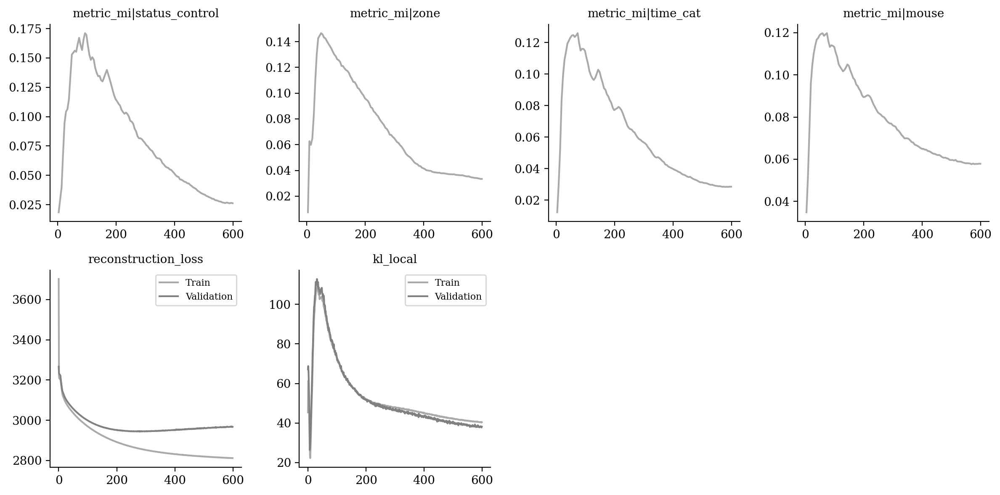

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

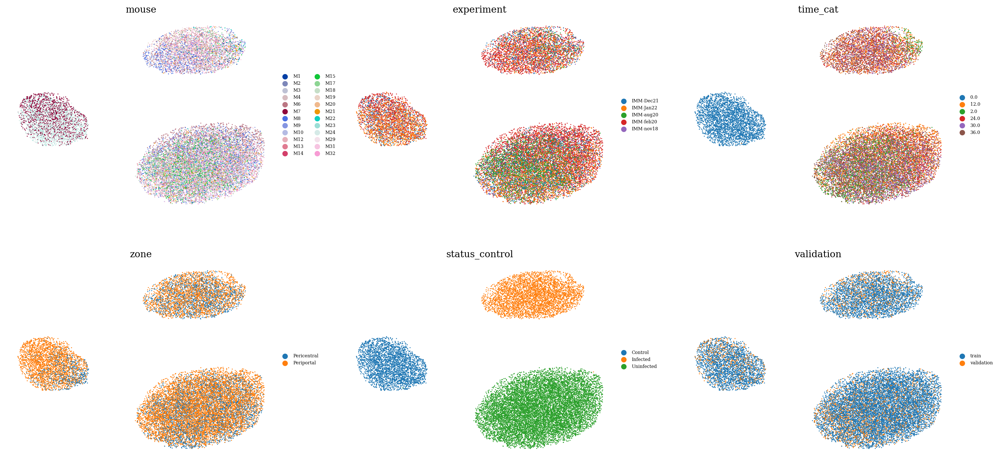

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

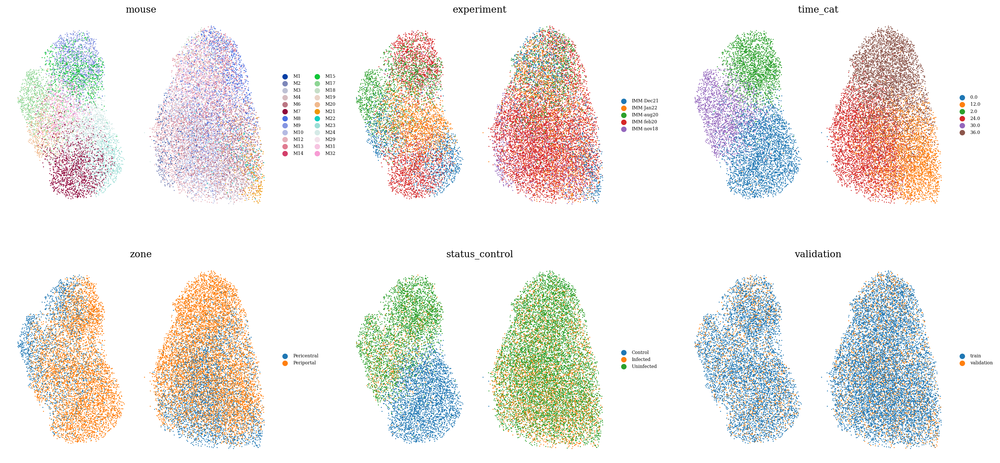

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

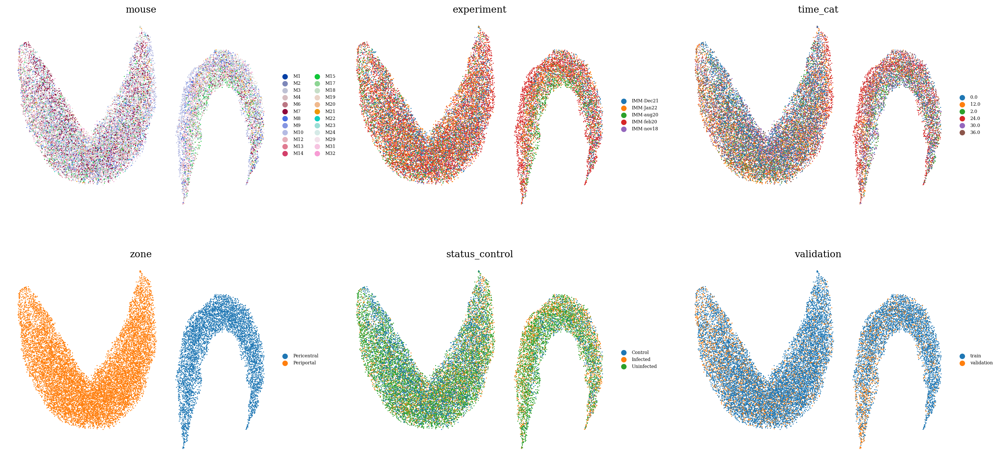

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

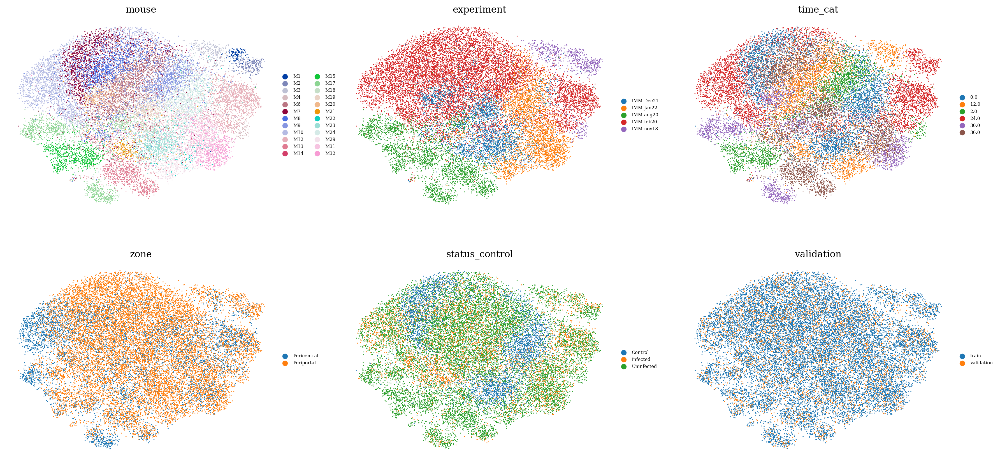

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

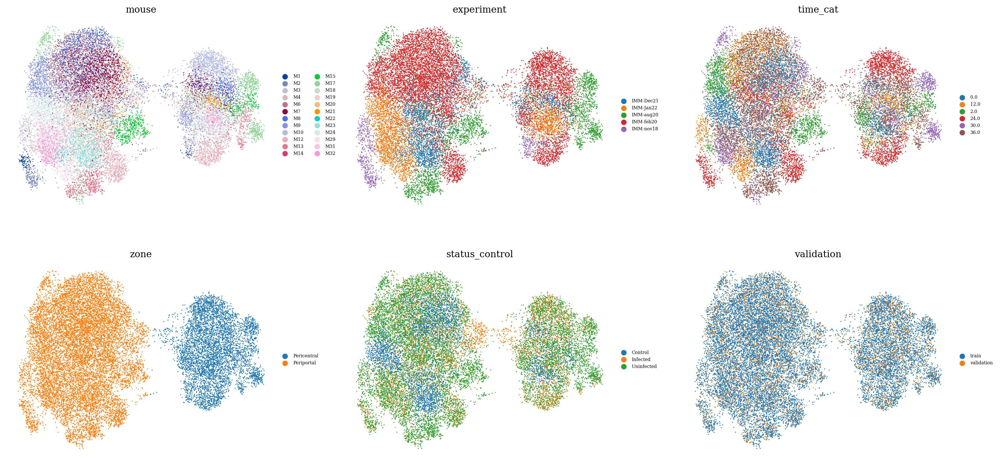

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

In [20]:
latent = latent[latent.obs["time_cat"] == "12.0"]

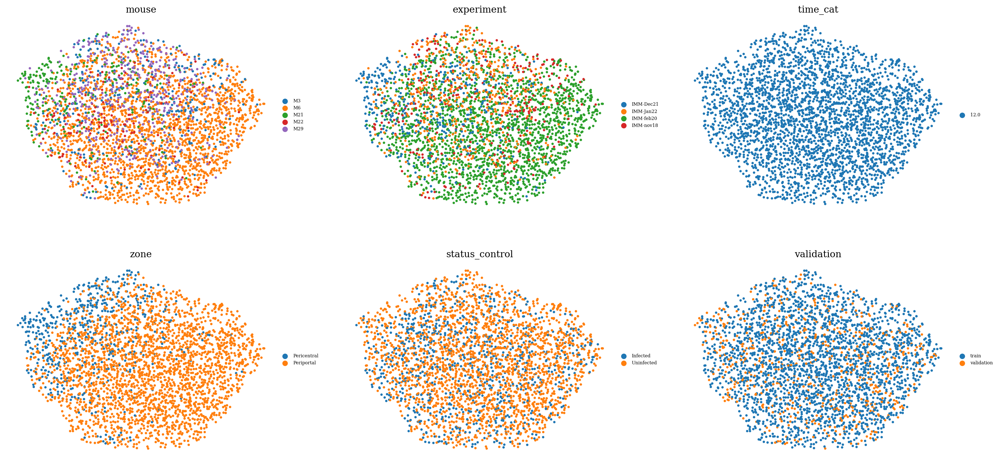

In [21]:
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )